<!DOCTYPE html>
<html lang="fr">
<head>
    <meta charset="UTF-8">
    <title>Analyse de Trajectoires de Tracking</title>
    <style>
        body {
            font-family: Arial, sans-serif;
        }
        h1 {
            color: skyblue;
            font-size: 24px;
        }
        p, li {
            font-size: 16px;
        }
        .green-text{
            color: DarkSeaGreen;
        }
    </style>
</head>
<body>
    <h1>Analyse de Trajectoires de Tracking</h1>
    <p>Ce code d'analyse permet de traiter les données issues du tracking pour extraire et étudier statistiquement les trajectoires pertinentes. Le processus est structuré comme suit :</p>
    <ol>
        <li><strong class="green-text">Récupération des trajectoires :</strong> Collecte de toutes les trajectoires issues des différentes manipulations.</li>
        <li><strong class="green-text">Pré-analyse :</strong> Examen initial des trajectoires pour déterminer celles à conserver pour l'analyse approfondie.</li>
        <li><strong class="green-text">Analyse statistique :</strong> Application de méthodes statistiques aux trajectoires conservées. Les données peuvent être séparées en deux populations pour un traitement spécifique si nécessaire.</li>
    </ol>
    <p>L'analyse se concentre sur les paramètres suivants :</p>
    <ul>
        <li>Angle entre les directions successives d'une particule entre chaque intervalle de temps.</li>
        <li>Vitesses moyennes et instantanées des particules.</li>
        <li>Variation de la vitesse en fonction du temps d'incubation.</li>
        <li>Effet potentiel de la densité de cellules sur la motilité.</li>
    </ul>
</body>
</html>


##
<center><span style="color: seagreen; font-size: 50px; font-style: bold">Chargement et préparation des données.</span></center>
<span style="color: skyblue; font-size: 20px; font-style: bold">Chargement des librairies.</span>

In [2]:
#!/usr/bin/env python3
# -*- coding: utf-8 -*-
"""
Created on Wed Mar  1 12:46:56 2023.

@author: souchaud
"""

import os
import time
import math
import pandas as pd
import numpy as np
import imageio.v2 as imageio
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from matplotlib import colormaps
from cycler import cycler
import trackpy as tp
import functions_analyze as lib
import warnings
import importlib
from colorama import init
from typing import List, Optional, Union, Any, Dict, Tuple
from scipy.stats import linregress
from scipy.optimize import curve_fit
import seaborn as sns


# Reload custom library
importlib.reload(lib)

# Initialize colorama
init(autoreset=True)

# Suppress specific warnings
with warnings.catch_warnings():
    warnings.simplefilter("ignore", category=FutureWarning)

# Set default matplotlib style
plt.style.use('default')

<span style="color: skyblue; font-size: 20px; font-style: bold">Paramètres de graphs.</span>

In [3]:
# plt.rcParams.update({
#     # Figure
#     "figure.figsize": (10, 6),  # Taille par défaut de la figure (largeur, hauteur en pouces)
#     "figure.dpi": 100,  # Résolution en points par pouce
#     "figure.facecolor": (0, 0, 0, 1),  # Fond de la figure : noir pur
#     "figure.edgecolor": "white",  # Bordure de la figure en blanc
#     "figure.titlesize": 20,  # Taille de la police pour le titre principal
#     "figure.titleweight": "bold",  # Style de la police pour le titre principal : gras

#     # Axes
#     "axes.facecolor": (0, 0, 0, 1),  # Fond des axes : noir pur
#     "axes.edgecolor": "white",  # Bordure des axes en blanc
#     "axes.linewidth": 2,  # Épaisseur des bordures des axes
#     "axes.titlesize": 16,  # Taille de la police des titres des axes
#     "axes.titleweight": "bold",  # Style de la police pour les titres des axes : gras
#     "axes.labelsize": 14,  # Taille de la police des étiquettes des axes
#     "axes.labelweight": "medium",  # Style de la police des étiquettes : intermédiaire
#     "axes.labelcolor": "white",  # Couleur des étiquettes des axes
#     "axes.prop_cycle": cycler(color=["#1f77b4", "#ff7f0e", "#2ca02c", "#d62728"]),  # Cycle des couleurs pour les lignes
#     "axes.grid": True,  # Activer la grille
#     "axes.grid.axis": "both",  # Grille pour les deux axes (x et y)
#     "axes.grid.which": "major",  # Grille pour les ticks principaux
#     "grid.color": "gray",  # Couleur des lignes de la grille
#     "grid.linewidth": 0.5,  # Épaisseur des lignes de la grille
#     "grid.alpha": 0.6,  # Transparence des lignes de la grille

#     # Ticks (Graduations)
#     "xtick.color": "white",  # Couleur des ticks sur l'axe x
#     "ytick.color": "white",  # Couleur des ticks sur l'axe y
#     "xtick.labelsize": 16,  # Taille de la police des ticks sur l'axe x
#     "ytick.labelsize": 16,  # Taille de la police des ticks sur l'axe y
#     "xtick.direction": "in",  # Ticks pointant vers l'intérieur sur l'axe x
#     "ytick.direction": "in",  # Ticks pointant vers l'intérieur sur l'axe y
#     "xtick.major.size": 8,  # Longueur des ticks principaux sur l'axe x
#     "ytick.major.size": 8,  # Longueur des ticks principaux sur l'axe y
#     "xtick.minor.size": 4,  # Longueur des ticks secondaires sur l'axe x
#     "ytick.minor.size": 4,  # Longueur des ticks secondaires sur l'axe y
#     "xtick.major.width": 1.5,  # Épaisseur des ticks principaux sur l'axe x
#     "ytick.major.width": 1.5,  # Épaisseur des ticks principaux sur l'axe y

#     # Lignes et marqueurs
#     # "lines.linewidth": 2,  # Épaisseur par défaut des lignes
#     # "lines.linestyle": "-",  # Style par défaut des lignes continues
#     # "lines.color": "#1f77b4",  # Couleur par défaut des lignes
#     # "lines.marker": "o",  # Marqueur par défaut : cercle
#     # "lines.markersize": 8,  # Taille par défaut des marqueurs
#     # "lines.markeredgewidth": 1.5,  # Épaisseur du bord des marqueurs
#     # "lines.markerfacecolor": "blue",  # Couleur du remplissage des marqueurs

#     # Polices
#     "font.size": 12,  # Taille globale de la police
#     "font.family": "sans-serif",  # Famille de polices par défaut
#     "font.sans-serif": ["Arial", "Helvetica", "DejaVu Sans"],  # Liste des polices sans-serif préférées
#     "text.color": "white",  # Couleur du texte

#     # Légendes
#     "legend.loc": "upper right",  # Emplacement par défaut de la légende
#     "legend.fontsize": 12,  # Taille de la police pour la légende
#     "legend.frameon": True,  # Activer le cadre autour de la légende
#     "legend.framealpha": 0.8,  # Transparence du cadre de la légende
#     "legend.edgecolor": "white",  # Couleur de la bordure de la légende
#     "legend.facecolor": (0.2, 0.2, 0.2, 0.9),  # Fond de la légende : gris foncé semi-transparent

#     # Sauvegarde des graphiques
#     "savefig.dpi": 300,  # Résolution par défaut pour les fichiers sauvegardés
#     "savefig.format": "png",  # Format par défaut pour les fichiers sauvegardés
#     "savefig.facecolor": (0, 0, 0, 1),  # Fond des figures sauvegardées : noir pur
#     "savefig.edgecolor": "none",  # Pas de bordure pour les figures sauvegardées
#     "savefig.transparent": True,  # Fond transparent pour les fichiers sauvegardés

#     # Couleurs et cycles
#     "image.cmap": "viridis",  # Palette par défaut pour les images
# })

plt.rcParams.update({
    # Figure
    "figure.figsize": (7, 5),  # Taille classique pour une figure d'article
    "figure.dpi": 300,
    "figure.facecolor": "white",
    "figure.edgecolor": "white",
    "figure.titlesize": 14,
    "figure.titleweight": "bold",

    # Axes
    "axes.facecolor": "white",
    "axes.edgecolor": "black",
    "axes.linewidth": 1,
    "axes.titlesize": 12,
    "axes.titleweight": "bold",
    "axes.labelsize": 11,
    "axes.labelweight": "normal",
    "axes.labelcolor": "black",
    "axes.prop_cycle": cycler(color=[
        "#1f77b4", "#ff7f0e", "#2ca02c", "#d62728", "#9467bd", "#8c564b"
    ]),
    "axes.grid": False,

    # Ticks
    "xtick.color": "black",
    "ytick.color": "black",
    "xtick.labelsize": 10,
    "ytick.labelsize": 10,
    "xtick.direction": "out",
    "ytick.direction": "out",
    "xtick.major.size": 5,
    "ytick.major.size": 5,
    "xtick.major.width": 1,
    "ytick.major.width": 1,

    # Lignes
    "lines.linewidth": 1.5,
    "lines.markersize": 6,

    # Police
    "font.size": 11,
    "font.family": "sans-serif",
    "font.sans-serif": ["Arial", "Helvetica", "DejaVu Sans"],
    "text.color": "black",

    # Légendes
    "legend.loc": "best",
    "legend.fontsize": 10,
    "legend.frameon": False,

    # Sauvegarde
    "savefig.dpi": 600,
    "savefig.format": "png",
    "savefig.facecolor": "white",
    "savefig.edgecolor": "white",
    "savefig.transparent": False,

    # Images
    "image.cmap": "viridis",
})

##
<span style="color: skyblue; font-size: 20px; font-style: bold">Initialisation des variables et constantes de travail..</span>

In [4]:
# Set initial time
INITIAL_TIME = time.time()

# Experiment parameters
TIME_FRAME = 15
SIZE_PIX = 0.637
FPS = 1 / TIME_FRAME

# File to study
file_name = 'filtered_final'
N_FRAME_MIN_STUDY = 200

# Study parameters
ROLLING_MEAN = False
PIXELISATION = False
TIME_FRAME_STUDY = False
DRIFT = False

# Plot parameters
IMG_TYPE = 'png'
ALPHA = 0.5
LINEWIDTH = 0.1
COLOR_SUP = 'blue'
COLOR_INF = 'red'
color_sup_inf = (COLOR_SUP, COLOR_INF)

##
<span style="color: skyblue; font-size: 20px; font-style: bold">Définition des path et dossiers de travails / enregistrements.</span>

<span style="color: skyblue; font-size: 20px; font-style: bold">Conditions des manips étudiées.</span>

<span style="color: skyblue; font-size: 20px; font-style: bold">Défintions et créations des différents dossiers d'enregistrements.</span>

In [5]:
# General paths
GENERAL_PATH = '/Users/souchaud/Desktop/Analyses/'
GENERAL_PATH_PICTURES = '/Users/souchaud/Desktop/A_analyser/'

# Condition
CONDITION_simple = 'CytoOne_HL5_10x'
CONDITION = f'{CONDITION_simple}_results_tracking'

# Get list of experiments
PATHWAY_EXPERIMENT = [f for f in os.listdir(GENERAL_PATH + CONDITION)
                      if os.path.isdir(os.path.join(GENERAL_PATH + CONDITION, f))]

# Update experiment paths
PATHWAY_EXPERIMENT = [os.path.join(GENERAL_PATH, CONDITION, elem, 'mosaic')
                      for elem in PATHWAY_EXPERIMENT]

# Path to save pictures
path_save_pic = os.path.join(GENERAL_PATH, f'résultats_{CONDITION}_All')

# Create directory if it doesn't exist
os.makedirs(path_save_pic, exist_ok=True)
os.chdir(path_save_pic)


<span style="color: skyblue; font-size: 20px; font-style: bold">Ajout des temps d'incubation.</span>

In [6]:
# Add incubation times to DATA
conditions_to_values = {
    'ASMOT127': 4.25, 'ASMOT128': 23.58, 'ASMOT130': 29.58, 'ASMOT132': 4.33, 'ASMOT133': 23.12,
    'ASMOT134': 26.12, 'ASMOT135': 29, 'ASMOT136': 31.12, 'ASMOT137': 47.3, 'ASMOT138': 49.75,
    'ASMOT139': 52.25, 'ASMOT140': 0, 'ASMOT141': 4.08, 'ASMOT142': 16.25, 'ASMOT143': 18.67,
    'ASMOT144': 21.08, 'ASMOT145': 23.83, 'ASMOT146': 42.17, 'ASMOT147': 51.17, 'ASMOT148': 47.17,
    'ASMOT149': 70.92, 'ASMOT150': 66.67, 'ASMOT151': 71.17, 'ASMOT152': 76.33, 'ASMOT153': 78.33,
    'ASMOT154': 94.75, 'ASMOT155': 98.42, 'ASMOT156': 100.25, 'ASMOT157': 46.25, 'ASMOT158': 48.08,
    'ASMOT159': 69.58, 'ASMOT160': 20.25, 'ASMOT161': 22.42, 'ASMOT162': 92.33, 'ASMOT163': 0.0,
    'ASMOT164': 5.25, 'ASMOT165': 23.08, 'ASMOT166': 20.08, 'ASMOT167': 21.08, 'ASMOT168': 21.08,
    'ASMOT169': 21.08, 'ASMOT170': 4.58, 'ASMOT171': 7.00, 'ASMOT172': 24.00, 'ASMOT173': 25.58,
    'ASMOT174': 30.58, 'ASMOT175': 47.58, 'ASMOT176': 71.83, 'ASMOT177': 76.67, 'ASMOT178': 77.67,
    'ASMOT179': 95.08, 'ASMOT180': 97.58, 'ASMOT181': 21.08,
}

experiment_to_dell= {
    'ASMOT163',
    'ASMOT161',
    'ASMOT164',
}


##
<center><span style="color: Crimson; font-size: 30px; font-style: bold">Lecture des données expériementales.</span></center>

<span style="color: skyblue; font-size: 20px">On décide de travailler que sur un certain nombre de frame. Ici je décide de travailler sur les 340 première frames pour normaliser les expériences. 
Donc la cellules doit être suivi sur N_MIN_STUDY sur les 340 premières frames. </span>

<span style="color: skyblue; font-size: 20px">Application de fonctions pour moyenne flissante et pixelisation et étude d'une frame sur x </span>

In [7]:
# Read HDF5 data
importlib.reload(lib)
DATA = lib.read_hdf5_all(
    pathway_experiment=PATHWAY_EXPERIMENT,
    name_file=file_name,
    nbr_frame_min=N_FRAME_MIN_STUDY,
    condition=CONDITION,
    drift=DRIFT,
    search_range=20,
    memory=5
)
# Vérifier si le dictionnaire `experiment_to_dell` n'est pas vide
if experiment_to_dell:
    print(f"Suppression des expériences : {experiment_to_dell}")
    
    # Supprimer les expériences spécifiées
    DATA = DATA[~DATA['experiment'].isin(experiment_to_dell)]
    DATA.reset_index(drop=True, inplace=True)
    print(f"Nombre d'expériences restantes après suppression des expériences ratées: {DATA['experiment'].nunique()}")
else:
    print("Aucune expérience à supprimer, `experiment_to_dell` est vide.")

# Sort DATA by 'frame'
DATA.sort_values(by='frame', inplace=True)
DATA_copy = DATA.copy()
DATA

['/Users/souchaud/Desktop/Analyses/CytoOne_HL5_10x_results_tracking/2024_05_02_ASMOT158_AX3_2024_P4_10x_CytoOne_HL5_2904-12h45_0205_13h30/mosaic/filtered_final.hdf5']
ASMOT158  :  779
['/Users/souchaud/Desktop/Analyses/CytoOne_HL5_10x_results_tracking/2024_03_06_ASMOT134_AX3_MAT_P3_10x_CytoOne_HL5_0403-15h-0603-12h07/mosaic/filtered_final.hdf5']
ASMOT134  :  45
['/Users/souchaud/Desktop/Analyses/CytoOne_HL5_10x_results_tracking/2024_02_21_ASMOT128_AX3_MAT_P5_10x_CytoOne_HL5_1902-11h-2102-9h10_1/mosaic/filtered_final.hdf5']
ASMOT128  :  113
['/Users/souchaud/Desktop/Analyses/CytoOne_HL5_10x_results_tracking/2024_03_26_ASMOT144_AX3_2024_P1_10x_CytoOne_HL5_2603-17h00-2703-14h25/mosaic/filtered_final.hdf5']
ASMOT144  :  94
['/Users/souchaud/Desktop/Analyses/CytoOne_HL5_10x_results_tracking/2024_03_06_ASMOT135_AX3_MAT_P3_10x_CytoOne_HL5_0403-15h-0603-15h07/mosaic/filtered_final.hdf5']
ASMOT135  :  70
['/Users/souchaud/Desktop/Analyses/CytoOne_HL5_10x_results_tracking/2024_05_28_ASMOT179_AX3

,y,x,mass,size,ecc,signal,raw_mass,ep,frame,old_particle,count_x,experiment,condition,count_y,particle,position
0,5462.198187,8906.947456,1551.418254,4.049869,0.376548,25.559533,28647.0,0.076730,0,3,210,ASMOT158,CytoOne_HL5_10x_results_tracking,210,0,filtered_final
1551533,8135.866375,6113.177526,1379.955809,3.881345,0.234139,23.436549,22045.0,0.121357,0,114,332,ASMOT171,CytoOne_HL5_10x_results_tracking,332,5283,filtered_final
1551201,7847.019806,4594.368026,1138.662532,3.951289,0.316412,18.867159,24567.0,0.079751,0,110,332,ASMOT171,CytoOne_HL5_10x_results_tracking,332,5282,filtered_final
1550861,7552.731017,776.131957,1599.581333,4.100235,0.384380,24.468347,27859.0,0.055095,0,108,340,ASMOT171,CytoOne_HL5_10x_results_tracking,340,5281,filtered_final
1550521,7305.389985,6642.541687,597.558305,3.483381,0.234707,13.708170,19334.0,0.276315,0,106,340,ASMOT171,CytoOne_HL5_10x_results_tracking,340,5280,filtered_final
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1098566,4749.885802,3512.144772,1317.908357,4.017465,0.302459,21.526634,25142.0,0.052432,339,127,340,ASMOT142,CytoOne_HL5_10x_results_tracking,340,3768,filtered_final
841927,2274.859444,4543.958333,278.667680,4.010403,0.280965,4.334831,18673.0,1.487347,339,113,340,ASMOT138,CytoOne_HL5_10x_results_tracking,340,2927,filtered_final
420720,5286.621239,4761.744627,1218.395833,3.801922,0.258986,23.412916,27377.0,0.077467,339,69,337,ASMOT183,CytoOne_HL5_10x_results_tracking,337,1441,filtered_final
1587705,5966.388936,5513.236462,1524.207681,4.045295,0.415638,25.894376,25091.0,0.074791,339,4347,248,ASMOT171,CytoOne_HL5_10x_results_tracking,248,5403,filtered_final


In [8]:
SIZE_PIX = 0.637      # µm/pixel
TIME_FRAME = 15       # secondes par frame
SPEED_THRESHOLD_UM_PER_MIN = 20
SPEED_THRESHOLD_UM_PER_S = SPEED_THRESHOLD_UM_PER_MIN / 60  # ≈ 0.333 µm/s

def compute_speed_filter(df, SPEED_THRESHOLD_UM_PER_S):
    df = df.sort_values(['particle', 'frame']).copy()
    dx = df.groupby('particle')['x'].diff()
    dy = df.groupby('particle')['y'].diff()
    dt = df.groupby('particle')['frame'].diff() * TIME_FRAME
    dist_um = np.sqrt((dx * SIZE_PIX) ** 2 + (dy * SIZE_PIX) ** 2)
    speed_um_s = dist_um / dt
    speed_um_s = speed_um_s.fillna(0)
    df['speed_um_s'] = speed_um_s
    df['is_suspect'] = df['speed_um_s'] > SPEED_THRESHOLD_UM_PER_S
    df_clean = df[~df['is_suspect']].copy()
    df_suspect = df[df['is_suspect']].copy()
    return df_clean, df, df_suspect

def speed_filter_iterative_with_removed(df, speed_thresh_um_s, max_iter=10):
    removed_points = []
    for i in range(max_iter):
        df_clean, df_with_speed, df_suspect = compute_speed_filter(df, speed_thresh_um_s)
        n_removed = len(df) - len(df_clean)
        print(f"Iteration {i+1}: removed {n_removed} points")
        if n_removed == 0:
            break
        removed_points.append(df_suspect)
        df = df_clean
    if removed_points:
        removed_points = pd.concat(removed_points, ignore_index=True)
    else:
        removed_points = pd.DataFrame(columns=df.columns)
    return df, removed_points

print(f"Longueur de DATA avant tri sur la vitesse : {len(DATA)}")
print(f"avec {DATA['particle'].nunique()} particules")

# Utilisation :
DATA, REMOVED = speed_filter_iterative_with_removed(DATA, SPEED_THRESHOLD_UM_PER_S)

print(f"Longueur de DATA après tri sur la vitesse : {len(DATA)}")
print(f"avec {DATA['particle'].nunique()} particules")

# Points supprimés pour la manip ASMOT182
removed_ASMOT150 = REMOVED[REMOVED['experiment'] == 'ASMOT150']

print(f"Nombre de points supprimés pour ASMOT150 : {len(removed_ASMOT150)}")
# Si tu veux les sauvegarder :
# removed_ASMOT182.to_csv("removed_ASMOT182.csv", index=False)

Longueur de DATA avant tri sur la vitesse : 2129327
avec 7180 particules
Iteration 1: removed 227412 points
Iteration 2: removed 42455 points
Iteration 3: removed 373 points
Iteration 4: removed 23 points
Iteration 5: removed 8 points
Iteration 6: removed 2 points
Iteration 7: removed 2 points
Iteration 8: removed 1 points
Iteration 9: removed 1 points
Iteration 10: removed 1 points
Longueur de DATA après tri sur la vitesse : 1859049
avec 7180 particules
Nombre de points supprimés pour ASMOT150 : 1942


In [9]:
def split_trajectories(df, gap_thresh=1):
    df = df.sort_values(['particle', 'frame']).copy()
    # Prépare une colonne pour les nouveaux IDs
    new_particles = []
    new_id = 0

    for pid, group in df.groupby('particle'):
        frames = group['frame'].to_numpy()
        # Calcule les gaps entre frames
        diffs = np.diff(frames, prepend=frames[0])
        current_id = new_id
        for i, gap in enumerate(diffs):
            if i == 0 or gap > gap_thresh:
                current_id = new_id
                new_id += 1
            new_particles.append(current_id)
    df['particle'] = new_particles
    return df

# 1. Découpe les trajectoires à chaque trou (trackpy attribue un nouvel ID à chaque fragment consécutif)
DATA = split_trajectories(DATA, gap_thresh=1)

# 2. (optionnel mais très conseillé) : Ne garde que les fragments d'au moins X frames
traj_lengths = DATA.groupby('particle')['frame'].count()
min_frames = 5  # par exemple
particles_to_keep = traj_lengths[traj_lengths >= min_frames].index
DATA = DATA[DATA['particle'].isin(particles_to_keep)].copy()

# 3. Tu peux ensuite recalculer ton MSD proprement sur ce DATA nettoyé et resélectionné

In [10]:
REMOVED[REMOVED['experiment']=='ASMOT150']


,y,x,mass,size,ecc,signal,raw_mass,ep,frame,old_particle,count_x,experiment,condition,count_y,particle,position,speed_um_s,is_suspect
35315,5284.990071,1778.941135,851.065262,3.546100,0.192653,17.655077,26221.0,0.052697,3,7,318,ASMOT150,CytoOne_HL5_10x_results_tracking,318,1288,filtered_final,0.669186,True
35316,5301.687081,1784.619617,933.156314,4.024784,0.367401,15.478191,25542.0,0.057433,4,7,318,ASMOT150,CytoOne_HL5_10x_results_tracking,318,1288,filtered_final,0.748950,True
35317,5305.920168,1780.970298,885.938512,4.108285,0.442334,14.889723,24585.0,0.065407,12,7,318,ASMOT150,CytoOne_HL5_10x_results_tracking,318,1288,filtered_final,0.615379,True
35318,5305.807989,1768.785389,701.491092,3.851824,0.302715,13.518574,25689.0,0.056419,15,7,318,ASMOT150,CytoOne_HL5_10x_results_tracking,318,1288,filtered_final,0.557729,True
35319,5316.392569,1753.557149,694.273125,3.749286,0.331428,15.141659,24610.0,0.065313,39,7,318,ASMOT150,CytoOne_HL5_10x_results_tracking,318,1288,filtered_final,0.359127,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
269975,6737.917674,1760.971462,1550.185407,4.284937,0.289861,20.259358,32394.0,0.031015,262,4459,236,ASMOT150,CytoOne_HL5_10x_results_tracking,236,1420,filtered_final,0.425154,True
270245,2816.037958,3304.227303,1227.994712,3.719523,0.249074,23.578589,26409.0,0.052434,255,463,337,ASMOT150,CytoOne_HL5_10x_results_tracking,337,1376,filtered_final,0.370636,True
270246,1888.038005,1901.909515,1450.692539,4.142729,0.222845,20.861579,27353.0,0.047298,269,3235,224,ASMOT150,CytoOne_HL5_10x_results_tracking,224,1407,filtered_final,0.402814,True
270247,6737.928916,1760.925504,1565.540099,4.308935,0.292847,20.067686,32476.0,0.030586,263,4459,236,ASMOT150,CytoOne_HL5_10x_results_tracking,236,1420,filtered_final,0.354067,True


In [11]:
import numpy as np

# On sélectionne les données pour ASMOT150
df = REMOVED[REMOVED['experiment'] == 'ASMOT150'].copy()

# Trie par particule et frame
df = df.sort_values(['particle', 'frame'])

# Calcule le déplacement entre deux frames successives pour chaque particule
df['dx'] = df.groupby('particle')['x'].diff()
df['dy'] = df.groupby('particle')['y'].diff()
df['distance_pix'] = np.sqrt(df['dx']**2 + df['dy']**2)

# Si tu veux en microns :
SIZE_PIX = 0.637  # µm/pixel
df['distance_um'] = df['distance_pix'] * SIZE_PIX

# Affiche le résultat
print(df[['particle', 'frame', 'dx', 'dy', 'distance_pix', 'distance_um']].head())

       particle  frame         dx         dy  distance_pix  distance_um
35315      1288      3        NaN        NaN           NaN          NaN
35316      1288      4   5.678482  16.697010     17.636193    11.234255
35317      1288     12  -3.649319   4.233087      5.588967     3.560172
35318      1288     15 -12.184910  -0.112179     12.185426     7.762116
35319      1288     39 -15.228240  10.584580     18.545421    11.813433


In [12]:
ASMOT150 = DATA_copy[DATA_copy['experiment'] == 'ASMOT150']
ASMOT150[ASMOT150['particle'] == 1288].head(20)

,y,x,mass,size,ecc,signal,raw_mass,ep,frame,old_particle,count_x,experiment,condition,count_y,particle,position
374586,5296.844983,1790.592328,907.516199,4.027603,0.379863,15.247538,25079.0,0.061457,0,7,318,ASMOT150,CytoOne_HL5_10x_results_tracking,318,1288,filtered_final
374587,5296.949951,1788.617428,931.054727,3.900716,0.336264,16.739079,25438.0,0.058253,1,7,318,ASMOT150,CytoOne_HL5_10x_results_tracking,318,1288,filtered_final
374588,5298.669926,1786.762475,926.500528,3.973551,0.370511,16.399622,25450.0,0.057958,2,7,318,ASMOT150,CytoOne_HL5_10x_results_tracking,318,1288,filtered_final
374589,5284.990071,1778.941135,851.065262,3.546100,0.192653,17.655077,26221.0,0.052697,3,7,318,ASMOT150,CytoOne_HL5_10x_results_tracking,318,1288,filtered_final
374590,5301.687081,1784.619617,933.156314,4.024784,0.367401,15.478191,25542.0,0.057433,4,7,318,ASMOT150,CytoOne_HL5_10x_results_tracking,318,1288,filtered_final
374591,5302.781300,1784.034438,906.676066,3.963931,0.370483,15.612221,25334.0,0.059025,5,7,318,ASMOT150,CytoOne_HL5_10x_results_tracking,318,1288,filtered_final
374592,5301.253371,1784.567953,913.175002,4.020558,0.371957,15.849310,25502.0,0.057646,6,7,318,ASMOT150,CytoOne_HL5_10x_results_tracking,318,1288,filtered_final
374593,5299.948913,1784.680901,868.937190,4.002522,0.400545,15.651664,24680.0,0.064683,7,7,318,ASMOT150,CytoOne_HL5_10x_results_tracking,318,1288,filtered_final
374594,5292.529817,1772.349290,624.161624,3.335895,0.160436,15.319180,24824.0,0.063209,10,7,318,ASMOT150,CytoOne_HL5_10x_results_tracking,318,1288,filtered_final
374595,5295.161047,1771.263271,690.086886,3.726577,0.302976,14.851224,25060.0,0.061169,11,7,318,ASMOT150,CytoOne_HL5_10x_results_tracking,318,1288,filtered_final


In [13]:
# On s'assure que chaque fragment a un ID unique et consécutif
DATA = DATA.reset_index(drop=True)
DATA['particle'] = DATA.groupby('particle').ngroup()

In [14]:
# import os
# import glob
# import cv2

# base_image_dir = "/Users/souchaud/Desktop/A_analyser/CytoOne_HL5_10x_faits/"
# output_dir = "/Users/souchaud/Desktop/suppr/"
# os.makedirs(output_dir, exist_ok=True)

# # On ne prend que DATA pour ASMOT150
# df_full = DATA[DATA['experiment'] == 'ASMOT150'].copy()
# # Les points à annoter (sauts suspects)
# df_suspect = removed_ASMOT150.copy()

# # Localise le dossier de l’expérience
# experiment = 'ASMOT150'
# experiment_dirs = glob.glob(os.path.join(base_image_dir, f"*{experiment}*"))
# if not experiment_dirs:
#     print(f"Dossier pour {experiment} non trouvé !")
#     exit()
# experiment_dir = experiment_dirs[0]

# # Liste toutes les images frame par frame (en ordre)
# img_list = sorted(
#     glob.glob(os.path.join(experiment_dir, "mosaic/mosaic_total_*.tif")),
#     key=lambda x: int(os.path.splitext(os.path.basename(x))[0].split('_')[-1])
# )

# for img_path in img_list:
#     # Extraire le numéro de frame
#     basename = os.path.basename(img_path)
#     try:
#         frame = int(basename.split('_')[-1].replace('.tif', ''))
#     except ValueError:
#         print(f"Nom d'image inattendu : {basename}")
#         continue

#     img = cv2.imread(img_path)
#     if img is None:
#         print(f"Image {img_path} illisible !")
#         continue

#     # Points suspects pour cette frame (saut arrivé à CETTE frame)
#     sub_df_sus = df_suspect[df_suspect['frame'] == frame]

#     for _, row in sub_df_sus.iterrows():
#         particle = row['particle']
#         x_suspect = int(round(row['x']))
#         y_suspect = int(round(row['y']))

#         # Retrouver le point précédent
#         row_prev = df_full[
#             (df_full['particle'] == particle) &
#             (df_full['frame'] == frame - 1)
#         ]
#         if not row_prev.empty:
#             x_prev = int(round(row_prev.iloc[0]['x']))
#             y_prev = int(round(row_prev.iloc[0]['y']))
#             # Tracer la position précédente en bleu
#             cv2.circle(img, (x_prev, y_prev), 50, (255, 0, 0), 3)
#             # Relier la position précédente au saut en jaune
#             cv2.line(img, (x_prev, y_prev), (x_suspect, y_suspect), (0, 255, 255), 2)
#         # Tracer la position suspecte en rouge
#         cv2.circle(img, (x_suspect, y_suspect), 50, (0, 0, 255), 3)

#     # Sauvegarde, même si rien n'est tracé (l'image est juste copiée)
#     out_path = os.path.join(
#         output_dir, f"{experiment}_mosaic_total_{frame:04d}_jump.png"
#     )
#     cv2.imwrite(out_path, img)

In [15]:
removed_ASMOT150

,y,x,mass,size,ecc,signal,raw_mass,ep,frame,old_particle,count_x,experiment,condition,count_y,particle,position,speed_um_s,is_suspect
35315,5284.990071,1778.941135,851.065262,3.546100,0.192653,17.655077,26221.0,0.052697,3,7,318,ASMOT150,CytoOne_HL5_10x_results_tracking,318,1288,filtered_final,0.669186,True
35316,5301.687081,1784.619617,933.156314,4.024784,0.367401,15.478191,25542.0,0.057433,4,7,318,ASMOT150,CytoOne_HL5_10x_results_tracking,318,1288,filtered_final,0.748950,True
35317,5305.920168,1780.970298,885.938512,4.108285,0.442334,14.889723,24585.0,0.065407,12,7,318,ASMOT150,CytoOne_HL5_10x_results_tracking,318,1288,filtered_final,0.615379,True
35318,5305.807989,1768.785389,701.491092,3.851824,0.302715,13.518574,25689.0,0.056419,15,7,318,ASMOT150,CytoOne_HL5_10x_results_tracking,318,1288,filtered_final,0.557729,True
35319,5316.392569,1753.557149,694.273125,3.749286,0.331428,15.141659,24610.0,0.065313,39,7,318,ASMOT150,CytoOne_HL5_10x_results_tracking,318,1288,filtered_final,0.359127,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
269975,6737.917674,1760.971462,1550.185407,4.284937,0.289861,20.259358,32394.0,0.031015,262,4459,236,ASMOT150,CytoOne_HL5_10x_results_tracking,236,1420,filtered_final,0.425154,True
270245,2816.037958,3304.227303,1227.994712,3.719523,0.249074,23.578589,26409.0,0.052434,255,463,337,ASMOT150,CytoOne_HL5_10x_results_tracking,337,1376,filtered_final,0.370636,True
270246,1888.038005,1901.909515,1450.692539,4.142729,0.222845,20.861579,27353.0,0.047298,269,3235,224,ASMOT150,CytoOne_HL5_10x_results_tracking,224,1407,filtered_final,0.402814,True
270247,6737.928916,1760.925504,1565.540099,4.308935,0.292847,20.067686,32476.0,0.030586,263,4459,236,ASMOT150,CytoOne_HL5_10x_results_tracking,236,1420,filtered_final,0.354067,True


In [16]:
# 1. Nombre de particules avant
n_particles_before = DATA['particle'].nunique()

# 2. Liste des particules à conserver
particles_to_keep_gap = []

for pid, group in DATA.groupby('particle'):
    frames = group['frame'].sort_values().to_numpy()
    gaps = np.diff(frames)
    if np.all(gaps <= 5):
        particles_to_keep_gap.append(pid)

# 3. Filtrer DATA pour ne garder que les particules sans trou > 5 frames
DATA = DATA[DATA['particle'].isin(particles_to_keep_gap)].copy()

# 4. Nombre de particules après
n_particles_after = DATA['particle'].nunique()

print(f"Nombre de particules avant le filtrage des gaps : {n_particles_before}")
print(f"Nombre de particules après le filtrage des gaps : {n_particles_after}")

Nombre de particules avant le filtrage des gaps : 86941
Nombre de particules après le filtrage des gaps : 86941


In [17]:
# Filter DATA
print("Nombre de particules avant tri sur la nombre de frame sur laquelle la particule est suivie: ", DATA['particle'].nunique())
DATA = DATA[DATA['frame'] < 340]

# 1. Calcul du nombre de frames par particle
traj_lengths = DATA.groupby('particle')['frame'].count()

# 2. Garder uniquement les particles avec >= 250 frames
particles_to_keep = traj_lengths[traj_lengths >= N_FRAME_MIN_STUDY].index

# 3. Filtrer le DataFrame
DATA = DATA[DATA['particle'].isin(particles_to_keep)].copy()

print(f"Nombre de trajectories gardées : {len(particles_to_keep)}")


# Keep particles with sufficient frames
DATA = DATA.groupby('particle').filter(lambda x: len(x) >= N_FRAME_MIN_STUDY)
print("Nombre de particules après tri: ", DATA['particle'].nunique())

# Apply optional data transformations
if ROLLING_MEAN:
    DATA = lib.rolling_mean(datas=DATA, roll=3)
if PIXELISATION:
    DATA = lib.pixelisation(datas=DATA, size_pix=SIZE_PIX)
if TIME_FRAME_STUDY:
    DATA, TIME_FRAME = lib.keep_nth_image(traj=DATA, n=N_FRAME_MIN_STUDY, time_frame=TIME_FRAME)

# Calculate instant velocities
DATA['time (min)'] = DATA['frame'] * TIME_FRAME / 60
DATA = lib.vit_instant_new(traj=DATA, lag_time=TIME_FRAME, pix_size=SIZE_PIX, triage=1)

DATA['time to incubation (hours)'] = DATA['experiment'].map(conditions_to_values).fillna(0.0)
DATA['particle'].nunique()



Nombre de particules avant tri sur la nombre de frame sur laquelle la particule est suivie:  86941
Nombre de trajectories gardées : 1070
Nombre de particules après tri:  1070


1070

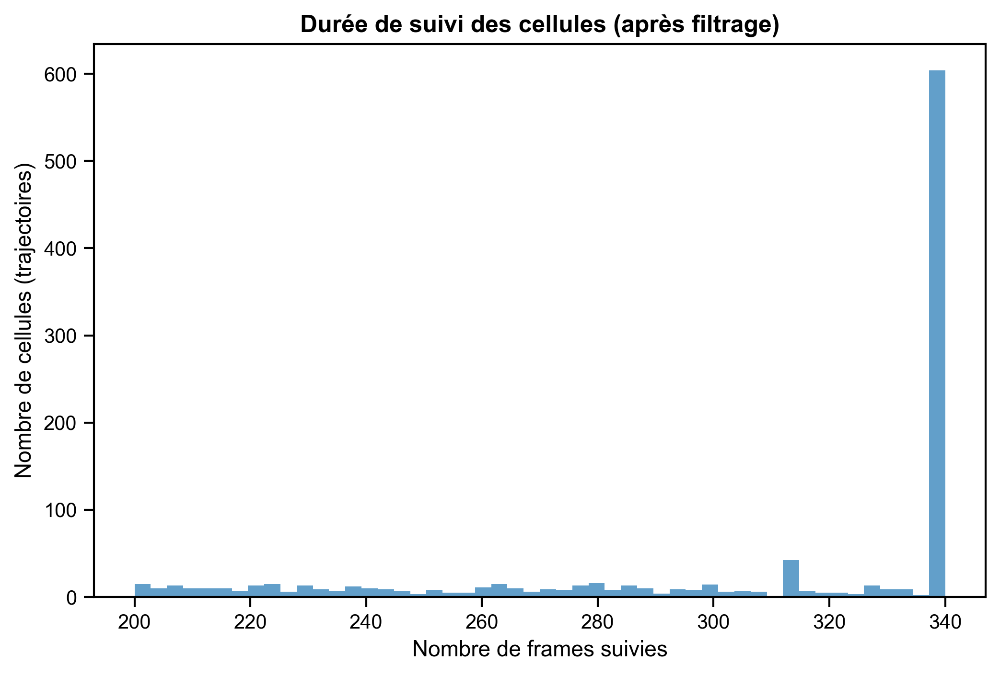

Statistiques des durées de suivi (en frames) :
count    1070.000000
mean      307.745794
std        45.140181
min       200.000000
25%       278.000000
50%       340.000000
75%       340.000000
max       340.000000
Name: frame, dtype: float64


In [18]:
# Supposons que DATA soit ton DataFrame filtré
# On compte le nombre de frames pour chaque particule
traj_lengths = DATA.groupby('particle')['frame'].count()

# Histogramme
plt.figure(figsize=(8, 5))
plt.hist(traj_lengths, bins=50, alpha=0.7)
plt.xlabel('Nombre de frames suivies')
plt.ylabel('Nombre de cellules (trajectoires)')
plt.title('Durée de suivi des cellules (après filtrage)')
plt.show()

# Optionnel : statistiques
print("Statistiques des durées de suivi (en frames) :")
print(traj_lengths.describe())

Mean speed: 2.97 µm/min, Median speed: 2.09 µm/min


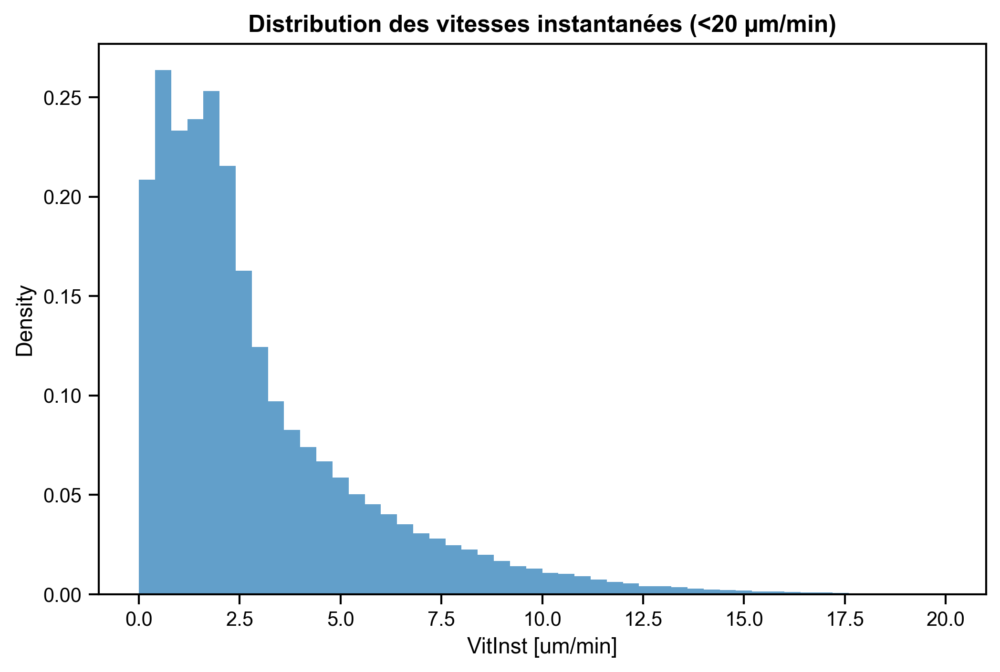

In [19]:
# On filtre juste la colonne 'VitInst [um/min]' :
# (Mettre à NaN les vitesses > 20)
DATA['VitInst [um/min]'] = DATA['VitInst [um/min]'].where(
    (DATA['VitInst [um/min]'] < 20) | (DATA['VitInst [um/min]'].isna()), np.nan
)

# Exemples de stats, NaN seront automatiquement ignorés
mean_speed = DATA['VitInst [um/min]'].mean()
median_speed = DATA['VitInst [um/min]'].median()
print(f"Mean speed: {mean_speed:.2f} µm/min, Median speed: {median_speed:.2f} µm/min")

plt.figure(figsize=(8,5))
plt.hist(DATA['VitInst [um/min]'].dropna(), bins=50, alpha=0.7, density=True)
plt.title("Distribution des vitesses instantanées (<20 µm/min)")
plt.xlabel("VitInst [um/min]")
plt.ylabel("Density")
plt.show()

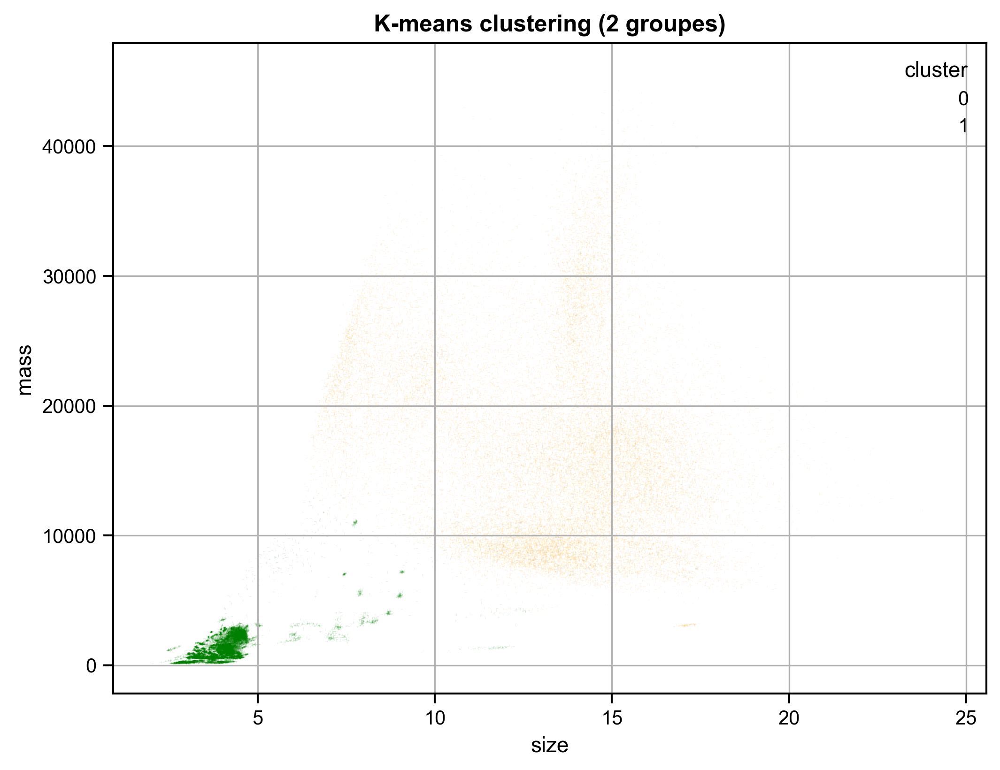

In [20]:
import os
import glob
import cv2
import numpy as np
import pandas as pd
from sklearn.neighbors import NearestNeighbors
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans

X = DATA[['mass', 'size', 'ecc']].dropna()
X_scaled = StandardScaler().fit_transform(X)
kmeans = KMeans(n_clusters=2, random_state=0).fit(X_scaled)
DATA['cluster'] = -1
DATA.loc[X.index, 'cluster'] = kmeans.labels_

plt.figure(figsize=(8, 6))
sns.scatterplot(
    data=DATA, x='size', y='mass',
    hue='cluster', palette=['green', 'orange'],
    alpha=0.1, s=0.001, marker='+', linewidth=1.0
)
plt.title("K-means clustering (2 groupes)")
plt.grid()
plt.show()


In [21]:
DATA[DATA['cluster'] == 1]['particle'].nunique()
DATA[DATA['cluster'] == 0]['particle'].nunique()
# DATA = DATA[DATA['cluster'] == 1].copy()

659

In [22]:
from sklearn.neighbors import NearestNeighbors

min_distance = 10
filtered_particles = []

print(f"Nombre de particules avant le filtrage spatial : {DATA['particle'].nunique()}")
# Parcours chaque expérience indépendamment
for experiment in DATA['experiment'].unique():
    df_exp = DATA[DATA['experiment'] == experiment]
    # 1. Trouver la première frame de chaque particule dans cette expérience
    first_frame_df = df_exp.sort_values('frame').groupby('particle', as_index=False).first()
    first_frame_df['start_frame'] = first_frame_df['frame']

    # 2. Pour chaque frame de début, filtrer spatialement
    for f in first_frame_df['start_frame'].unique():
        same_frame = first_frame_df[first_frame_df['start_frame'] == f].copy()
        
        if len(same_frame) <= 1:
            filtered_particles.append(same_frame)
            continue

        coords = same_frame[['x', 'y']].to_numpy()
        nbrs = NearestNeighbors(n_neighbors=2).fit(coords)
        distances, _ = nbrs.kneighbors(coords)
        keep_mask = distances[:, 1] > min_distance
        filtered_particles.append(same_frame[keep_mask])

# 3. Particules conservées (de toutes les expériences)
final_df = pd.concat(filtered_particles, ignore_index=True)
particles_to_keep = set(final_df['particle'])

# 4. Filtrer DATA pour ne garder que les particules conservées
DATA = DATA[DATA['particle'].isin(particles_to_keep)].copy()
print(f"Nombre de particules après le filtrage spatial : {DATA['particle'].nunique()}")

Nombre de particules avant le filtrage spatial : 1070


Nombre de particules après le filtrage spatial : 1070


In [23]:
# # === PARAMÈTRES ===
# base_image_dir = "/Users/souchaud/Desktop/A_analyser/CytoOne_HL5_10x_faits/"
# output_dir = "/Users/souchaud/Desktop/faibles/"
# min_distance = 10  # en pixels
# os.makedirs(output_dir, exist_ok=True)

# # === 1. Génération des images par expérience ===
# for experiment in DATA['experiment'].unique():
#     sub_df = DATA[DATA['experiment'] == experiment].copy()

#     # Localise le dossier de l’expérience
#     experiment_dirs = glob.glob(os.path.join(base_image_dir, f"*{experiment}*"))
#     if not experiment_dirs:
#         print(f"Dossier pour {experiment} non trouvé !")
#         continue
#     experiment_dir = experiment_dirs[0]

#     # Charge l'image frame 0
#     img_path = os.path.join(experiment_dir, "mosaic/mosaic_total_0.tif")
#     if not os.path.isfile(img_path):
#         print(f"Image {img_path} non trouvée !")
#         continue

#     img = cv2.imread(img_path)
#     if img is None:
#         print(f"Image {img_path} illisible !")
#         continue

#     # Trace les cercles
#     for _, row in sub_df.iterrows():
#         x = int(round(row["x"]))
#         y = int(round(row["y"]))
#         cv2.circle(img, (x, y), 50, (0, 0, 255), 3)

#     # Sauvegarde
#     out_path = os.path.join(output_dir, f"{experiment}_mosaic_total_0_inf_filtered.png")
#     cv2.imwrite(out_path, img)
#     print(f"Image annotée sauvegardée : {out_path}")

###
<center><span style="color: skyblue; font-size: 20px"> Mean Mass and size plot </span></center>

###
<center><span style="color: skyblue; font-size: 20px"> Creation des traj centrées / distance cumulée / IMSD </span></center>


In [24]:
# Center trajectories
DATA.reset_index(inplace=True)
DATA.sort_values(by='frame', inplace=True)
DATA = lib.center(traj=DATA)

print(f"\n\nTemps de préparation des données pour {CONDITION}: {time.time() - INITIAL_TIME} sec\n\n")

# Calculate total and cumulative displacement
DATA, start_end = lib.length_displacement(traj=DATA, size_pix=SIZE_PIX)

# Compute MSD and cutoff
DATA['frame'] = pd.factorize(DATA['frame'])[0]
IMSD = tp.imsd(traj=DATA, mpp=SIZE_PIX, fps=FPS, max_lagtime=200, statistic='msd')



Temps de préparation des données pour CytoOne_HL5_10x_results_tracking: 17.96408486366272 sec




###
<center><span style="color: skyblue; font-size: 20px"> Premier fit pour exclure certaines traj </span></center>

# negative slope 25


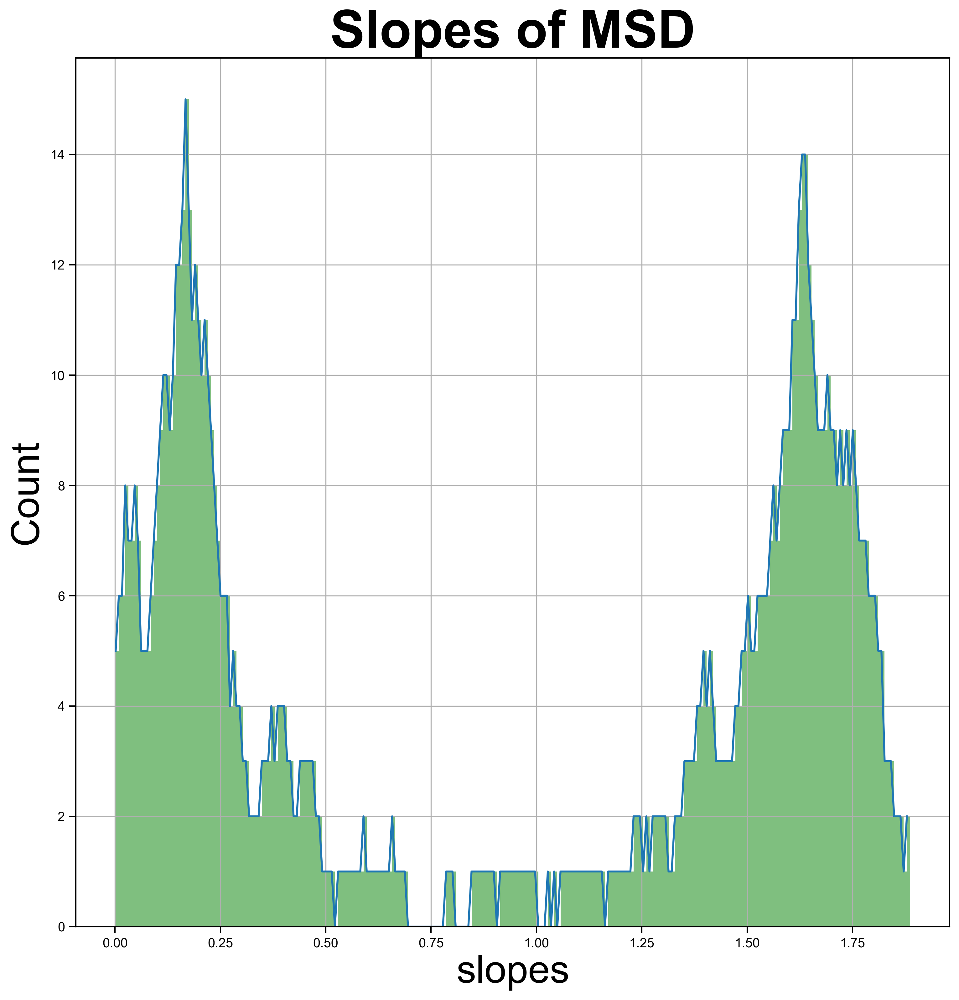

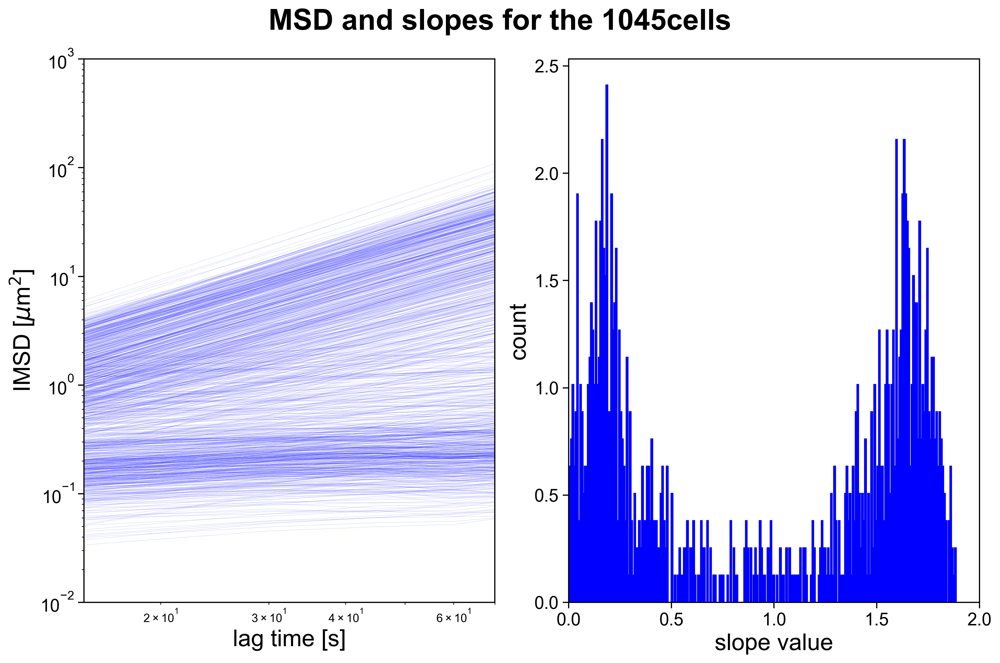

In [25]:
# Trajectory clustering with fit and defining a cutoff
LAG_TIME_FIT = 5
importlib.reload(lib)
COEF_INF, COEF_SUP, PART_COEF_INF, PART_COEF_SUP, CUTOFF = lib.traj_clustering_with_fit_cutoff(
    DATA, imsd=IMSD, hist=True, lag_time_fit=LAG_TIME_FIT, micronperpixel=SIZE_PIX,
    fps=FPS, binsize=250, peak_height=50, peak_width=1, save=True, pathway_fig=path_save_pic,
    name='all_experiment_autocorr', img_type=IMG_TYPE, plot=True, color_sup_inf=color_sup_inf,
    cutoff_default=0
)

# Keep only particles above cutoff
DATA = DATA[DATA['particle'].isin(PART_COEF_SUP)]

###
<center><span style="color: skyblue; font-size: 20px"> Nombre de particules par frame pour les expériences. </span></center>

ça n'a pas un grand interêt ici, mais c'est par principe pour vérification et compréhension d'éventuels phenomènes.

In [26]:
DATA['experiment']

0         ASMOT134
55520     ASMOT150
266761    ASMOT176
267101    ASMOT110
54960     ASMOT150
            ...   
116461    ASMOT149
150317    ASMOT181
255764    ASMOT177
25081     ASMOT128
329287    ASMOT127
Name: experiment, Length: 321477, dtype: object

In [27]:
DATA[DATA['experiment'] == 'ASMOT157'].groupby('time (min)')['particle'].nunique()

time (min)
0.00     14
0.25     14
0.50     14
0.75     14
1.00     14
         ..
83.75    13
84.00    13
84.25    13
84.50    13
84.75    13
Name: particle, Length: 340, dtype: int64

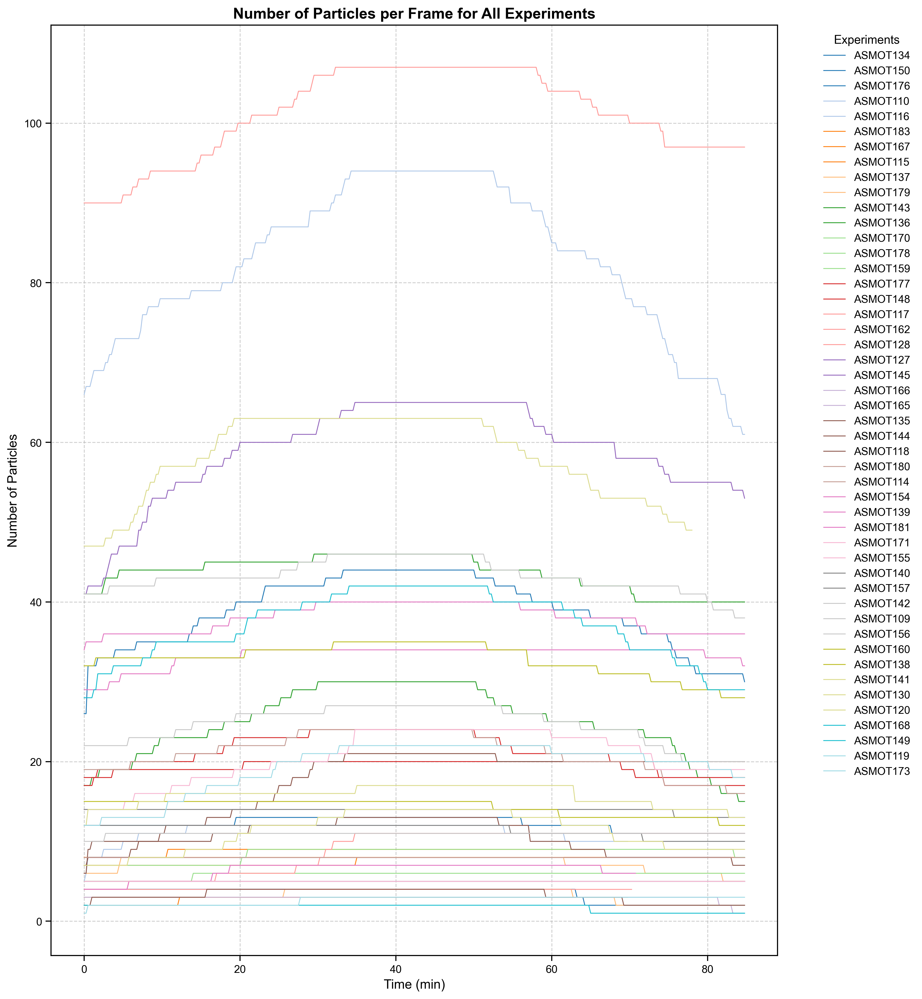

Plot saved to /Users/souchaud/Desktop/Analyses/résultats_CytoOne_HL5_10x_results_tracking_All/Nbr_particle_per_Frame_combined.png


In [28]:
# Plot Number of Particles per Frame for All Experiments in One Graph
def plot_nbr_particles_per_frame_combined(DATA, path_save_pic, IMG_TYPE):
    """
    Plot the number of unique particles per frame for all experiments on a single graph with different colors.

    Parameters:
    - DATA (DataFrame): The input data containing tracking information.
    - path_save_pic (str): The path where the plot will be saved.
    - IMG_TYPE (str): The format for saving the plot (e.g., 'png', 'jpg').
    """
    experiments = DATA['experiment'].unique()

    # Generate a colormap with enough unique colors for all experiments
    colormap = plt.colormaps['tab20']  # Use the modern colormap API
    colors = [colormap(i / len(experiments)) for i in range(len(experiments))]

    plt.figure(figsize=(12, 13))
    for i, exp in enumerate(experiments):
        # Group data by time and calculate the number of unique particles per frame
        nbr_part_per_frame = DATA[DATA['experiment'] == exp].groupby('time (min)')['particle'].nunique()
        plt.plot(
            nbr_part_per_frame.index, nbr_part_per_frame.values, 
            label=exp, color=colors[i], alpha=1, linewidth=0.8
        )

    # Add labels, legend, and title
    plt.title('Number of Particles per Frame for All Experiments', fontsize=14)
    plt.xlabel('Time (min)', fontsize=12)
    plt.ylabel('Number of Particles', fontsize=12)
    plt.legend(title="Experiments", bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=10)
    plt.grid(True, linestyle='--', alpha=0.6)
    plt.tight_layout()

    # Save and show the plot
    fig_path = os.path.join(path_save_pic, f"Nbr_particle_per_Frame_combined.{IMG_TYPE}")
    plt.savefig(fig_path, format=IMG_TYPE, bbox_inches='tight')
    plt.show()

    print(f"Plot saved to {fig_path}")

# Appel de la fonction
plot_nbr_particles_per_frame_combined(DATA, path_save_pic, IMG_TYPE)

###
<center><span style="color: skyblue; font-size: 20px"> Nombre de particules par frame pour toutes les paticules. </span></center>


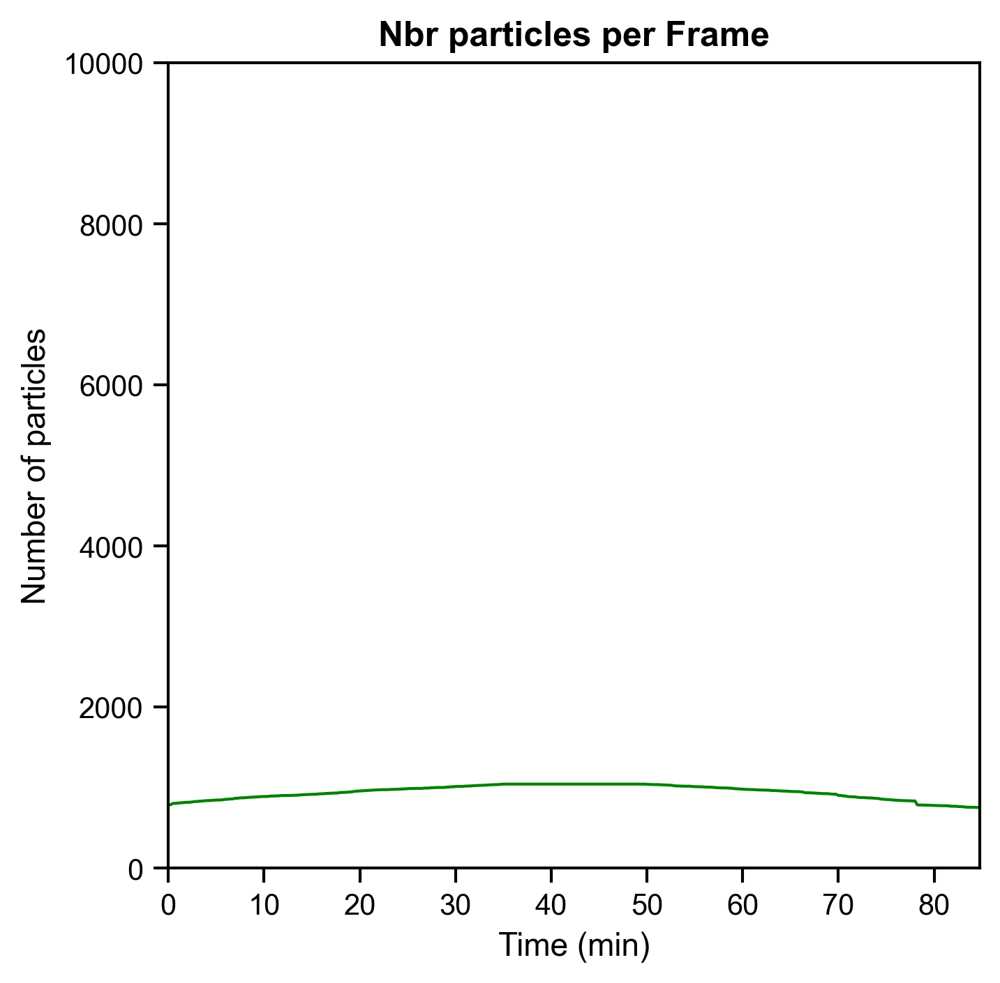

Figure saved at: /Users/souchaud/Desktop/Analyses/résultats_CytoOne_HL5_10x_results_tracking_All/Nbr_particles_per_Frame.png


In [29]:
# Plot Number of Particles per Frame
nbr_part_per_frame = DATA.groupby('time (min)')['particle'].nunique()
lib.plot_datas(
    x_values=nbr_part_per_frame.index,
    y_values=nbr_part_per_frame.values,
    title='Nbr particles per Frame',
    x_label='Time (min)', y_label='Number of particles',
    x_lim=[0, nbr_part_per_frame.index.max()], y_lim=[0, 10000],
    save=True, path_save_pic=path_save_pic, img_type=IMG_TYPE
)

###
<center><span style="color: skyblue; font-size: 40px">Trajectoires toutes rassemblées. </span></center>


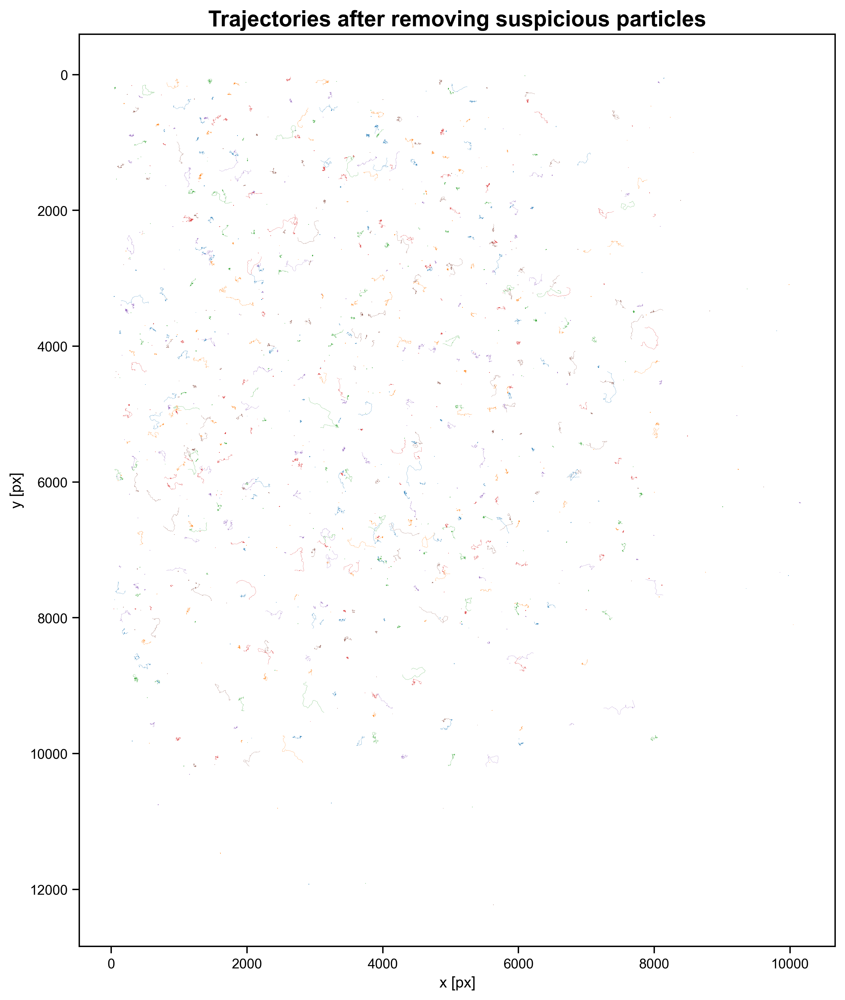

In [30]:
# Plot Trajectories after Removing Suspicious Particles
fig, axis = plt.subplots(figsize=(12, 12), dpi=300)
axis.set_aspect('equal', 'box')
plt.title('Trajectories after removing suspicious particles', fontsize=16)
tp.plot_traj(DATA, label=False, ax=axis)
for line in axis.get_lines():
    line.set_linewidth(0.1)
plt.show()
fig.savefig(os.path.join(path_save_pic, f'Trajectories_after_removing_suspicious_particles.{IMG_TYPE}'),
            format=IMG_TYPE, dpi=300, bbox_inches='tight')

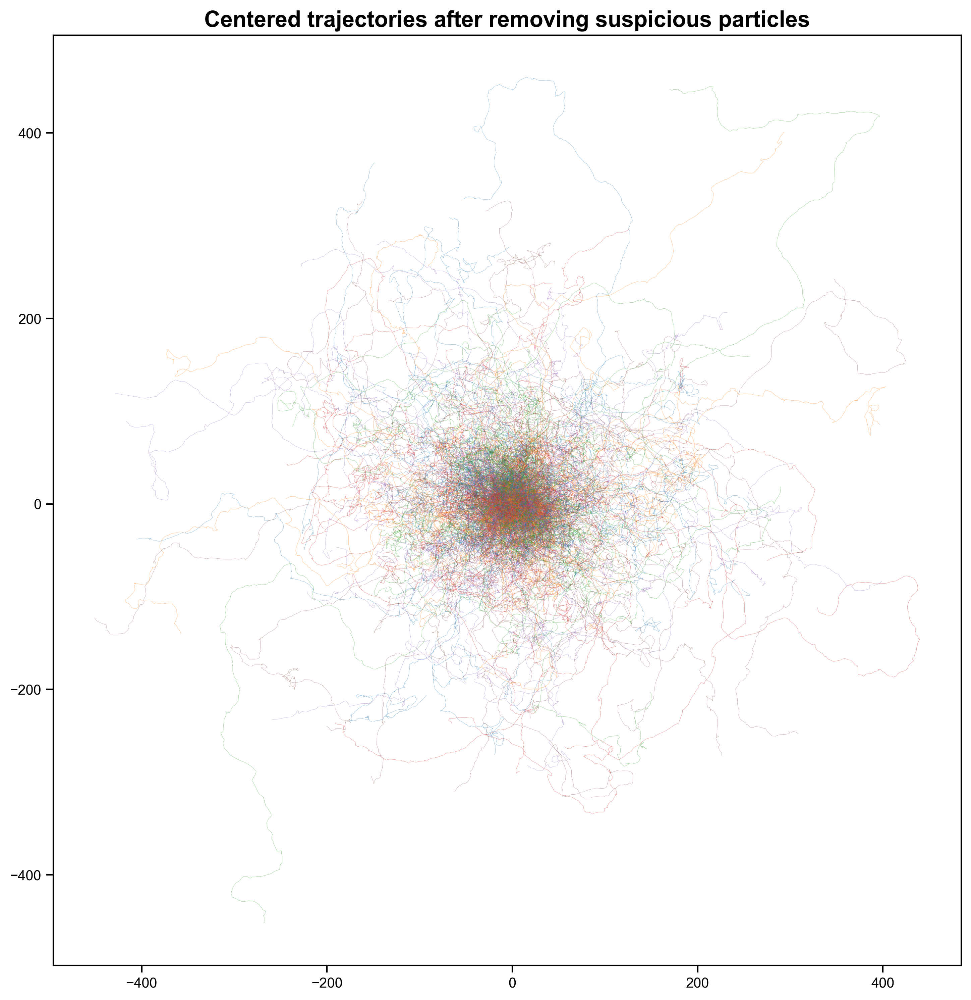

In [31]:
# Pour éviter les effets de labels/marqueurs automatiques
def plot_trajectories(data, ax, color=None, linewidth=0.2, alpha=0.5):
    for pid, group in data.groupby('particle'):
        ax.plot(group['Xc [pix]'], group['Yc [pix]'], color=color, lw=linewidth, alpha=alpha)

# Plot centered Trajectories after Removing Suspicious Particles
fig, axis = plt.subplots(figsize=(12, 12), dpi=300)
axis.set_aspect('equal', 'box')
plt.title('Centered trajectories after removing suspicious particles', fontsize=16)
# tp.plot_traj(DATA[['Xc [pix]', 'Yc [pix]', 'frame', 'particle']].rename(columns={'Xc [pix]': 'x', 'Yc [pix]': 'y'}), label=False, ax=axis)
plot_trajectories(DATA, ax=axis, linewidth=0.5, alpha=0.5)
for line in axis.get_lines():
    line.set_linewidth(0.2)
plt.show()
fig.savefig(os.path.join(path_save_pic, f'Centered trajectories_after_removing_suspicious_particles.{IMG_TYPE}'),
            format=IMG_TYPE, dpi=300, bbox_inches='tight')

###
<center><span style="color: skyblue; font-size: 20px"> Vitesse instantanée moyenne par frame. </span></center>


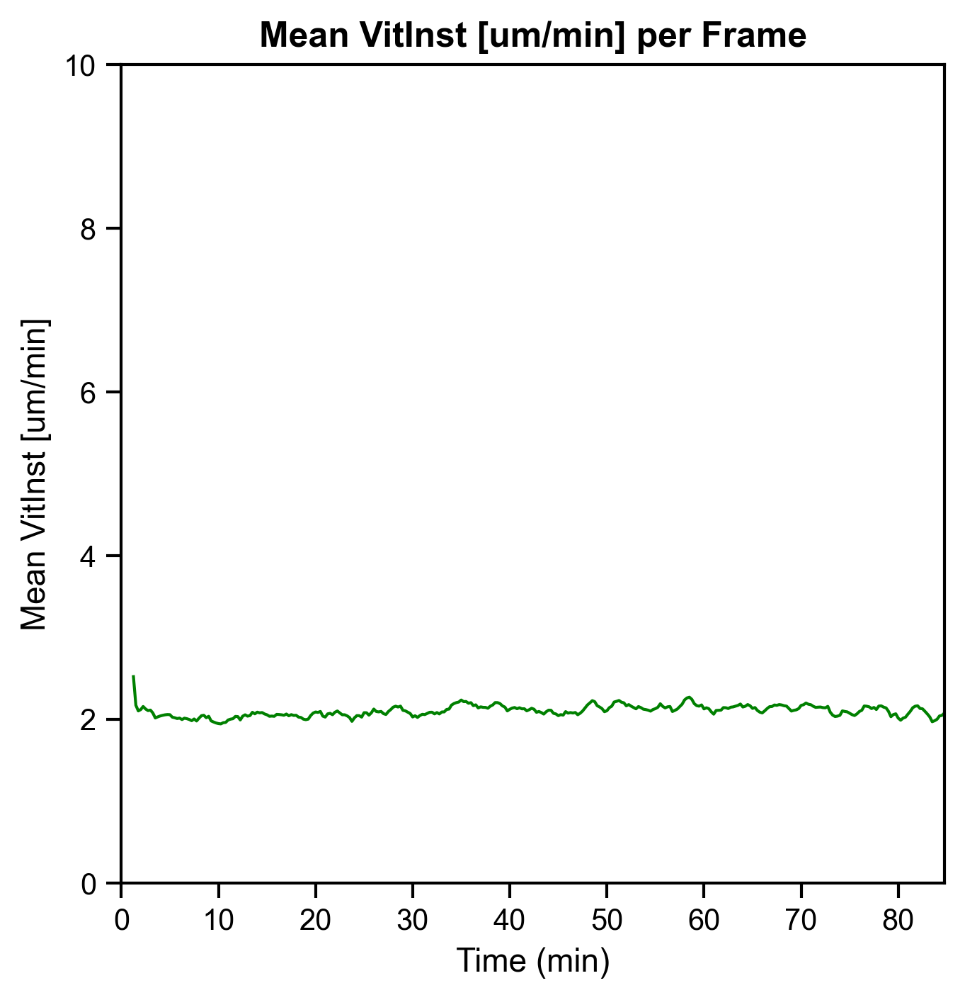

Figure saved at: /Users/souchaud/Desktop/Analyses/résultats_CytoOne_HL5_10x_results_tracking_All/Mean_VitInst_[um_min]_per_Frame.png


In [32]:
# Plot Mean Instantaneous Speed per Frame
mean_VitInst_per_frame = DATA.groupby('time (min)')['VitInst [um/min]'].median()
mean_VitInst_per_frame = mean_VitInst_per_frame.rolling(5).mean().dropna()

# Appel avec vérification du répertoire
lib.plot_datas(
    x_values=mean_VitInst_per_frame.index,
    y_values=mean_VitInst_per_frame.values,
    title='Mean VitInst [um/min] per Frame',
    x_label='Time (min)', y_label='Mean VitInst [um/min]',
    x_lim=[0, mean_VitInst_per_frame.index.max()], y_lim=[0, 10],
    save=True, path_save_pic=path_save_pic, img_type=IMG_TYPE
)

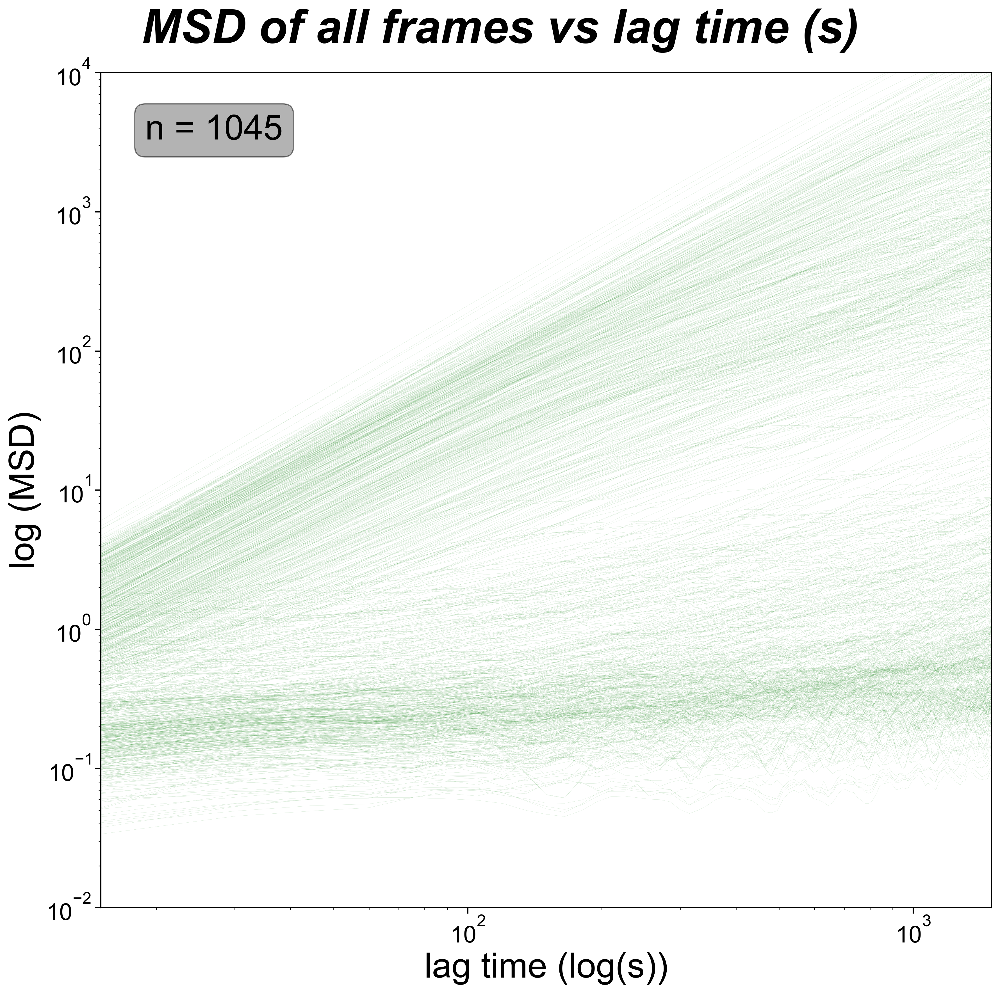

In [33]:
# Recompute MSD
# DATA_intermediaire = DATA.copy()
DATA['frame'] = pd.factorize(DATA['frame'])[0]
IMSD = tp.imsd(traj=DATA, mpp=SIZE_PIX, fps=FPS, max_lagtime=200, statistic='msd')

lib.plot_msd(IMSD, fps=FPS, name="MSD of all frames vs lag time (s)",
             color_plot='forestgreen', save=True, pathway_saving=path_save_pic,
             alpha=0.3, linewidth=0.1, img_type=IMG_TYPE)

In [34]:
# Reload custom library
importlib.reload(lib)

<module 'functions_analyze' from '/Users/souchaud/Desktop/Dictyostelium/Motility/Analyse_tracking/tracking_and_analyze/traitement_tracking/functions_analyze.py'>

# negative slope 0


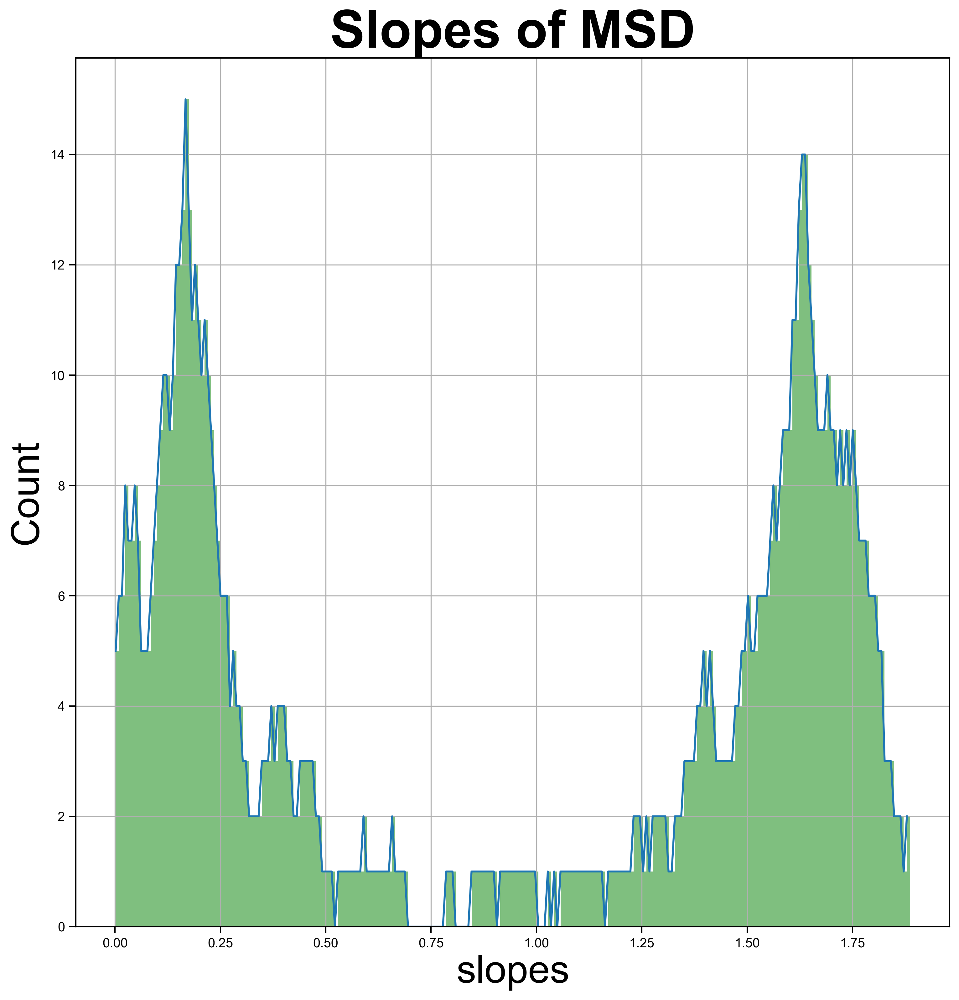

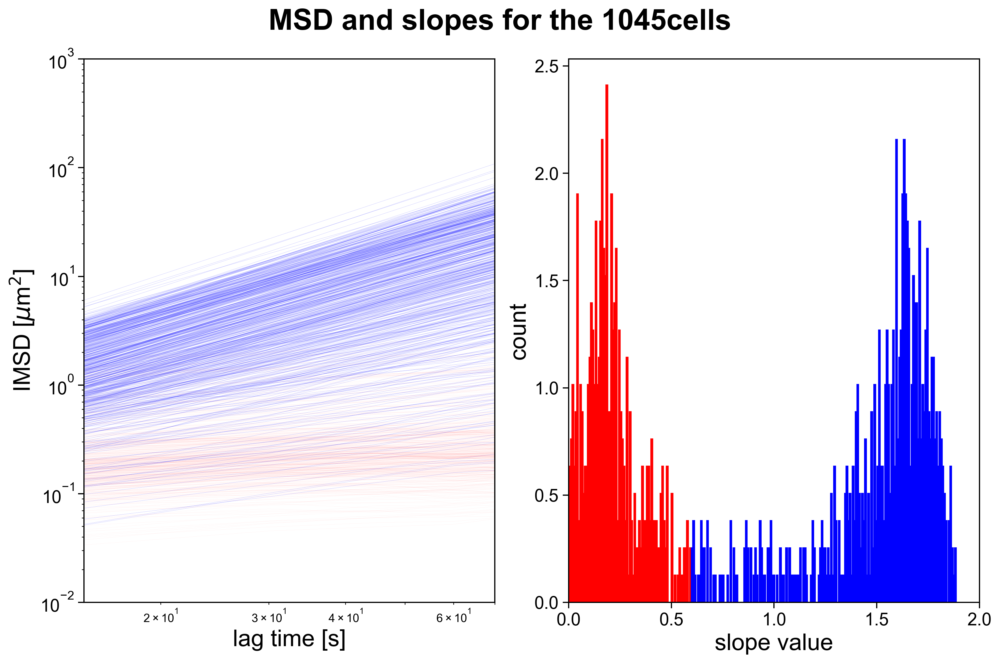

In [35]:
# Recompute trajectory clustering with new cutoff
LAG_TIME_FIT = 5
COEF_INF, COEF_SUP, PART_COEF_INF, PART_COEF_SUP, CUTOFF = lib.traj_clustering_with_fit_cutoff(
    DATA, imsd=IMSD, hist=True, lag_time_fit_start=0, lag_time_fit=LAG_TIME_FIT , micronperpixel=SIZE_PIX,
    fps=FPS, binsize=250, peak_height=50, peak_width=1, save=True, pathway_fig=path_save_pic,
    name='MSD and slopes', img_type=IMG_TYPE, plot=True, color_sup_inf=color_sup_inf,
    cutoff_default=0.6
)

# Ajouter les colonnes 'is_inf' et 'is_sup' à DATA
DATA['particle'] = DATA['particle'].astype(int)
PART_COEF_INF = set(map(int, PART_COEF_INF))
PART_COEF_SUP = set(map(int, PART_COEF_SUP))

# Ajout des colonnes 'is_inf' et 'is_sup'
DATA['is_inf'] = DATA['particle'].isin(PART_COEF_INF).astype(int)
DATA['is_sup'] = DATA['particle'].isin(PART_COEF_SUP).astype(int)


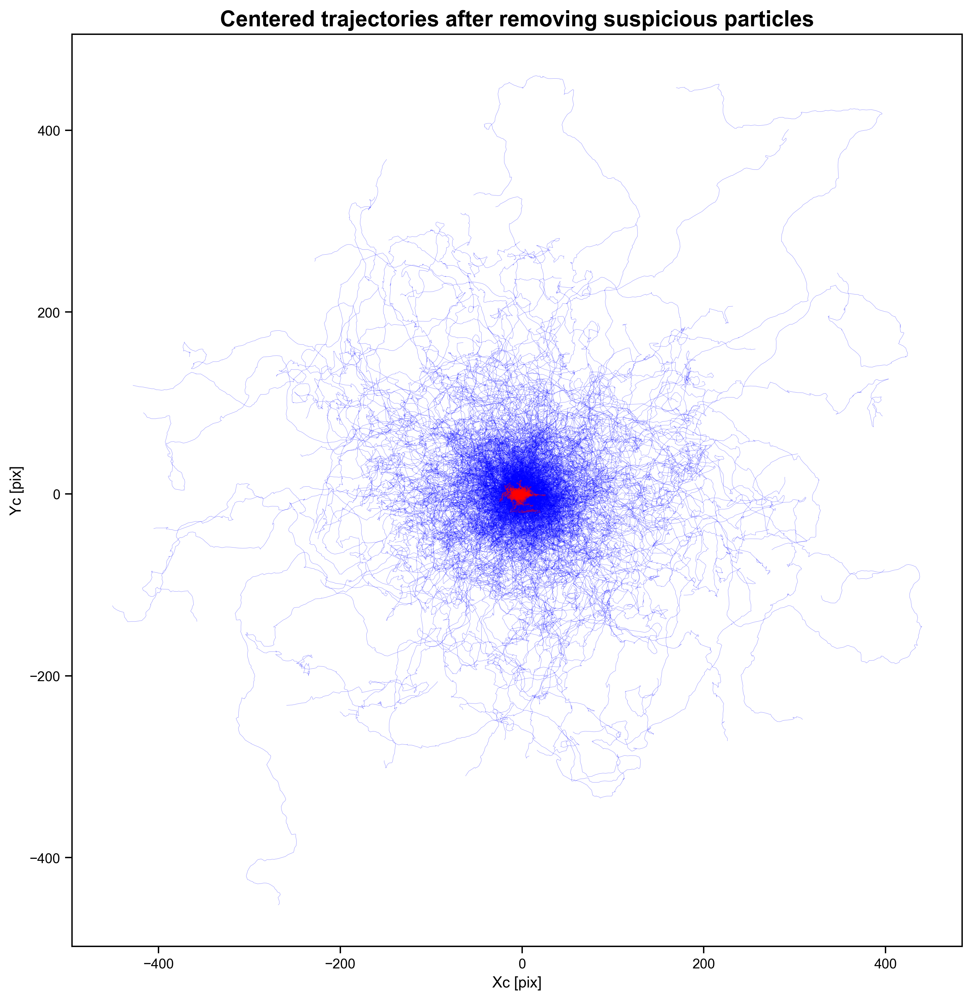

In [36]:
fig, axis = plt.subplots(figsize=(12, 12), dpi=300)
axis.set_aspect('equal', 'box')
plt.title('Centered trajectories after removing suspicious particles', fontsize=16)

# 2. Trajectoires bleues (PART_COEF_SUP)
data_sup = DATA[DATA['particle'].isin(PART_COEF_SUP)]
plot_trajectories(data_sup, color='blue', ax=axis, linewidth=0.2)

# 1. Trajectoires rouges (PART_COEF_INF)
data_inf = DATA[DATA['particle'].isin(PART_COEF_INF)]
plot_trajectories(data_inf, color='red', ax=axis, linewidth=0.2)



plt.xlabel('Xc [pix]')
plt.ylabel('Yc [pix]')
plt.show()

# Enregistrement
fig.savefig(
    os.path.join(path_save_pic, f'Centered_trajectories_grouped.{IMG_TYPE}'),
    format=IMG_TYPE, dpi=300, bbox_inches='tight'
)

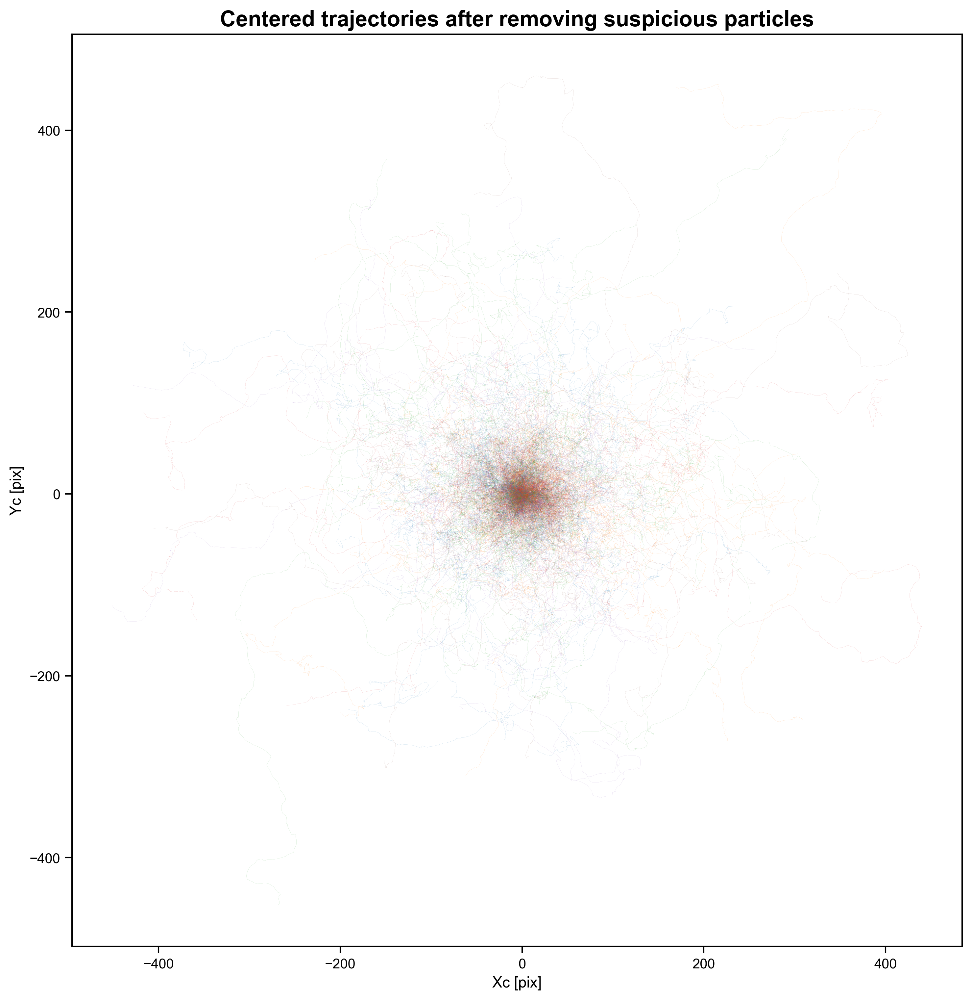

In [37]:
# 1. Trajectoires rouges (PART_COEF_INF)
data_center = DATA[DATA['particle'].isin(PART_COEF_SUP)]
fig, axis = plt.subplots(figsize=(12, 12), dpi=300)
axis.set_aspect('equal', 'box')
plt.title('Centered trajectories after removing suspicious particles', fontsize=16)
plot_trajectories(data_center, ax=axis, linewidth=0.1, alpha=0.3)
plt.xlabel('Xc [pix]')
plt.ylabel('Yc [pix]')
plt.show()


In [38]:
data_coef_sup = DATA[DATA['particle'].isin(PART_COEF_INF)]
data_coef_sup['experiment'].unique()

array(['ASMOT134', 'ASMOT176', 'ASMOT150', 'ASMOT183', 'ASMOT115',
       'ASMOT179', 'ASMOT167', 'ASMOT136', 'ASMOT170', 'ASMOT178',
       'ASMOT159', 'ASMOT143', 'ASMOT177', 'ASMOT117', 'ASMOT162',
       'ASMOT148', 'ASMOT145', 'ASMOT166', 'ASMOT165', 'ASMOT110',
       'ASMOT135', 'ASMOT144', 'ASMOT118', 'ASMOT180', 'ASMOT154',
       'ASMOT114', 'ASMOT139', 'ASMOT181', 'ASMOT171', 'ASMOT155',
       'ASMOT140', 'ASMOT157', 'ASMOT142', 'ASMOT156', 'ASMOT160',
       'ASMOT138', 'ASMOT141', 'ASMOT120', 'ASMOT168', 'ASMOT149',
       'ASMOT130', 'ASMOT119', 'ASMOT173', 'ASMOT127'], dtype=object)

In [39]:
data_coef_sup[data_coef_sup['experiment'] == 'ASMOT118']['particle'].unique()

array([84571, 84648, 84570, 84703, 84854])

In [40]:
data_coef_sup[data_coef_sup['particle'] == 6977]

,index,y,x,mass,size,ecc,signal,raw_mass,ep,frame,...,dy [pix],displacement [pix],VitInst [um/min],time to incubation (hours),cluster,Xc [pix],Yc [pix],cumulative displacement [um],is_inf,is_sup


In [41]:
import os
import glob
import cv2
import numpy as np

base_image_dir = "/Users/souchaud/Desktop/A_analyser/CytoOne_HL5_10x_faits/"
output_dir = "/Users/souchaud/Desktop/faibles/"
os.makedirs(output_dir, exist_ok=True)

# Pour chaque expérience concernée :
for experiment in data_coef_sup['experiment'].unique():
    # Filtre les données pour cette expérience
    sub_df = data_coef_sup[data_coef_sup['experiment'] == experiment]
    
    # Trouve le dossier
    experiment_dirs = glob.glob(os.path.join(base_image_dir, f"*{experiment}*"))
    if not experiment_dirs:
        print(f"Dossier pour {experiment} non trouvé !")
        continue
    experiment_dir = experiment_dirs[0]
    
    # Chemin vers l'image frame 0
    img_path = os.path.join(experiment_dir, "mosaic/mosaic_total_0.tif")
    if not os.path.isfile(img_path):
        print(f"Image {img_path} non trouvée !")
        continue

    # Charge l'image
    img = cv2.imread(img_path)
    if img is None:
        print(f"Image {img_path} illisible !")
        continue

    # Place les cercles rouges sur chaque (x, y)
    for _, row in sub_df.iterrows():
        x = int(round(row["x"]))  # ou "Xc [pix]"
        y = int(round(row["y"]))  # ou "Yc [pix]"
        cv2.circle(img, (x, y), 50, (0, 0, 255), 3)  # Rayon 20 pixels, épaisseur 3

    # Sauvegarde l'image annotée
    out_path = os.path.join(output_dir, f"{experiment}_mosaic_total_0_annotated.png")
    cv2.imwrite(out_path, img)
    print(f"Image annotée sauvegardée : {out_path}")

Image annotée sauvegardée : /Users/souchaud/Desktop/faibles/ASMOT134_mosaic_total_0_annotated.png
Image annotée sauvegardée : /Users/souchaud/Desktop/faibles/ASMOT176_mosaic_total_0_annotated.png
Image annotée sauvegardée : /Users/souchaud/Desktop/faibles/ASMOT150_mosaic_total_0_annotated.png
Image annotée sauvegardée : /Users/souchaud/Desktop/faibles/ASMOT183_mosaic_total_0_annotated.png
Image annotée sauvegardée : /Users/souchaud/Desktop/faibles/ASMOT115_mosaic_total_0_annotated.png
Image annotée sauvegardée : /Users/souchaud/Desktop/faibles/ASMOT179_mosaic_total_0_annotated.png
Image annotée sauvegardée : /Users/souchaud/Desktop/faibles/ASMOT167_mosaic_total_0_annotated.png
Image annotée sauvegardée : /Users/souchaud/Desktop/faibles/ASMOT136_mosaic_total_0_annotated.png
Image annotée sauvegardée : /Users/souchaud/Desktop/faibles/ASMOT170_mosaic_total_0_annotated.png
Image annotée sauvegardée : /Users/souchaud/Desktop/faibles/ASMOT178_mosaic_total_0_annotated.png
Image annotée sauveg

KeyboardInterrupt: 

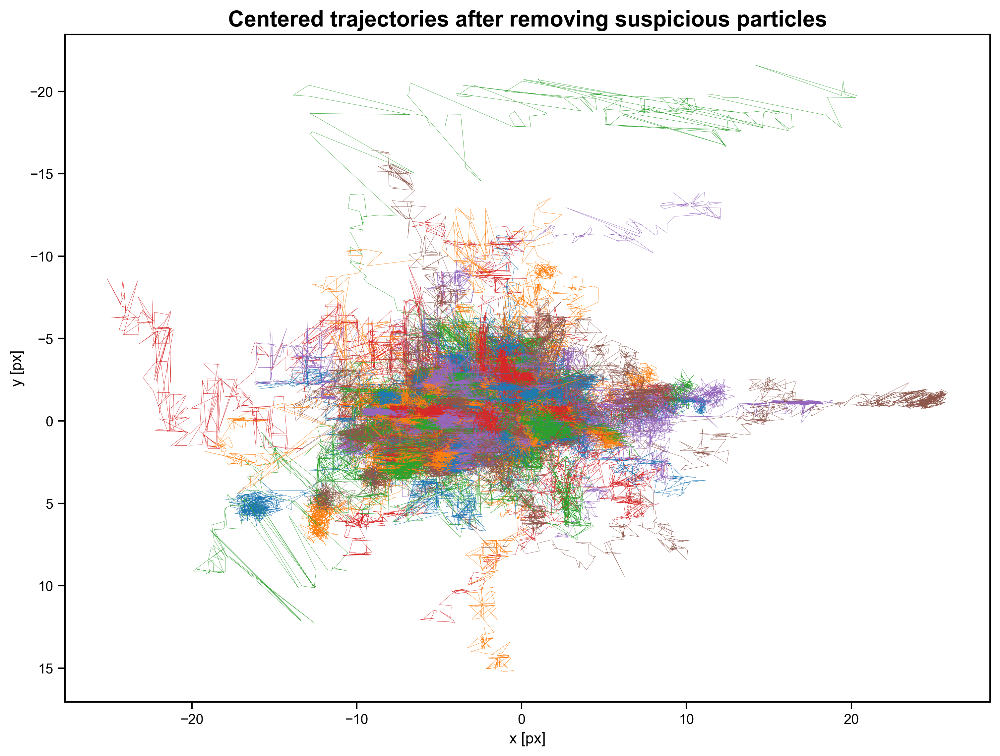

In [42]:
# Plot centered Trajectories after Removing Suspicious Particles
fig, axis = plt.subplots(figsize=(12, 12), dpi=300)
axis.set_aspect('equal', 'box')
plt.title('Centered trajectories after removing suspicious particles', fontsize=16)
data_inf = DATA[DATA['particle'].isin(PART_COEF_INF)]
tp.plot_traj(data_inf[['Xc [pix]', 'Yc [pix]', 'frame', 'particle']].rename(columns={'Xc [pix]': 'x', 'Yc [pix]': 'y'}), label=False, ax=axis)
for line in axis.get_lines():
    line.set_linewidth(0.2)
plt.show()
# fig.savefig(os.path.join(path_save_pic, f'Centered trajectories_after_removing_suspicious_particles.{IMG_TYPE}'),
#             format=IMG_TYPE, dpi=300, bbox_inches='tight')

In [45]:
PART_COEF_INF

{11520,
 11525,
 11589,
 11652,
 12348,
 12422,
 12490,
 13010,
 13011,
 13468,
 13525,
 13542,
 15162,
 15324,
 15325,
 15360,
 15373,
 15375,
 15405,
 15450,
 15506,
 15623,
 15624,
 15651,
 15668,
 15693,
 15707,
 15708,
 15714,
 15715,
 15718,
 15751,
 15759,
 15783,
 15816,
 15874,
 15909,
 16012,
 16039,
 16287,
 16704,
 16765,
 16766,
 16884,
 18406,
 18482,
 21149,
 21219,
 21707,
 22940,
 23208,
 23974,
 25796,
 26148,
 26208,
 26637,
 27084,
 27493,
 27591,
 27905,
 28030,
 28372,
 29538,
 29682,
 29720,
 30241,
 30496,
 31425,
 31561,
 33115,
 33116,
 33512,
 33540,
 33614,
 34172,
 34173,
 34434,
 34449,
 34477,
 34478,
 34479,
 34480,
 34499,
 34526,
 34527,
 34528,
 34529,
 34538,
 34581,
 34582,
 34601,
 34602,
 34613,
 34614,
 34615,
 34616,
 34617,
 34619,
 34645,
 34646,
 34651,
 34653,
 34654,
 34655,
 34666,
 34667,
 34668,
 34698,
 34792,
 34840,
 35019,
 35066,
 35067,
 35095,
 35129,
 35225,
 35375,
 35409,
 35474,
 35521,
 35884,
 35919,
 35923,
 36103,
 36104,


In [191]:
print("Nb de particules total :", DATA['particle'].nunique())
print("Nb particules INF demandées :", len(PART_COEF_INF))
print("Nb réellement trouvées :", DATA[DATA['particle'].isin(PART_COEF_INF)]['particle'].nunique())
# ─────────────────────────────────────────────────────────────────────────────
#  MSD MOYENNE : GLOBAL vs PART_COEF_INF vs PART_COEF_SUP
# ─────────────────────────────────────────────────────────────────────────────
import matplotlib.pyplot as plt
import pandas as pd
import trackpy as tp
import numpy as np

MAX_LAG = 200   # le même que précédemment (en frames)

# --- 2) MSD moyenne des particules INF ------------------
DATA_inf  = DATA[DATA['particle'].isin(PART_COEF_INF)]
# --- 3) MSD moyenne des particules SUP ------------------
DATA_sup  = DATA[DATA['particle'].isin(PART_COEF_SUP)]

EMSD_inf = tp.emsd(traj=DATA[DATA['particle'].isin(PART_COEF_INF)], mpp=SIZE_PIX, fps=FPS, max_lagtime=MAX_LAG, detail=True)
EMSD_sup = tp.emsd(traj=DATA[DATA['particle'].isin(PART_COEF_SUP)], mpp=SIZE_PIX, fps=FPS, max_lagtime=MAX_LAG, detail=True)
EMSD = tp.emsd(traj=DATA, mpp=SIZE_PIX, fps=FPS, max_lagtime=MAX_LAG, detail=True)

Nb de particules total : 1045
Nb particules INF demandées : 442
Nb réellement trouvées : 442


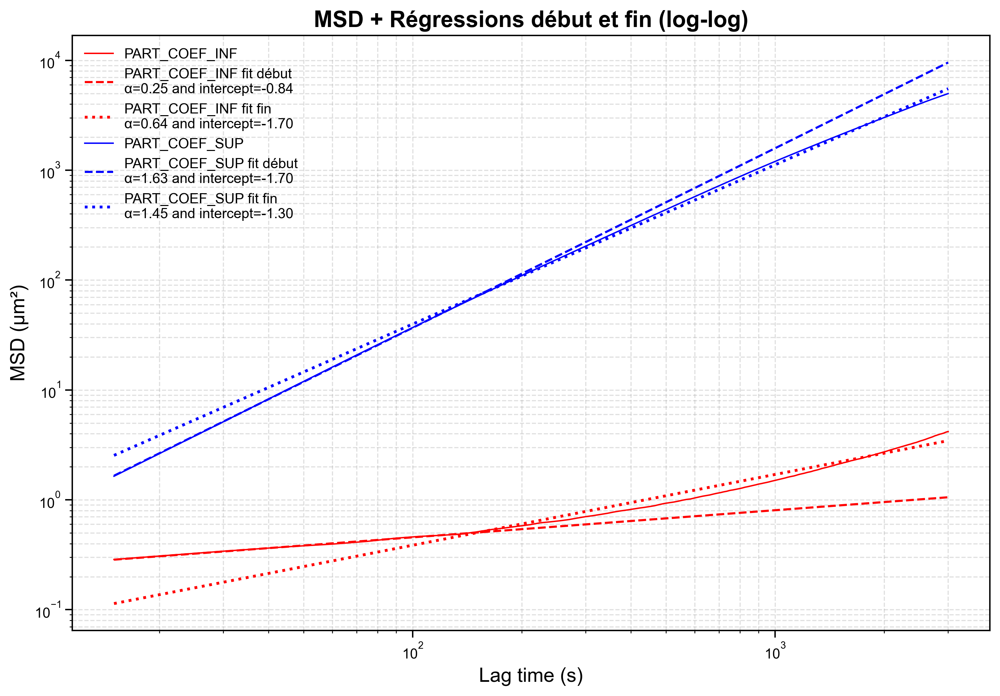

In [192]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import linregress

# Nombre de points à utiliser pour les fits
N_points = 10

# Préparer le plot
plt.figure(figsize=(10, 7))

# Courbes à tracer
courbes = {
    # 'Global': EMSD,
    'PART_COEF_INF': EMSD_inf,
    'PART_COEF_SUP': EMSD_sup
}

# Couleurs associées
couleurs = {
    # 'Global': 'black',
    'PART_COEF_INF': 'red',
    'PART_COEF_SUP': 'blue'
}

# Tracer les courbes MSD + les fits
for label, df in courbes.items():
    lag = np.array(df['lagt'])
    msd = np.array(df['msd'])

    # Tracer la courbe principale
    plt.plot(lag, msd, label=label, color=couleurs[label], linewidth=1)

    # === Fit court temps ===
    log_lag_start = np.log10(lag[:N_points])
    log_msd_start = np.log10(msd[:N_points])
    slope_start, intercept_start, _, _, _ = linregress(log_lag_start, log_msd_start)
    fit_start = 10 ** (slope_start * np.log10(lag[:]) + intercept_start)

    plt.plot(lag[:], fit_start, '--', color=couleurs[label],
             linewidth=1.5, label=f"{label} fit début\nα={slope_start:.2f} and intercept={intercept_start:.2f}")

    # === Fit long temps ===
    log_lag_end = np.log10(lag[:])
    log_msd_end = np.log10(msd[:])
    slope_end, intercept_end, _, _, _ = linregress(log_lag_end, log_msd_end)
    fit_end = 10 ** (slope_end * np.log10(lag[:]) + intercept_end)

    plt.plot(lag[:], fit_end, ':', color=couleurs[label],
             linewidth=2, label=f"{label} fit fin\nα={slope_end:.2f} and intercept={intercept_end:.2f}")

# Mise en forme du graphe
plt.xscale('log')
plt.yscale('log')
plt.xlabel('Lag time (s)', fontsize=14)
plt.ylabel('MSD (µm²)', fontsize=14)
plt.title('MSD + Régressions début et fin (log-log)', fontsize=16)
plt.grid(True, which='both', ls='--', alpha=0.4)
plt.legend(fontsize=10)
plt.tight_layout()
plt.show()

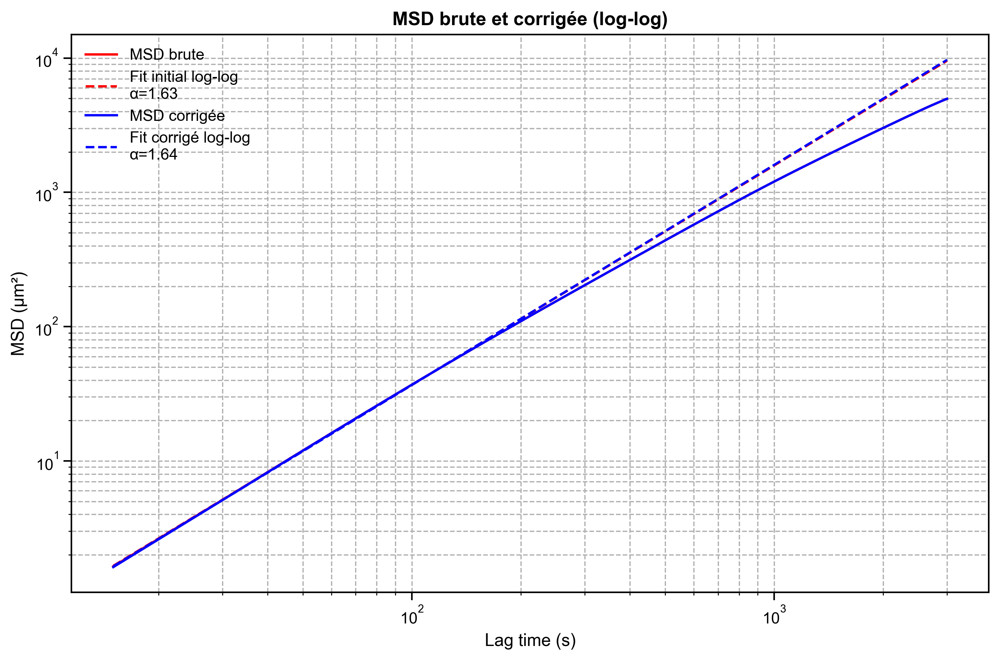

In [193]:
# --- Fit log-log sur les 10 premiers points ---
N_FIRST = 10
log_lag = np.log10(lag[:N_FIRST])
log_msd = np.log10(msd[:N_FIRST])

slope_log, intercept_log, *_ = linregress(log_lag, log_msd)

# Interprétation :
# slope_log ≈ α (exposant de la MSD)
# intercept_log ≈ log10(2σ²) si \tau \to 0 (donc au tout début)

sigma2_times2_estime = 10 ** intercept_log  # valeur estimée de 2σ² depuis le fit log-log

# --- Correction ---
msd_corr = msd - sigma2_times2_estime
msd_corr[msd_corr < 0] = np.nan

# Nouveau fit log-log sur les données corrigées
log_msd_corr = np.log10(msd_corr[:N_FIRST])
slope_corr_log, intercept_corr_log, *_ = linregress(log_lag, log_msd_corr)

# --- Reconstruction pour tracé ---
fit_orig = 10 ** (slope_log * np.log10(lag) + intercept_log)
fit_corr = 10 ** (slope_corr_log * np.log10(lag) + intercept_corr_log)

# --- Tracé log-log ---
plt.figure(figsize=(9, 6))
plt.plot(lag, msd, 'r-', label='MSD brute')
plt.plot(lag, fit_orig, 'r--', label=f'Fit initial log-log\nα={slope_log:.2f}')

plt.plot(lag, msd_corr, 'b-', label='MSD corrigée')
plt.plot(lag, fit_corr, 'b--', label=f'Fit corrigé log-log\nα={slope_corr_log:.2f}')

plt.xscale('log')
plt.yscale('log')
plt.xlabel('Lag time (s)')
plt.ylabel('MSD (µm²)')
plt.title('MSD brute et corrigée (log-log)')
plt.grid(True, which='both', ls='--')
plt.legend()
plt.tight_layout()
plt.show()

###
<center><span style="color: skyblue; font-size: 40px">Calculs des différents metrics importants </span></center>


In [194]:
def calculate_metrics(DATA):
    # Calculer les vitesses moyennes instantanées pour toutes les particules
    mean_vitinst_df = DATA.groupby(['experiment', 'particle'])['VitInst [um/min]'].mean().reset_index()
    mean_vitinst_df = mean_vitinst_df.rename(columns={'VitInst [um/min]': 'mean_vit_inst'})

    # Calculer les médianes des vitesses instantanées pour toutes les particules
    median_vitinst_df = DATA.groupby(['experiment', 'particle'])['VitInst [um/min]'].median().reset_index()
    median_vitinst_df = median_vitinst_df.rename(columns={'VitInst [um/min]': 'median_vit_inst'})

    # Initialisation d'une liste pour stocker les résultats
    metrics = []

    # Parcours de chaque particule pour calculer les métriques
    for particle, group in DATA.groupby('particle'):
        experiment = group['experiment'].iloc[0]

        # Limiter aux 200 premières lignes
        limited_group = group.head(200)

        # Somme des déplacements (seulement sur les 200 premières lignes)
        displacement_sum = limited_group['displacement [pix]'].sum()

        # Récupérer la vitesse moyenne instantanée pré-calculée
        mean_vit_inst = mean_vitinst_df.loc[
            (mean_vitinst_df['experiment'] == experiment) & (mean_vitinst_df['particle'] == particle),
            'mean_vit_inst'
        ].values[0]

        # Récupérer la médiane des vitesses instantanées pré-calculée
        median_vit_inst = median_vitinst_df.loc[
            (median_vitinst_df['experiment'] == experiment) & (median_vitinst_df['particle'] == particle),
            'median_vit_inst'
        ].values[0]

        # Distance entre la position de départ et d'arrivée
        start_position = limited_group.iloc[0][['x', 'y']].values
        end_position = limited_group.iloc[-1][['x', 'y']].values
        start_end_distance = np.linalg.norm(end_position - start_position)

        # Stocker les résultats dans un dictionnaire
        metrics.append({
            'experiment': experiment,
            'particle': particle,
            'displacement_sum [um]': displacement_sum,
            'mean_vit_inst [um/min]': mean_vit_inst,
            'median_vit_inst [um/min]': median_vit_inst,
            'start_end_distance [um]': start_end_distance
        })

    # Conversion en DataFrame
    metrics_df = pd.DataFrame(metrics)
    return metrics_df

# Appel de la fonction pour obtenir le DataFrame consolidé
metrics_df = calculate_metrics(DATA)

# Affichage pour vérification
metrics_df.head(10)

,experiment,particle,displacement_sum [um],mean_vit_inst [um/min],median_vit_inst [um/min],start_end_distance [um]
0,ASMOT134,11520,109.607006,1.404025,1.303963,5.592772
1,ASMOT134,11525,274.693402,3.606861,2.954418,5.980604
2,ASMOT134,11589,113.988656,1.427328,1.293931,5.468115
3,ASMOT134,11652,127.645325,1.599355,1.478966,4.925055
4,ASMOT128,11824,278.402153,3.613877,3.116896,53.197849
5,ASMOT128,11825,225.843217,3.504805,3.080400,44.506731
6,ASMOT128,11826,301.915359,4.518118,4.057859,48.445094
7,ASMOT128,11827,457.565431,5.687678,5.134274,201.593724
8,ASMOT128,11829,189.262841,2.850162,2.498058,5.288609
9,ASMOT128,11830,304.746749,3.982764,3.495025,23.018544


In [195]:
def calculate_all_metrics(DATA):
    """
    Calcule diverses métriques pour chaque expérience, y compris la vitesse moyenne
    des particules sup et inf.
    """
    # Calculer le temps d'incubation et le nombre de particules (exp_hours)
    exp_hours = (
        DATA.groupby('experiment')
        .agg({
            'time to incubation (hours)': 'first',
            'particle': 'nunique'
        })
        .reset_index()
        .rename(columns={'particle': 'number_of_particles'})
    )

    # Compter les particules is_inf et is_sup
    particle_counts = (
        DATA.groupby(['experiment', 'particle'])
        .agg(
            is_inf=('is_inf', 'max'),
            is_sup=('is_sup', 'max')
        )
        .reset_index()
        .groupby('experiment')
        .agg(
            number_of_inf=('is_inf', 'sum'),
            number_of_sup=('is_sup', 'sum')
        )
        .reset_index()
    )
    particle_counts['proportion_inf'] = particle_counts['number_of_inf'] / (
        particle_counts['number_of_inf'] + particle_counts['number_of_sup']
    )

    # Calculer les métriques issues de metrics_df
    metrics_df = DATA.groupby(['experiment', 'particle']).apply(
        lambda group: {
            'displacement_sum [um]': group.head(200)['displacement [pix]'].sum(),
            'start_end_distance [um]': np.linalg.norm(
                group.head(200).iloc[0][['x', 'y']].values -
                group.head(200).iloc[-1][['x', 'y']].values
            ),
            'mean_vit_inst [um/min]': group['VitInst [um/min]'].median()
        }
    ).apply(pd.Series).reset_index()

    # Ajouter la vitesse mediane pour les particules sup et inf
    sup_inf_speeds = DATA.groupby(['experiment', 'particle']).agg(
        is_sup=('is_sup', 'max'),
        is_inf=('is_inf', 'max'),
        mean_vit_inst=('VitInst [um/min]', 'median')
    ).reset_index()

    # Calculer la vitesse mediane des particules sup et inf par expérience
    sup_inf_speeds_agg = sup_inf_speeds.groupby('experiment').agg(
        mean_speed_sup=('mean_vit_inst', lambda x: x[sup_inf_speeds['is_sup'] == 1].median() if (sup_inf_speeds['is_sup'] == 1).any() else 0),
        mean_speed_inf=('mean_vit_inst', lambda x: x[sup_inf_speeds['is_inf'] == 1].median() if (sup_inf_speeds['is_inf'] == 1).any() else 0)
    ).reset_index()

    # Calculer taille et particules par champ
    spatial_metrics = DATA.groupby('experiment').apply(lambda group: {
        'taille': math.ceil(group['y'].max() / 2048) * math.ceil(group['x'].max() / 2048),
        'nombre_part_par_champs': group['particle'].nunique() /
        (math.ceil(group['y'].max() / 2048) * math.ceil(group['x'].max() / 2048)) if (
            math.ceil(group['y'].max() / 2048) * math.ceil(group['x'].max() / 2048)) > 0 else 0
    }).apply(pd.Series).reset_index()

    # Calculer d'autres métriques
    result_metrics = metrics_df.groupby('experiment').agg(
        displacement_sum_mean=('displacement_sum [um]', 'median'),
        start_end_distance_mean=('start_end_distance [um]', 'median'),
        mean_speed=('mean_vit_inst [um/min]', 'median')
    ).reset_index()

    # Fusionner toutes les métriques
    consolidated_metrics = (
        exp_hours
        .merge(particle_counts, on='experiment', how='outer')
        .merge(result_metrics, on='experiment', how='outer')
        .merge(sup_inf_speeds_agg, on='experiment', how='outer')
        .merge(spatial_metrics, on='experiment', how='outer')
    )

    # Renommer les colonnes après la fusion
    consolidated_metrics = consolidated_metrics.rename(columns={
        'displacement_sum_mean': 'displacement_sum_mean [um]',
        'start_end_distance_mean': 'start_end_distance_mean [um]',
        'mean_speed': 'mean_speed [um/min]',
        'mean_speed_sup': 'mean_speed_sup [um/min]',
        'mean_speed_inf': 'mean_speed_inf [um/min]'
    })

    return consolidated_metrics

# Appel de la fonction
all_metrics_df = calculate_all_metrics(DATA)

# Affichage pour vérification
all_metrics_df.head(10)

,experiment,time to incubation (hours),number_of_particles,number_of_inf,number_of_sup,proportion_inf,displacement_sum_mean [um],start_end_distance_mean [um],mean_speed [um/min],mean_speed_sup [um/min],mean_speed_inf [um/min],taille,nombre_part_par_champs
0,ASMOT109,0.00,46,0,46,0.000000,305.755059,56.526756,3.745908,3.745908,NaN,20.0,2.300000
1,ASMOT110,0.00,94,1,93,0.010638,421.614541,115.700861,4.784669,4.824699,1.053662,20.0,4.700000
2,ASMOT114,0.00,24,8,16,0.333333,402.799191,66.648460,4.807576,5.485497,1.428794,15.0,1.600000
3,ASMOT115,0.00,3,1,2,0.333333,447.512046,89.430792,5.108409,5.287853,1.172524,15.0,0.200000
4,ASMOT116,0.00,12,0,12,0.000000,462.574075,79.293911,5.261841,5.261841,NaN,9.0,1.333333
5,ASMOT117,0.00,11,1,10,0.090909,460.888148,101.065665,5.198269,5.225349,1.563685,12.0,0.916667
6,ASMOT118,0.00,21,5,16,0.238095,445.056346,58.178468,5.421897,5.556562,1.563568,15.0,1.400000
7,ASMOT119,0.00,22,5,17,0.227273,365.369952,81.598053,4.356191,4.731683,1.559264,15.0,1.466667
8,ASMOT120,0.00,17,3,14,0.176471,448.631717,46.494686,4.928321,5.431362,1.489173,15.0,1.133333
9,ASMOT127,4.25,65,1,64,0.015385,450.943417,118.463187,5.187195,5.231947,1.133457,12.0,5.416667


In [196]:
print(DATA[DATA['is_inf']==True]['particle'].nunique())
print(DATA['particle'].nunique())

442


1045


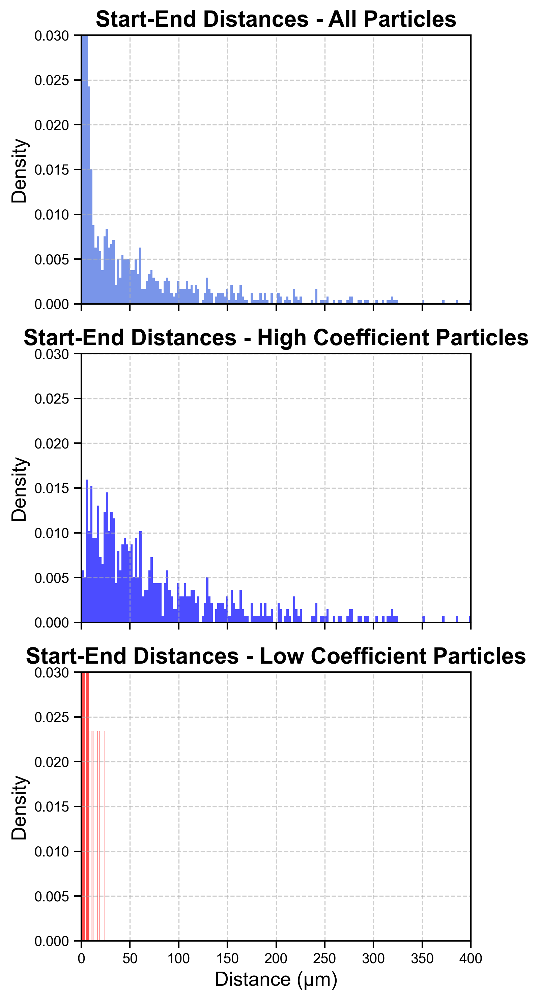

In [197]:
# Plot Histograms of Start-End Distances
def plot_histograms(start_end, PART_COEF_SUP, PART_COEF_INF, IMG_TYPE):
    fig, axes = plt.subplots(3, 1, figsize=(5, 10), sharex=True, sharey=True)
    axes[0].hist(metrics_df['start_end_distance [um]'], bins=250, color='royalblue', alpha=0.7, density=True)
    axes[0].set_xlim([0, 400])
    axes[0].set_ylim([0, 0.03])
    axes[0].set_title('Start-End Distances - All Particles', fontsize=16)
    axes[0].set_ylabel('Density', fontsize=14)
    axes[0].grid(True, linestyle='--', alpha=0.6)

    axes[1].hist(metrics_df[metrics_df['particle'].isin(PART_COEF_SUP)][['start_end_distance [um]']], bins=250, color='blue', alpha=0.7, density=True)
    axes[1].set_xlim([0, 400])
    axes[1].set_title('Start-End Distances - High Coefficient Particles', fontsize=16)
    axes[1].set_ylabel('Density', fontsize=14)
    axes[1].grid(True, linestyle='--', alpha=0.6)

    axes[2].hist(metrics_df[metrics_df['particle'].isin(PART_COEF_INF)][['start_end_distance [um]']], bins=250, color='red', alpha=0.7, density=True)
    axes[2].set_xlim([0, 400])
    axes[2].set_title('Start-End Distances - Low Coefficient Particles', fontsize=16)
    axes[2].set_xlabel('Distance (μm)', fontsize=14)
    axes[2].set_ylabel('Density', fontsize=14)
    axes[2].grid(True, linestyle='--', alpha=0.6)

    plt.tight_layout()
    plt.savefig(os.path.join(path_save_pic, f"Nstart_end inf supp and all.{IMG_TYPE}"), format=IMG_TYPE)
    plt.show()

plot_histograms(start_end, PART_COEF_SUP, PART_COEF_INF, IMG_TYPE=IMG_TYPE)

In [198]:
# Compute Angle Changes between Directions
def compute_angle_changes(DATA, PART_COEF_SUP, PART_COEF_INF):
    def angle_between_directions(row):
        dx1, dy1 = row['dir_x'], row['dir_y']
        dx2, dy2 = row['dir_x_next'], row['dir_y_next']
        angle_initial = np.arctan2(dy1, dx1)
        angle_final = np.arctan2(dy2, dx2)
        angle_change = angle_final - angle_initial
        angle_change = (angle_change + np.pi) % (2 * np.pi) - np.pi
        return np.degrees(angle_change)

    df_sup = DATA[DATA['particle'].isin(PART_COEF_SUP)].copy()
    df_sup.sort_values(by=['particle', 'frame'], inplace=True)
    df_sup['dir_x'] = df_sup.groupby('particle')['x'].diff().fillna(0)
    df_sup['dir_y'] = df_sup.groupby('particle')['y'].diff().fillna(0)
    df_sup['dir_x_next'] = df_sup.groupby('particle')['dir_x'].shift(-1)
    df_sup['dir_y_next'] = df_sup.groupby('particle')['dir_y'].shift(-1)
    df_sup['angle_change'] = df_sup.apply(angle_between_directions, axis=1)
    df_sup.dropna(subset=['dir_x_next', 'dir_y_next'], inplace=True)

    df_inf = DATA[DATA['particle'].isin(PART_COEF_INF)].copy()
    df_inf.sort_values(by=['particle', 'frame'], inplace=True)
    df_inf['dir_x'] = df_inf.groupby('particle')['x'].diff().fillna(0)
    df_inf['dir_y'] = df_inf.groupby('particle')['y'].diff().fillna(0)
    df_inf['dir_x_next'] = df_inf.groupby('particle')['dir_x'].shift(-1)
    df_inf['dir_y_next'] = df_inf.groupby('particle')['dir_y'].shift(-1)
    df_inf['angle_change'] = df_inf.apply(angle_between_directions, axis=1)
    df_inf.dropna(subset=['dir_x_next', 'dir_y_next'], inplace=True)

    return df_sup, df_inf

df_sup, df_inf = compute_angle_changes(DATA, PART_COEF_SUP, PART_COEF_INF)

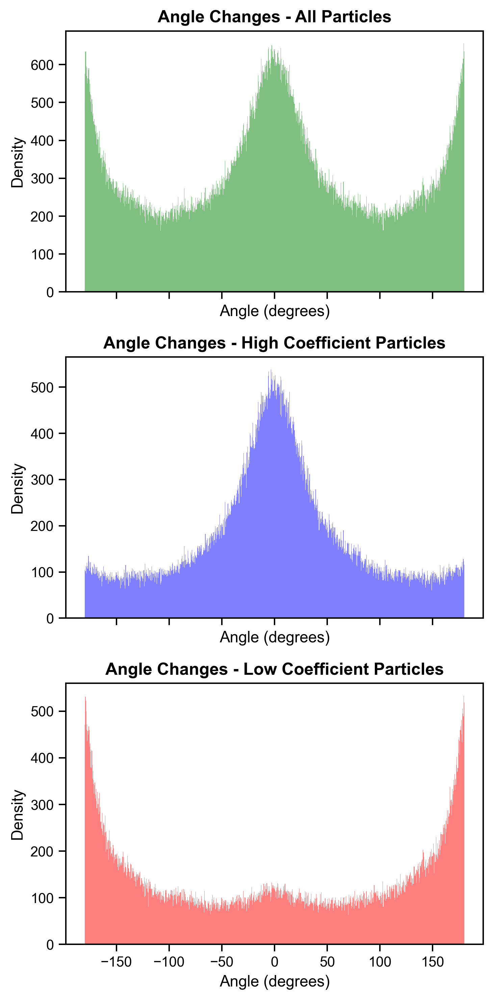

In [199]:
# Plot histograms of angle changes
def plot_angle_histograms(df_all, df_sup, df_inf, img_type='svg'):
    fig, axes = plt.subplots(3, 1, figsize=(5, 10), sharex=True)
    axes[0].hist(df_all['angle_change'], bins=1000, alpha=0.5, color='green')
    axes[0].set_title('Angle Changes - All Particles')
    axes[0].set_xlabel('Angle (degrees)')
    axes[0].set_ylabel('Density')

    axes[1].hist(df_sup['angle_change'], bins=1000, color='blue', alpha=0.5)
    axes[1].set_title('Angle Changes - High Coefficient Particles')
    axes[1].set_xlabel('Angle (degrees)')
    axes[1].set_ylabel('Density')

    axes[2].hist(df_inf['angle_change'], bins=1000, color='red', alpha=0.5)
    axes[2].set_title('Angle Changes - Low Coefficient Particles')
    axes[2].set_xlabel('Angle (degrees)')
    axes[2].set_ylabel('Density')

    plt.tight_layout()
    plt.show()
    
    fig.savefig(os.path.join(path_save_pic, f'Angle_Changes_Histograms.{img_type}'), format=img_type)

df_all = pd.concat([df_sup, df_inf])
plot_angle_histograms(df_all, df_sup, df_inf, img_type=IMG_TYPE)

In [200]:
def plot_mean_vit_histograms_comparison(metrics_df, part_coef_sup, part_coef_inf, alpha=0.5, path_save_pic=None, img_type='png'):
    """
    Trace sur le même graphique les histogrammes des mean_vit_inst [um/min]
    pour les particules avec coefficients supérieurs et inférieurs.

    Parameters:
    - metrics_df (DataFrame): DataFrame contenant les données, avec une colonne 'mean_vit_inst [um/min]'.
    - part_coef_sup (list): Liste des particules avec coefficients supérieurs.
    - part_coef_inf (list): Liste des particules avec coefficients inférieurs.
    - path_save_pic (str, optional): Chemin pour sauvegarder l'image. Si None, l'image ne sera pas sauvegardée.
    - img_type (str, optional): Format de l'image pour la sauvegarde (par défaut 'png').

    Returns:
    None
    """
    # Vérification de la présence de la colonne nécessaire
    if 'mean_vit_inst [um/min]' not in metrics_df.columns:
        raise ValueError("La colonne 'mean_vit_inst [um/min]' est absente de metrics_df.")
    
    # Filtrer les données
    df_sup = metrics_df[metrics_df['particle'].isin(part_coef_sup)]
    df_inf = metrics_df[metrics_df['particle'].isin(part_coef_inf)]
    
    median_value_sup = df_sup['median_vit_inst [um/min]'].median()
    median_value_inf = df_inf['median_vit_inst [um/min]'].median()

    # Préparer le graphique
    plt.figure(figsize=(10, 10))
    plt.hist(df_sup['median_vit_inst [um/min]'], bins=100, color='blue', alpha=alpha, label="hight slope", density=True)
    plt.hist(df_inf['median_vit_inst [um/min]'], bins=100, color='red', alpha=alpha, label="low slope", density=True)

     # Ajouter une barre verticale à la médiane
    plt.axvline(median_value_inf, color='red', linestyle='--', linewidth=2, label=f'Median: {median_value_inf:.2f} μm/min')
    plt.axvline(median_value_sup, color='blue', linestyle='--', linewidth=2, label=f'Median: {median_value_sup:.2f} μm/min')


    # Ajouter des titres et des légendes
    plt.title("Median speed [μm/min]", fontsize=14)
    plt.xlabel("Median Instantaneous Velocity [μm/min]", fontsize=12)
    plt.ylabel("Density", fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.6)
    plt.legend(fontsize=12)
    
    # Sauvegarde de l'image si un chemin est spécifié
    if path_save_pic:
        save_path = os.path.join(path_save_pic, f'Median_Velocity_Histograms_Comparison.{img_type}')
        plt.savefig(save_path, format=img_type)
        print(f"Plot sauvegardé à : {save_path}")
    
    # Afficher le graphique
    plt.tight_layout()
    plt.show()

Plot sauvegardé à : /Users/souchaud/Desktop/Analyses/résultats_CytoOne_HL5_10x_results_tracking_All/Median_Velocity_Histograms_Comparison.png


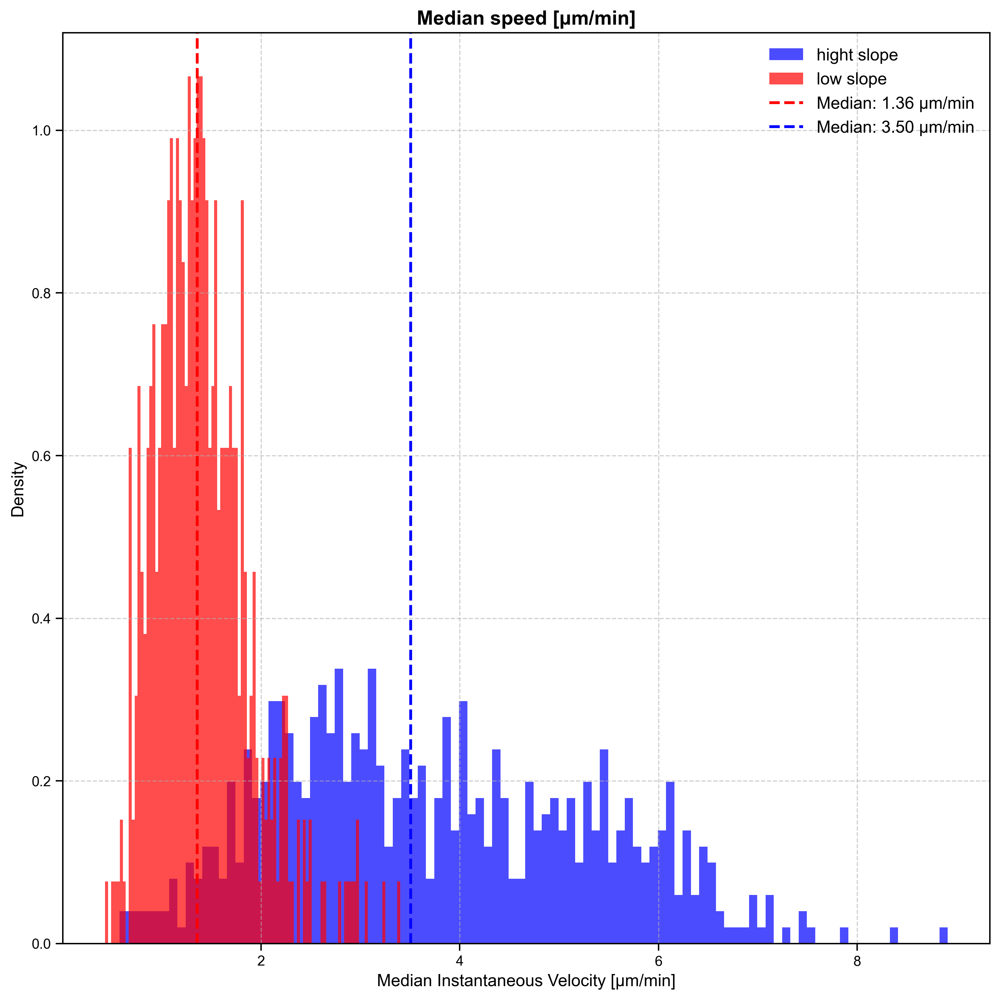

In [201]:
plot_mean_vit_histograms_comparison(metrics_df, PART_COEF_SUP, PART_COEF_INF, path_save_pic=path_save_pic, img_type=IMG_TYPE, alpha=0.7)

In [202]:
DATA

,index,y,x,mass,size,ecc,signal,raw_mass,ep,frame,...,dy [pix],displacement [pix],VitInst [um/min],time to incubation (hours),cluster,Xc [pix],Yc [pix],cumulative displacement [um],is_inf,is_sup
0,170388,5625.728444,4765.603739,387.725589,3.341434,0.038744,7.671463,11168.0,54.914944,0,...,NaN,NaN,NaN,26.12,0,0.000000,0.000000,NaN,1,0
55520,322926,2578.458967,6408.943472,1002.597545,4.476160,0.030403,10.788352,29713.0,0.037385,0,...,NaN,NaN,NaN,66.67,0,0.000000,0.000000,NaN,0,1
266761,1520435,4373.363687,2513.057671,594.334331,3.829961,0.270315,10.823970,20143.0,0.408621,0,...,NaN,NaN,NaN,71.83,0,0.000000,0.000000,NaN,1,0
267101,1524764,121.758002,819.109173,17327.143489,15.187508,0.178763,33.437489,358615.0,0.392048,0,...,NaN,NaN,NaN,0.00,1,0.000000,0.000000,NaN,0,1
54960,321084,3683.744548,3360.786118,1477.572737,4.069382,0.115447,21.720549,27207.0,0.047432,0,...,NaN,NaN,NaN,66.67,0,0.000000,0.000000,NaN,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
116461,716191,4463.086074,57.213669,586.454513,3.917656,0.344269,10.396674,19004.0,0.389990,339,...,-0.270637,0.584322,1.488852,70.92,0,-1.626595,-0.931419,84.216761,1,0
150317,933420,2698.932419,275.142163,974.271542,4.331987,0.259577,11.692929,28162.0,0.105361,339,...,-0.663995,1.915633,4.881033,21.08,0,-1.543331,-3.420275,206.625991,1,0
255764,1471340,5317.853631,2695.780218,2511.066853,4.480497,0.094256,23.474051,35058.0,0.039700,339,...,-0.030917,0.171438,0.436823,76.67,0,-0.736235,0.150949,158.580969,1,0
25081,200091,8126.205867,4256.332190,9818.321414,14.725386,0.035740,21.421886,111714.0,0.230551,339,...,0.404114,0.469535,1.196375,23.58,1,18.493639,-13.594602,234.280416,0,1


In [203]:
def plot_vit_inst_histograms_comparison(metrics_df, part_coef_sup, part_coef_inf, alpha=0.5, path_save_pic=None, img_type='png'):
    """
    Trace sur le même graphique les histogrammes des mean_vit_inst [um/min]
    pour les particules avec coefficients supérieurs et inférieurs.

    Parameters:
    - metrics_df (DataFrame): DataFrame contenant les données, avec une colonne 'mean_vit_inst [um/min]'.
    - part_coef_sup (list): Liste des particules avec coefficients supérieurs.
    - part_coef_inf (list): Liste des particules avec coefficients inférieurs.
    - path_save_pic (str, optional): Chemin pour sauvegarder l'image. Si None, l'image ne sera pas sauvegardée.
    - img_type (str, optional): Format de l'image pour la sauvegarde (par défaut 'png').

    Returns:
    None
    """
    # Vérification de la présence de la colonne nécessaire
    if 'mean_vit_inst [um/min]' not in metrics_df.columns:
        raise ValueError("La colonne 'mean_vit_inst [um/min]' est absente de metrics_df.")
    
    # Filtrer les données
    df_sup = DATA[DATA['particle'].isin(part_coef_sup)]
    df_inf = DATA[DATA['particle'].isin(part_coef_inf)]
    
    instant_value_sup = df_sup['VitInst [um/min]']
    instant_value_inf = df_inf['VitInst [um/min]']

    # Préparer le graphique
    plt.figure(figsize=(10, 10))
    plt.hist(df_sup['VitInst [um/min]'], bins=100, color='blue', alpha=alpha, label="hight slope", density=True)
    plt.hist(df_inf['VitInst [um/min]'], bins=100, color='red', alpha=alpha, label="low slope", density=True)

    #  # Ajouter une barre verticale à la médiane
    # plt.axvline(median_value_inf, color='red', linestyle='--', linewidth=2, label=f'Median: {median_value_inf:.2f} μm/min')
    # plt.axvline(median_value_sup, color='blue', linestyle='--', linewidth=2, label=f'Median: {median_value_sup:.2f} μm/min')


    # Ajouter des titres et des légendes
    plt.title("Median speed [μm/min]", fontsize=14)
    plt.xlabel("Median Instantaneous Velocity [μm/min]", fontsize=12)
    plt.ylabel("Density", fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.6)
    plt.legend(fontsize=12)
    
    # Sauvegarde de l'image si un chemin est spécifié
    if path_save_pic:
        save_path = os.path.join(path_save_pic, f'Inst_Velocity_Histograms_Comparison.{img_type}')
        plt.savefig(save_path, format=img_type)
        print(f"Plot sauvegardé à : {save_path}")
    
    # Afficher le graphique
    plt.tight_layout()
    plt.show()

Plot sauvegardé à : /Users/souchaud/Desktop/Analyses/résultats_CytoOne_HL5_10x_results_tracking_All/Inst_Velocity_Histograms_Comparison.png


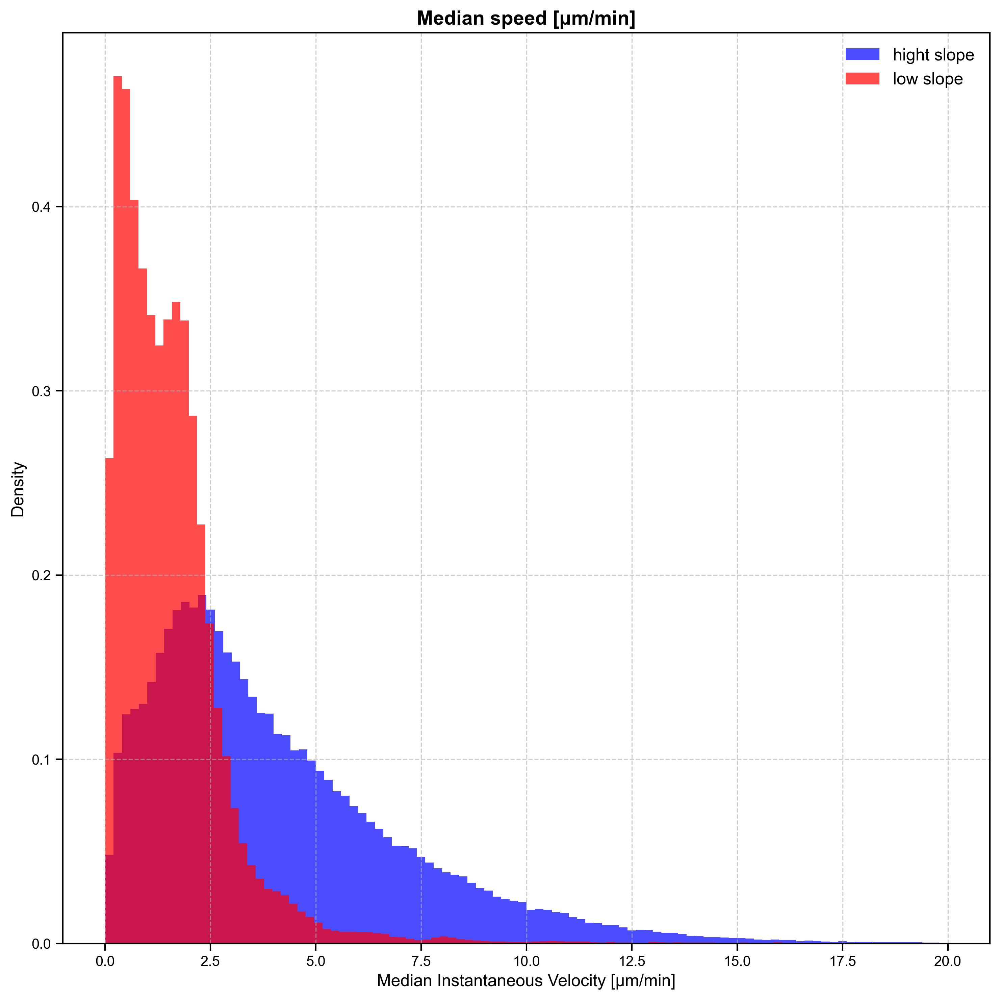

In [204]:
plot_vit_inst_histograms_comparison(metrics_df, PART_COEF_SUP, PART_COEF_INF, path_save_pic=path_save_pic, img_type=IMG_TYPE, alpha=0.7)

In [205]:
vmax = 20  # µm/min
DATA_filt = DATA[DATA['VitInst [um/min]'] > vmax]

In [206]:
vmax = 20  # seuil en µm/min

# Filtrage des vitesses > 20 µm/min
DATA_highspeed = DATA[DATA['VitInst [um/min]'] > vmax]

# Comptage du nombre de vitesses > 20 pour chaque cellule
counts_highspeed = DATA_highspeed.groupby('particle').size().rename('n_frames_VitInst_sup20')

# Pour l’avoir dans un DataFrame (éventuellement fusionnable)
counts_highspeed_df = counts_highspeed.reset_index()

In [207]:
counts_highspeed_df

,particle,n_frames_VitInst_sup20


In [208]:
DATA['particle'].nunique()

1045

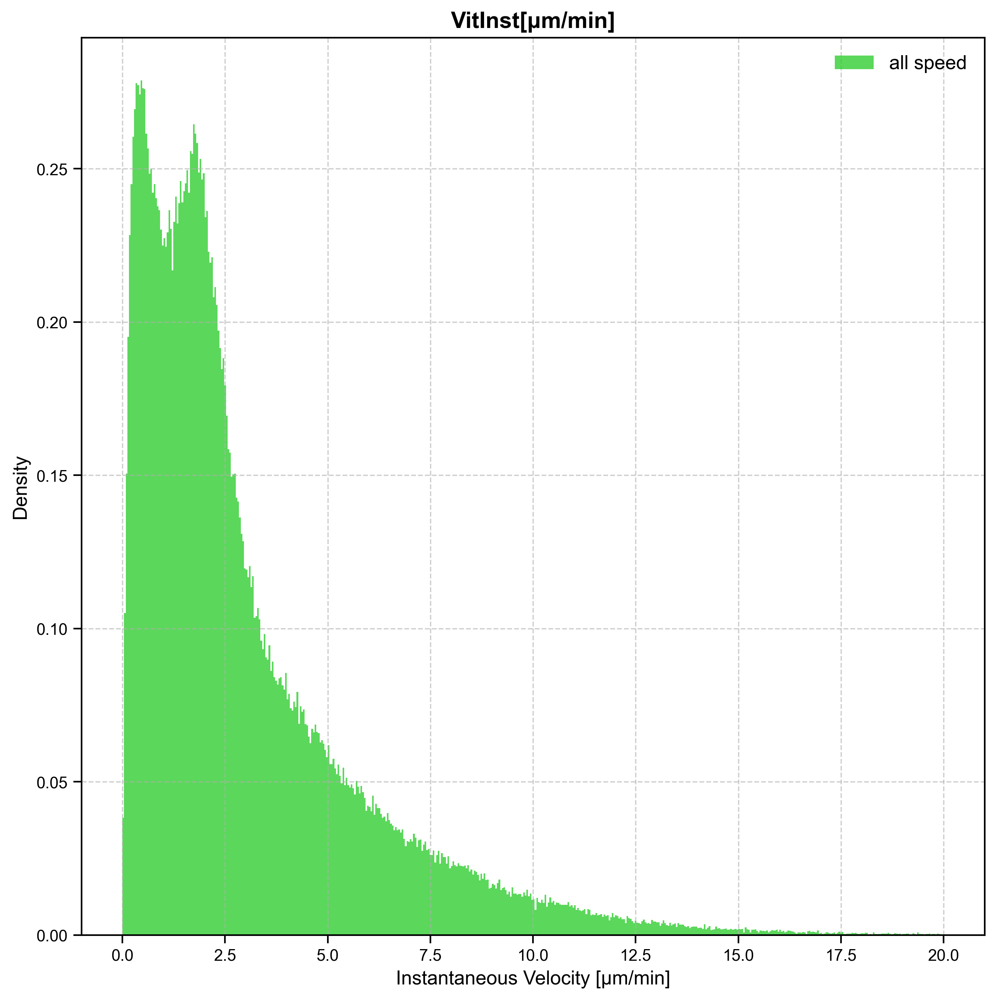

In [209]:
# Préparer le graphique
plt.figure(figsize=(10, 10))
plt.hist(DATA['VitInst [um/min]'], bins=500, color='limegreen', alpha=0.8, label="all speed", density=True)

# Ajouter une barre verticale à la médiane
# plt.axvline(median_value, color='red', linestyle='--', linewidth=2, label=f'Median: {median_value:.2f} μm/min')

# Ajouter des titres et des légendes
plt.title("VitInst[μm/min]", fontsize=14)
plt.xlabel("Instantaneous Velocity [μm/min]", fontsize=12)
plt.ylabel("Density", fontsize=12)
plt.grid(True, linestyle='--', alpha=0.6)
plt.legend(fontsize=12)

In [210]:
def plot_mean_vit_histograms_comparison(metrics_df, path_save_pic=None, img_type='png', alpha=0.7):
    """
    Trace sur le même graphique les histogrammes des mean_vit_inst [um/min]
    pour les particules avec coefficients supérieurs et inférieurs.

    Parameters:
    - metrics_df (DataFrame): DataFrame contenant les données, avec une colonne 'mean_vit_inst [um/min]'.
    - path_save_pic (str, optional): Chemin pour sauvegarder l'image. Si None, l'image ne sera pas sauvegardée.
    - img_type (str, optional): Format de l'image pour la sauvegarde (par défaut 'png').

    Returns:
    None
    """
    # Vérification de la présence de la colonne nécessaire
    if 'median_vit_inst [um/min]' not in metrics_df.columns:
        raise ValueError("La colonne 'median_vit_inst [um/min]' est absente de metrics_df.")
    
    # Calcul de la médiane
    median_value = metrics_df['median_vit_inst [um/min]'].median()
    print(f"Median value: {median_value}")

    # Préparer le graphique
    plt.figure(figsize=(10, 10))
    plt.hist(metrics_df['median_vit_inst [um/min]'], bins=100, color='limegreen', alpha=alpha, label="all speed", density=True)

    # Ajouter une barre verticale à la médiane
    plt.axvline(median_value, color='red', linestyle='--', linewidth=2, label=f'Median: {median_value:.2f} μm/min')

    # Ajouter des titres et des légendes
    plt.title("Median speed [μm/min]", fontsize=14)
    plt.xlabel("Median Instantaneous Velocity [μm/min]", fontsize=12)
    plt.ylabel("Density", fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.6)
    plt.legend(fontsize=12)
    
    # Sauvegarde de l'image si un chemin est spécifié
    if path_save_pic:
        save_path = os.path.join(path_save_pic, f'Median_Velocity_Histograms_all.{img_type}')
        plt.savefig(save_path, format=img_type)
        print(f"Plot sauvegardé à : {save_path}")
    
    # Afficher le graphique
    # Sans tight_layout (les titres peuvent se chevaucher)
    plt.tight_layout()  # Ajuste automatiquement l'espacement
    plt.show()

Median value: 2.1980201627841556
Plot sauvegardé à : /Users/souchaud/Desktop/Analyses/résultats_CytoOne_HL5_10x_results_tracking_All/Median_Velocity_Histograms_all.png


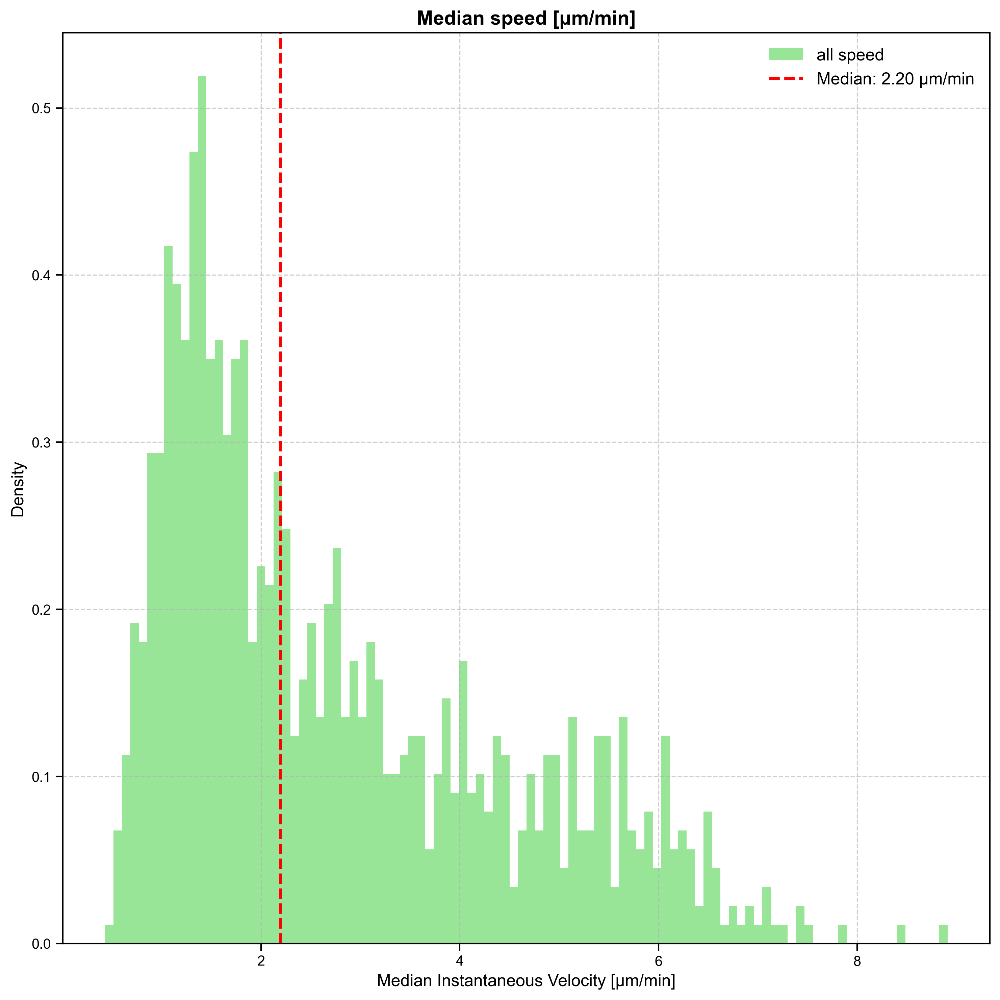

In [211]:
plot_mean_vit_histograms_comparison(metrics_df, path_save_pic=path_save_pic, img_type=IMG_TYPE, alpha=0.5)

In [212]:
import os
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import colormaps

def plot_velocity_histograms(all_metrics_df, metrics_df, path_save_pic, img_type):
    """
    Plot histograms of median instantaneous velocities for each experiment, sorted by incubation time.

    Parameters:
    - all_metrics_df (DataFrame): Aggregated metrics per experiment.
    - metrics_df (DataFrame): Metrics for each particle and experiment.
    - path_save_pic (str): Path where the plot will be saved.
    - img_type (str): Image format for saving the plot.
    """
    # Trier les expériences par temps d'incubation
    exp_hours = all_metrics_df[['experiment', 'time to incubation (hours)']].sort_values(by='time to incubation (hours)')
    experiments = exp_hours['experiment'].tolist()
    incubation_times = exp_hours['time to incubation (hours)'].tolist()

    # Déterminer les bornes de l'axe X
    global_min = metrics_df['median_vit_inst [um/min]'].min()
    global_max = metrics_df['median_vit_inst [um/min]'].max()
    delta = (global_max - global_min) * 0.1  # Ajouter 10% de marge pour l'affichage
    global_min -= delta
    global_max += delta

    # Liste pour stocker les médianes des vitesses moyennes instantanées
    median_values_list = []

    # Nombre d'expériences à afficher
    n_experiments = len(experiments)
    fig, axes = plt.subplots(nrows=n_experiments, ncols=1, figsize=(10, 2 * n_experiments), sharex=True, sharey=True)

    if n_experiments == 1:
        axes = [axes]  # S'assurer que 'axes' est une liste si un seul subplot

    # Palette de couleurs
    palette = colormaps['tab20']
    colors = [palette(i / n_experiments) for i in range(n_experiments)]

    # Boucle sur chaque expérience
    for idx, ax in enumerate(axes):
        exp = experiments[idx]
        hour = incubation_times[idx]

        # Filtrer les données pour cette expérience
        data_exp = metrics_df[metrics_df['experiment'] == exp]
        num_particles = len(data_exp)  # Nombre de particules dans cette expérience

        # Calculer la médiane des vitesses moyennes instantanées pour cette expérience
        median_value = data_exp['median_vit_inst [um/min]'].median()
        median_values_list.append(median_value)  # Stocker la médiane

        # Tracer l'histogramme
        ax.hist(data_exp['median_vit_inst [um/min]'], bins=30, alpha=0.3, range=(global_min, global_max), color=colors[idx])

        # Ajouter titre et labels
        ax.set_title(f'Vit. Inst. Mediane [μm/min] - {exp} (Incubation: {hour}h)')
        ax.set_xlabel('VitInst [μm/min]')
        ax.set_ylabel('Nombre de particules')

        # Ajouter la médiane avec une ligne verticale rouge
        ax.axvline(median_value, color='red', linestyle='dashed', linewidth=1)
        ax.text(
            median_value + 0.05 * (global_max - global_min), 
            # ax.get_ylim()[1] * 0.95,
            75,
            f'Médiane: {median_value:.2f}',
            color='red',
            ha='left'
        )

        # Ajouter le nombre total de particules sur le graphique
        ax.text(
            global_max - 0.1 * (global_max - global_min),  # Position X
            # ax.get_ylim()[1] * 0.85,  # Position Y (haut du graphe)
            75,
            f'Nb Particules: {num_particles}',
            color='black',
            ha='right',
            fontsize=10,
            bbox=dict(facecolor='white', alpha=0.5, edgecolor='black')
        )

        # Ajuster les limites de l'axe X
        ax.set_xlim(global_min, global_max)

    # Calculer la moyenne et la médiane des médianes enregistrées
    overall_median_of_medians = np.median(median_values_list)
    overall_mean_of_medians = np.mean(median_values_list)

    # Afficher les résultats finaux
    print(f"Médiane globale des médianes : {overall_median_of_medians:.2f} μm/min")
    print(f"Moyenne globale des médianes : {overall_mean_of_medians:.2f} μm/min")

    # Ajuster l'affichage et sauvegarder la figure
    plt.tight_layout()
    fig_path = os.path.join(path_save_pic, f'Velocity_Histograms.{img_type}')
    fig.savefig(fig_path, format=img_type)
    plt.show()
    
    print(f"Plot saved to {fig_path}")

    return overall_median_of_medians, overall_mean_of_medians  # Retourner ces valeurs si besoin

In [213]:
# plot_velocity_histograms(all_mean_vitinst, medians, exp_hours, path_save_pic, IMG_TYPE)
plot_velocity_histograms(all_metrics_df, metrics_df, path_save_pic, IMG_TYPE)

Médiane globale des médianes : 1.61 μm/min
Moyenne globale des médianes : 2.24 μm/min


/var/folders/sk/m9jkmr4n1k5dqc3wj_f53p4r0000gp/T/ipykernel_2906/4096666321.py:98: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  plt.tight_layout()


Plot saved to /Users/souchaud/Desktop/Analyses/résultats_CytoOne_HL5_10x_results_tracking_All/Velocity_Histograms.png


(1.6056174790225686, 2.24318787319064)

###
<center><span style="color: skyblue; font-size: 20px"> Calcul de l'autocorrelation de la vitesse </span></center>


Fit exponnentiel de l'autocorrelation de la vitesse

<center><span style="color: skyblue; font-size: 20px"> Mean speed vs time to incubation </span></center>


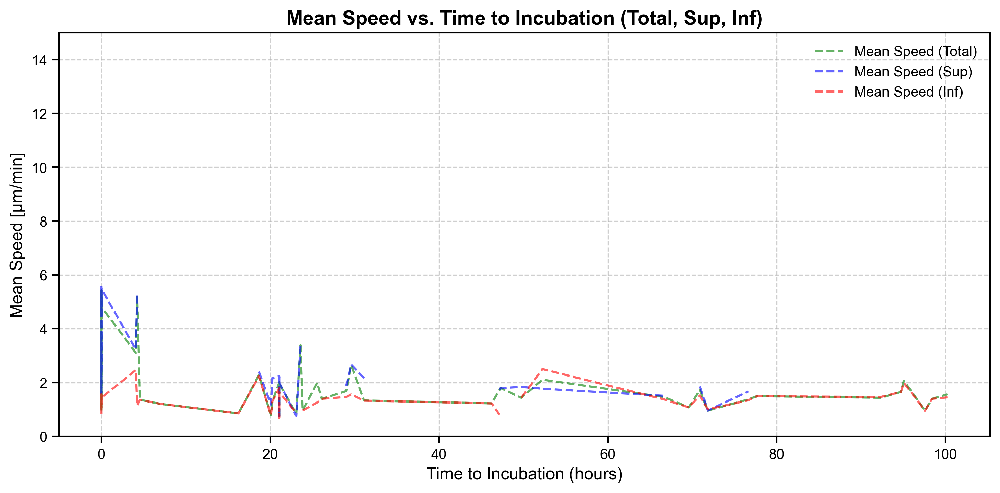

Plot saved to /Users/souchaud/Desktop/Analyses/résultats_CytoOne_HL5_10x_results_tracking_All/Mean_Speed_vs_Time_Sup_Inf.png


In [214]:
def plot_mean_speed_with_sup_inf(all_metrics_df, path_save_pic, xlim: list = None):
    """
    Plot mean speed, mean speed sup, and mean speed inf as a function of incubation time
    on the same graph.

    Parameters:
    - all_metrics_df (DataFrame): DataFrame containing aggregated metrics for each experiment.
                                  Must include columns: 'time to incubation (hours)',
                                  'mean_speed [um/min]', 'mean_speed_sup [um/min]', 
                                  and 'mean_speed_inf [um/min]'.
    - path_save_pic (str): Path where the plot will be saved.
    - xlim (list, optional): Limit for the x-axis.

    Returns:
    None
    """
    # Trier les données par temps d'incubation
    all_metrics_sorted = all_metrics_df.sort_values(by='time to incubation (hours)')

    # Préparer le tracé
    plt.figure(figsize=(10, 5))

    # Courbe pour la vitesse moyenne totale
    plt.plot(
        all_metrics_sorted['time to incubation (hours)'],
        all_metrics_sorted['mean_speed [um/min]'],
        linestyle='--', color='green', alpha=0.6,
        label='Mean Speed (Total)'
    )

    # Courbe pour les particules sup
    plt.plot(
        all_metrics_sorted['time to incubation (hours)'],
        all_metrics_sorted['mean_speed_sup [um/min]'],
        linestyle='--', color='blue', alpha=0.6,
        label='Mean Speed (Sup)'
    )

    # Courbe pour les particules inf
    plt.plot(
        all_metrics_sorted['time to incubation (hours)'],
        all_metrics_sorted['mean_speed_inf [um/min]'],
        linestyle='--', color='red', alpha=0.6,
        label='Mean Speed (Inf)'
    )

    # Ajouter des labels et des titres
    plt.title('Mean Speed vs. Time to Incubation (Total, Sup, Inf)', fontsize=14)
    plt.xlabel('Time to Incubation (hours)', fontsize=12)
    plt.ylabel('Mean Speed [μm/min]', fontsize=12)
    plt.ylim([0, 15])  # Limites pour l'axe des y
    if xlim:
        plt.xlim(xlim)  # Limites pour l'axe des x (optionnel)
    plt.grid(True, linestyle='--', alpha=0.6)
    plt.legend(fontsize=10)

    # Sauvegarder et afficher
    plt.tight_layout()
    fig_path = os.path.join(path_save_pic, 'Mean_Speed_vs_Time_Sup_Inf.png')
    plt.savefig(fig_path, format='png')
    plt.show()

    print(f"Plot saved to {fig_path}")

# Exemple d'appel de la fonction
plot_mean_speed_with_sup_inf(all_metrics_df, path_save_pic)

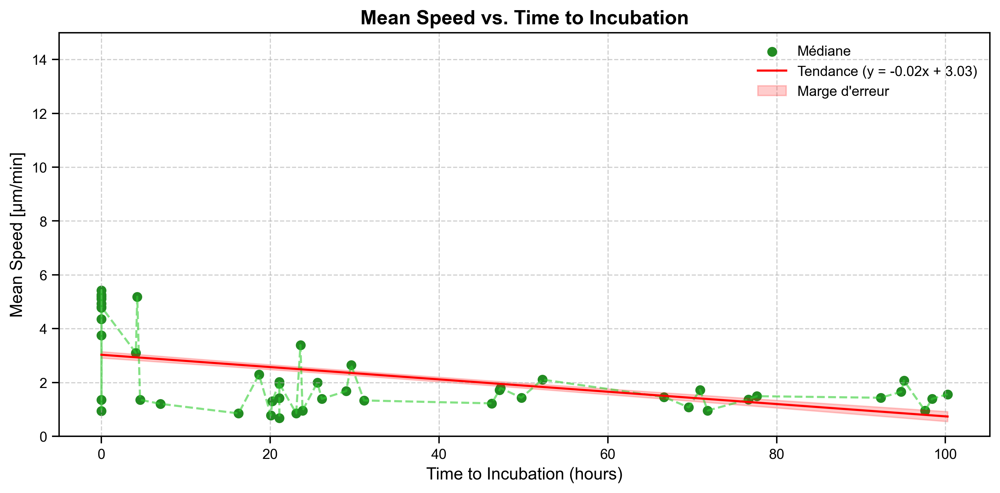

Plot saved to /Users/souchaud/Desktop/Analyses/résultats_CytoOne_HL5_10x_results_tracking_All/Mean_Speed_vs_Time_with_Trendline_and_ErrorBand.png


In [215]:
def plot_median_velocity_vs_time(all_metrics_df, path_save_pic, xlim: list = None):
    """
    Plot median velocities as a function of incubation time using all_metrics_df.
    Adds a trendline with a transparent error band to the data.

    Parameters:
    - all_metrics_df (DataFrame): DataFrame containing aggregated metrics for each experiment.
    - path_save_pic (str): Path where the plot will be saved.
    - xlim (list, optional): Limit for the x-axis.
    """
    # Trier les données par temps d'incubation
    all_metrics_sorted = all_metrics_df.sort_values(by='time to incubation (hours)')

    # Extraire les données
    x = all_metrics_sorted['time to incubation (hours)'].values
    y = all_metrics_sorted['mean_speed [um/min]'].values

    # Préparer le tracé
    plt.figure(figsize=(10, 5))
    plt.scatter(x, y, color='forestgreen', label='Médiane')  # Points
    plt.plot(x, y, linestyle='--', color='limegreen', alpha=0.6)  # Ligne connectant les points

    # Régression linéaire (y = ax + b)
    slope, intercept, r_value, p_value, std_err = linregress(x, y)
    trendline = slope * x + intercept

    # Calcul de la zone d'erreur
    error_band = 100*std_err * np.sqrt(1 / len(x) + (x - np.mean(x))**2 / np.sum((x - np.mean(x))**2))
    # Ajouter la ligne de tendance
    plt.plot(x, trendline, color='red', label=f"Tendance (y = {slope:.2f}x + {intercept:.2f})", linestyle='-', linewidth=1.5)

    # Ajouter l'aire d'erreur
    plt.fill_between(x, trendline - error_band, trendline + error_band, color='red', alpha=0.2, label="Marge d'erreur")

    # Ajouter des labels et des titres
    plt.title('Mean Speed vs. Time to Incubation', fontsize=14)
    plt.xlabel('Time to Incubation (hours)', fontsize=12)
    plt.ylabel('Mean Speed [μm/min]', fontsize=12)
    plt.ylim([0, 15])
    if xlim:
        plt.xlim(xlim)
    plt.grid(True, linestyle='--', alpha=0.6)
    plt.legend(fontsize=10)

    # Sauvegarder et afficher
    plt.tight_layout()
    fig_path = os.path.join(path_save_pic, 'Mean_Speed_vs_Time_with_Trendline_and_ErrorBand.png')
    plt.savefig(fig_path, format='png')
    plt.show()

    print(f"Plot saved to {fig_path}")

#utilisation
plot_median_velocity_vs_time(all_metrics_df, path_save_pic)

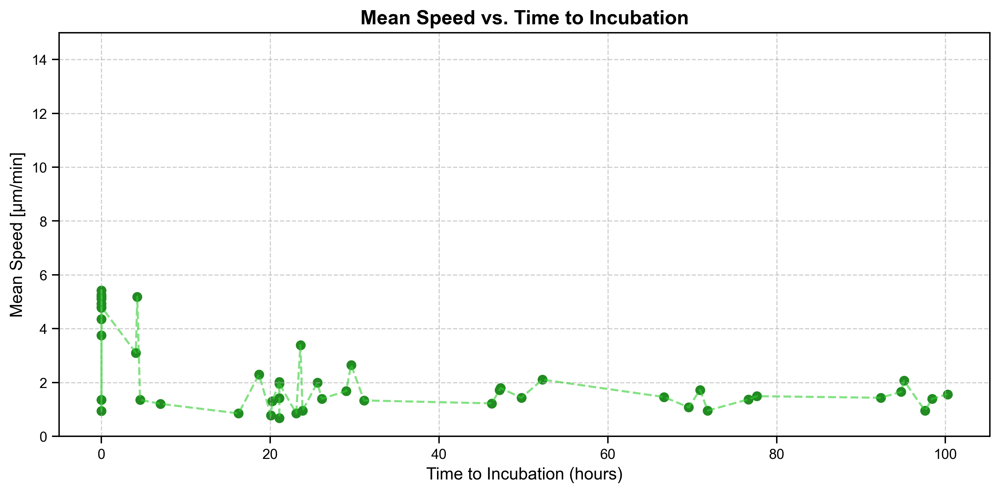

Plot saved to /Users/souchaud/Desktop/Analyses/résultats_CytoOne_HL5_10x_results_tracking_All/Mean_Speed_vs_Time.png


In [216]:
def plot_median_velocity_vs_time(all_metrics_df, path_save_pic, xlim: list = None):
    """
    Plot median velocities as a function of incubation time using all_metrics_df.

    Parameters:
    - all_metrics_df (DataFrame): DataFrame containing aggregated metrics for each experiment.
    - path_save_pic (str): Path where the plot will be saved.
    """
    # Trier les données par temps d'incubation
    all_metrics_sorted = all_metrics_df.sort_values(by='time to incubation (hours)')

    # Préparer le tracé
    plt.figure(figsize=(10, 5))
    plt.scatter(all_metrics_sorted['time to incubation (hours)'], 
                all_metrics_sorted['mean_speed [um/min]'],  # Correction de la colonne utilisée
                color='forestgreen', label='Médiane')
    plt.plot(all_metrics_sorted['time to incubation (hours)'], 
             all_metrics_sorted['mean_speed [um/min]'],  # Correction de la colonne utilisée
             linestyle='--', color='limegreen', alpha=0.6)

    # Ajouter des labels et des titres
    plt.title('Mean Speed vs. Time to Incubation', fontsize=14)
    plt.xlabel('Time to Incubation (hours)', fontsize=12)
    plt.ylim([0, 15])
    plt.ylabel('Mean Speed [μm/min]', fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.6)

    # Sauvegarder et afficher
    plt.tight_layout()
    fig_path = os.path.join(path_save_pic, 'Mean_Speed_vs_Time.png')
    plt.savefig(fig_path, format='png')
    plt.show()

    print(f"Plot saved to {fig_path}")

# Appel de la fonction corrigée
plot_median_velocity_vs_time(all_metrics_df, path_save_pic)

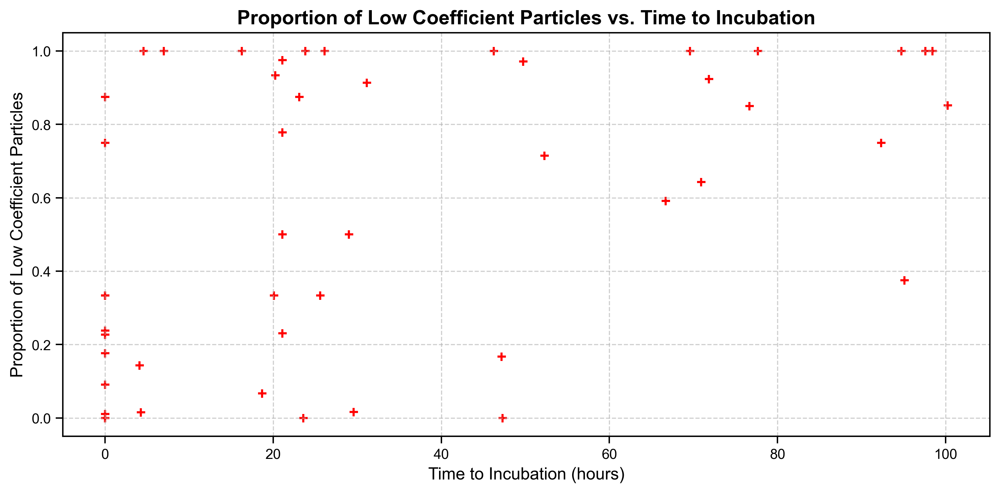

Plot saved to /Users/souchaud/Desktop/Analyses/résultats_CytoOne_HL5_10x_results_tracking_All/Proportion_Low_Coeff_Particles_vs_Time.png


In [217]:
def plot_proportion_vs_time(all_metrics_df, path_save_pic, img_type):
    """
    Plot the proportion of low coefficient particles (proportion_inf) vs. time to incubation.

    Parameters:
    - all_metrics_df (DataFrame): DataFrame containing aggregated metrics for each experiment.
    - path_save_pic (str): Path where the plot will be saved.
    - img_type (str): Image format for saving the plot.
    """
    # Trier les données par temps d'incubation
    all_metrics_sorted = all_metrics_df.sort_values(by='time to incubation (hours)')

    # Préparer le tracé
    plt.figure(figsize=(10, 5))
    plt.scatter(all_metrics_sorted['time to incubation (hours)'], 
                all_metrics_sorted['proportion_inf'], 
                color='red', marker='+', label='Proportion inf')
    
    # Ajouter des titres et des labels
    plt.title('Proportion of Low Coefficient Particles vs. Time to Incubation', fontsize=14)
    plt.xlabel('Time to Incubation (hours)', fontsize=12)
    plt.ylabel('Proportion of Low Coefficient Particles', fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.6)

    # Ajuster et sauvegarder
    plt.tight_layout()
    fig_path = os.path.join(path_save_pic, f'Proportion_Low_Coeff_Particles_vs_Time.{img_type}')
    plt.savefig(fig_path, format=img_type)
    plt.show()

    print(f"Plot saved to {fig_path}")

# Appel de la fonction
plot_proportion_vs_time(all_metrics_df, path_save_pic, IMG_TYPE)

/var/folders/sk/m9jkmr4n1k5dqc3wj_f53p4r0000gp/T/ipykernel_2906/1771416192.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  proportion_per_bin_inf = all_metrics_df.groupby('time_bin')['proportion_inf'].mean()


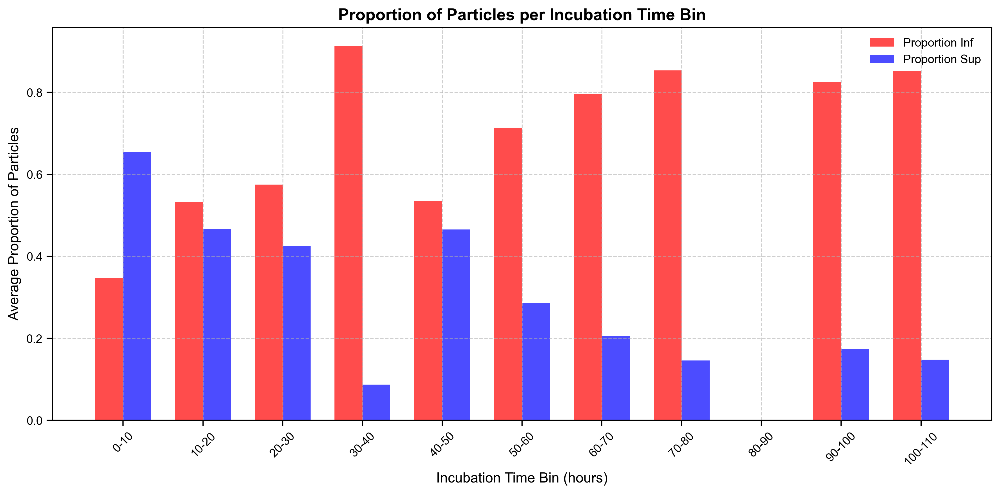

Plot saved to /Users/souchaud/Desktop/Analyses/résultats_CytoOne_HL5_10x_results_tracking_All/Proportion_vs_Time_Bins.png


In [218]:
def plot_proportion_per_time_bins(all_metrics_df, path_save_pic, img_type):
    """
    Plot proportions of particles (Inf and Sup) per incubation time bins.

    Parameters:
    - all_metrics_df (DataFrame): DataFrame containing aggregated metrics for each experiment.
    - path_save_pic (str): Path where the plot will be saved.
    - img_type (str): Image format for saving the plot.
    """
    # Définir les intervalles de temps d'incubation
    bins = np.arange(0, all_metrics_df['time to incubation (hours)'].max() + 10, 10)
    labels = [f"{int(left)}-{int(right)}" for left, right in zip(bins[:-1], bins[1:])]
    all_metrics_df['time_bin'] = pd.cut(all_metrics_df['time to incubation (hours)'], bins=bins, labels=labels, right=False)

    # Calculer les proportions moyennes pour chaque bin
    proportion_per_bin_inf = all_metrics_df.groupby('time_bin')['proportion_inf'].mean()
    proportion_per_bin_sup = 1 - proportion_per_bin_inf

    # Configuration des barres pour le tracé
    x = np.arange(len(proportion_per_bin_inf))
    width = 0.35

    # Tracé des proportions
    fig, ax = plt.subplots(figsize=(12, 6))
    ax.bar(x - width/2, proportion_per_bin_inf, width, color='red', alpha=0.7, label='Proportion Inf')
    ax.bar(x + width/2, proportion_per_bin_sup, width, color='blue', alpha=0.7, label='Proportion Sup')
    ax.set_title('Proportion of Particles per Incubation Time Bin', fontsize=14)
    ax.set_xlabel('Incubation Time Bin (hours)', fontsize=12)
    ax.set_ylabel('Average Proportion of Particles', fontsize=12)
    ax.set_xticks(x)
    ax.set_xticklabels(labels, rotation=45)
    ax.legend()
    plt.grid(True, linestyle='--', alpha=0.6)

    # Sauvegarder et afficher le graphique
    plt.tight_layout()
    fig_path = os.path.join(path_save_pic, f'Proportion_vs_Time_Bins.{img_type}')
    plt.savefig(fig_path, format=img_type)
    plt.show()

    print(f"Plot saved to {fig_path}")

# Appel de la fonction
plot_proportion_per_time_bins(all_metrics_df, path_save_pic, IMG_TYPE)

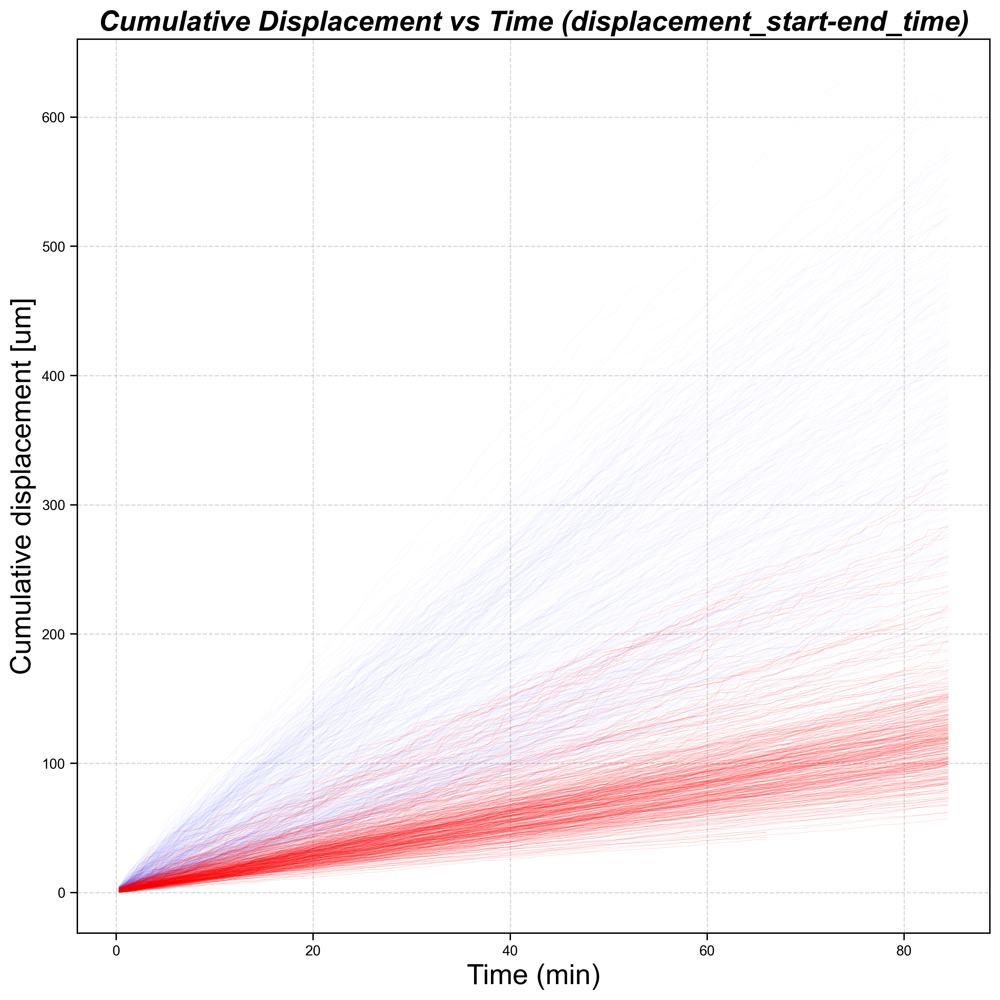

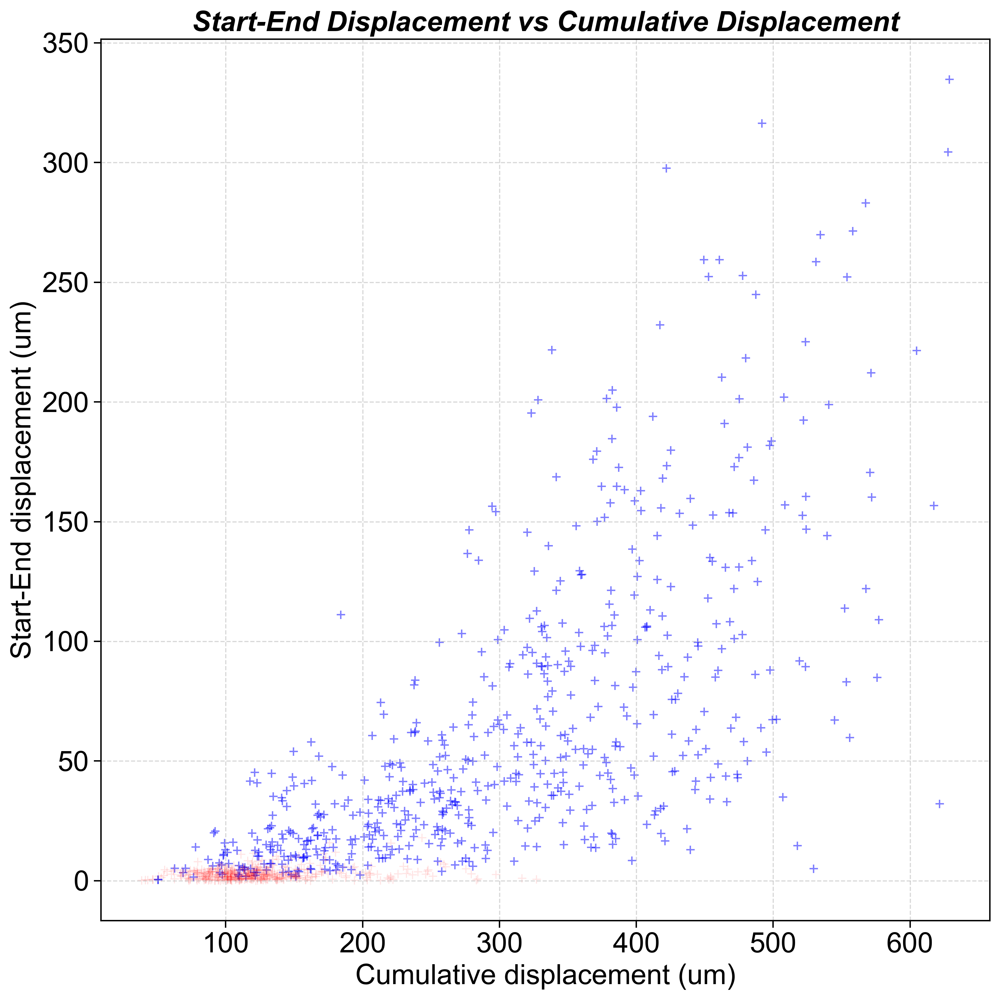

In [219]:
# Plot displacement comparison between low and high coefficient particles
lib.plot_displacement_low_and_high(
    traj_sup=df_sup,
    traj_inf=df_inf,
    part_coef_inf=PART_COEF_INF,
    part_coef_sup=PART_COEF_SUP,
    start_end=start_end,
    save=True,
    pathway_saving=path_save_pic,
    name="displacement_start-end_time",
    img_type=IMG_TYPE
)

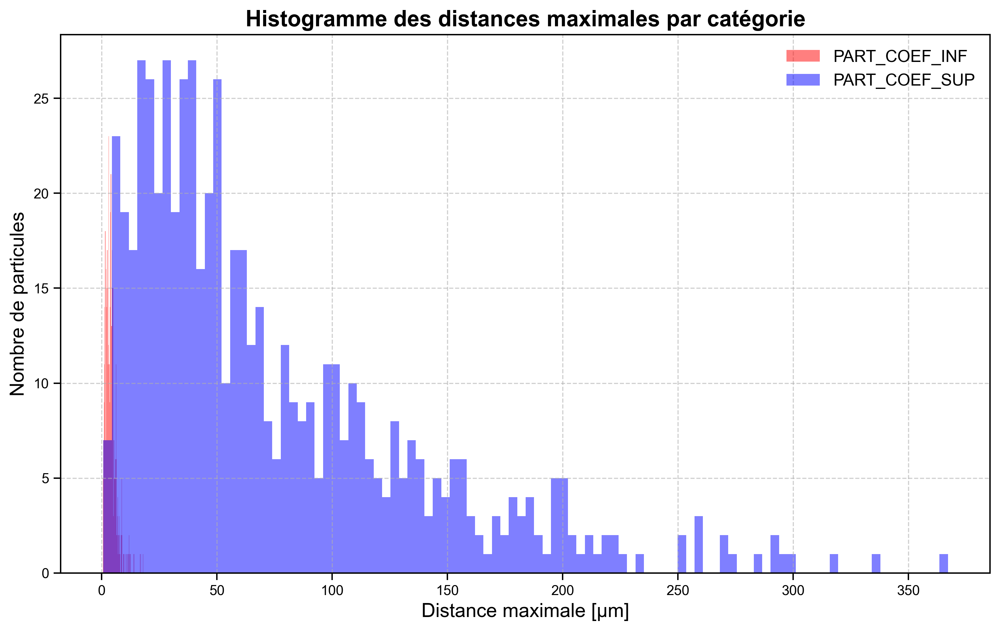

In [220]:
def max_displacement_from_start(traj, size_pix):
    """
    Calcule la distance maximale entre le point de départ et toutes les positions
    atteintes par chaque particule.

    Parameters
    ----------
    traj : pandas.DataFrame
        Trajectoire des particules avec colonnes 'x', 'y', 'particle'.
    size_pix : float
        Taille d'un pixel en micromètres.

    Returns
    -------
    max_displacements : pandas.Series
        Distance maximale pour chaque particule.
    """
    # Identifier les coordonnées de départ pour chaque particule
    start_positions = traj.groupby('particle')[['x', 'y']].first()

    # Ajouter les coordonnées de départ au DataFrame
    traj = traj.join(start_positions, on='particle', rsuffix='_start')

    # Calculer les distances à partir du point de départ
    traj['distance_from_start [um]'] = size_pix * np.sqrt(
        (traj['x'] - traj['x_start'])**2 + 
        (traj['y'] - traj['y_start'])**2
    )

    # Trouver la distance maximale pour chaque particule
    max_displacements = traj.groupby('particle')['distance_from_start [um]'].max()

    return max_displacements

# Calcul des distances maximales
max_distances = max_displacement_from_start(DATA, size_pix=SIZE_PIX)

# Filtrage des particules appartenant à PART_COEF_INF et PART_COEF_SUP
distances_part_coef_inf = max_distances[max_distances.index.isin(PART_COEF_INF)]
distances_part_coef_sup = max_distances[max_distances.index.isin(PART_COEF_SUP)]

# Tracer les deux histogrammes sur le même graphique
plt.figure(figsize=(12, 7))
plt.hist(distances_part_coef_inf, bins=100, color='red', alpha=0.5, label='PART_COEF_INF')
plt.hist(distances_part_coef_sup, bins=100, color='blue', alpha=0.5, label='PART_COEF_SUP')
plt.title('Histogramme des distances maximales par catégorie', fontsize=16)
plt.xlabel('Distance maximale [μm]', fontsize=14)
plt.ylabel('Nombre de particules', fontsize=14)
plt.legend(fontsize=12)
plt.grid(True, linestyle='--', alpha=0.6)
plt.show()

In [221]:
DATA.columns

Index(['index', 'y', 'x', 'mass', 'size', 'ecc', 'signal', 'raw_mass', 'ep',
       'frame', 'old_particle', 'count_x', 'experiment', 'condition',
       'count_y', 'particle', 'position', 'speed_um_s', 'is_suspect',
       'time (min)', 'dx [pix]', 'dy [pix]', 'displacement [pix]',
       'VitInst [um/min]', 'time to incubation (hours)', 'cluster', 'Xc [pix]',
       'Yc [pix]', 'cumulative displacement [um]', 'is_inf', 'is_sup'],
      dtype='object')

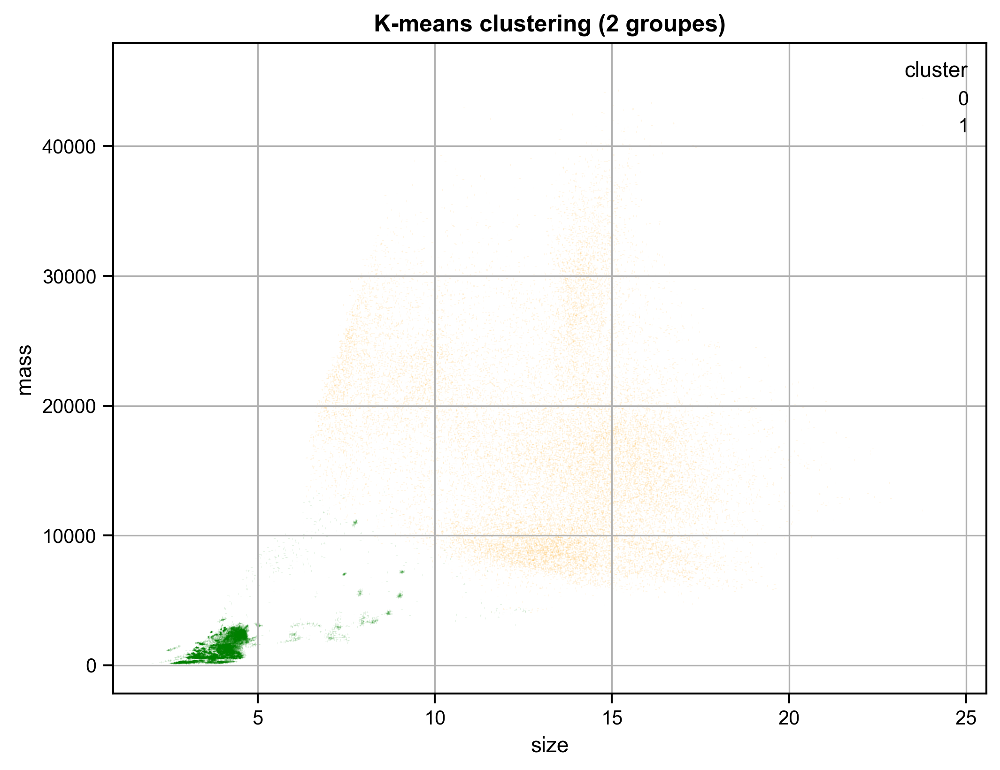

In [222]:
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans

X = DATA[['mass', 'size', 'ecc']].dropna()
X_scaled = StandardScaler().fit_transform(X)
kmeans = KMeans(n_clusters=2, random_state=0).fit(X_scaled)
DATA['cluster'] = -1
DATA.loc[X.index, 'cluster'] = kmeans.labels_

plt.figure(figsize=(8, 6))
sns.scatterplot(
    data=DATA, x='size', y='mass',
    hue='cluster', palette=['green', 'orange'],
    alpha=0.1, s=0.001, marker='+', linewidth=1.0
)
plt.title("K-means clustering (2 groupes)")
plt.grid()
plt.show()

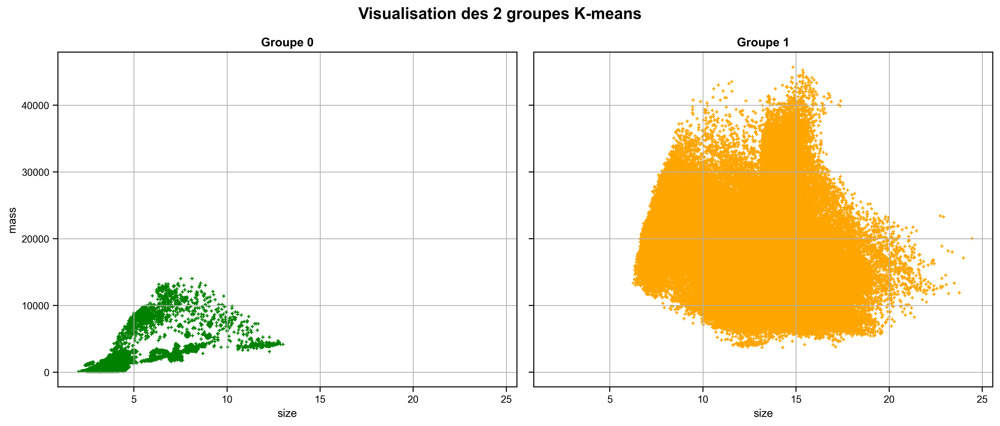

In [223]:
import matplotlib.pyplot as plt
import seaborn as sns

# Données préparées comme avant
X = DATA[['mass', 'size', 'ecc']].dropna()
X_scaled = StandardScaler().fit_transform(X)
kmeans = KMeans(n_clusters=2, random_state=0).fit(X_scaled)
DATA['cluster'] = -1
DATA.loc[X.index, 'cluster'] = kmeans.labels_

# Création des deux sous-graphes côte à côte
fig, axes = plt.subplots(1, 2, figsize=(14, 6), sharex=True, sharey=True)

for i in range(2):
    sns.scatterplot(
        data=DATA[DATA['cluster'] == i],
        x='size', y='mass',
        ax=axes[i],
        color='green' if i == 0 else 'orange',
        alpha=1, s=10, marker='+', linewidth=1
    )
    axes[i].set_title(f"Groupe {i}")
    axes[i].grid(True)

fig.suptitle("Visualisation des 2 groupes K-means", fontsize=16)
plt.tight_layout()
plt.show()

In [224]:
# Séparation des clusters en deux DataFrames
DATA_cluster0 = DATA[DATA['cluster'] == 0].copy()
DATA_cluster1 = DATA[DATA['cluster'] == 1].copy()

# negative slope 18


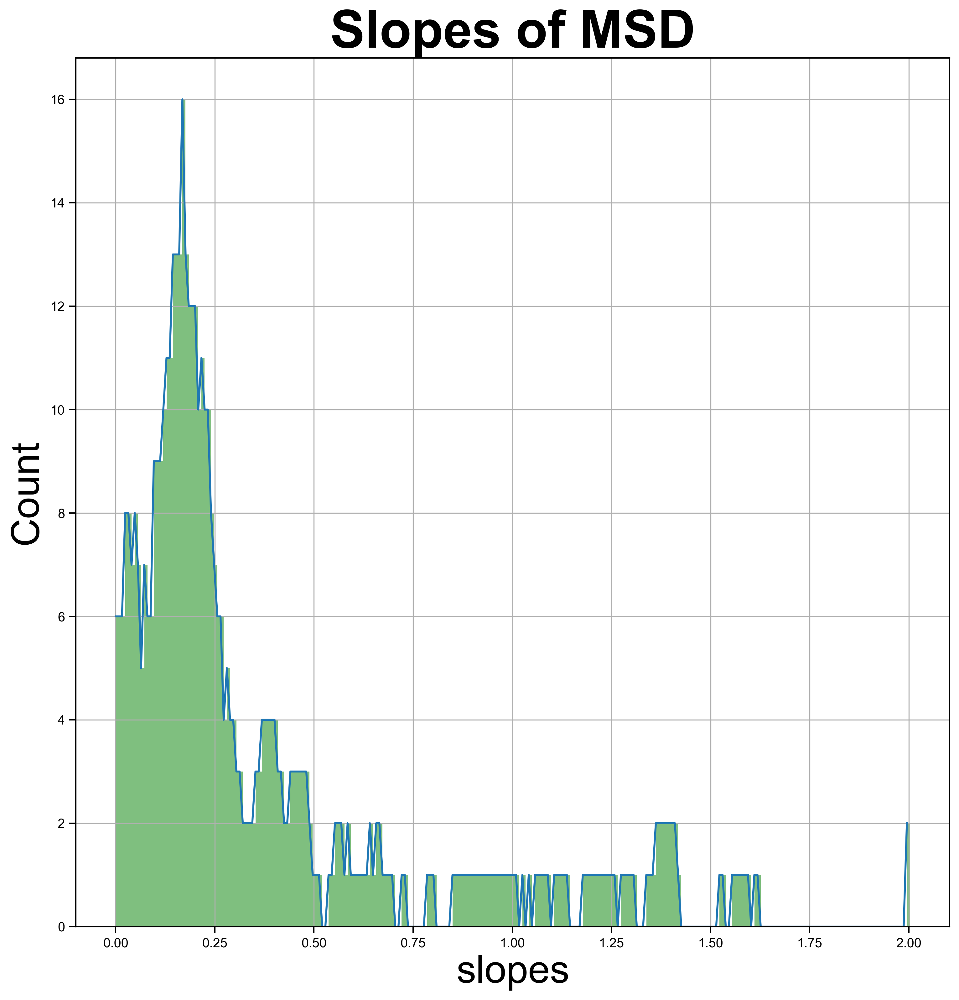

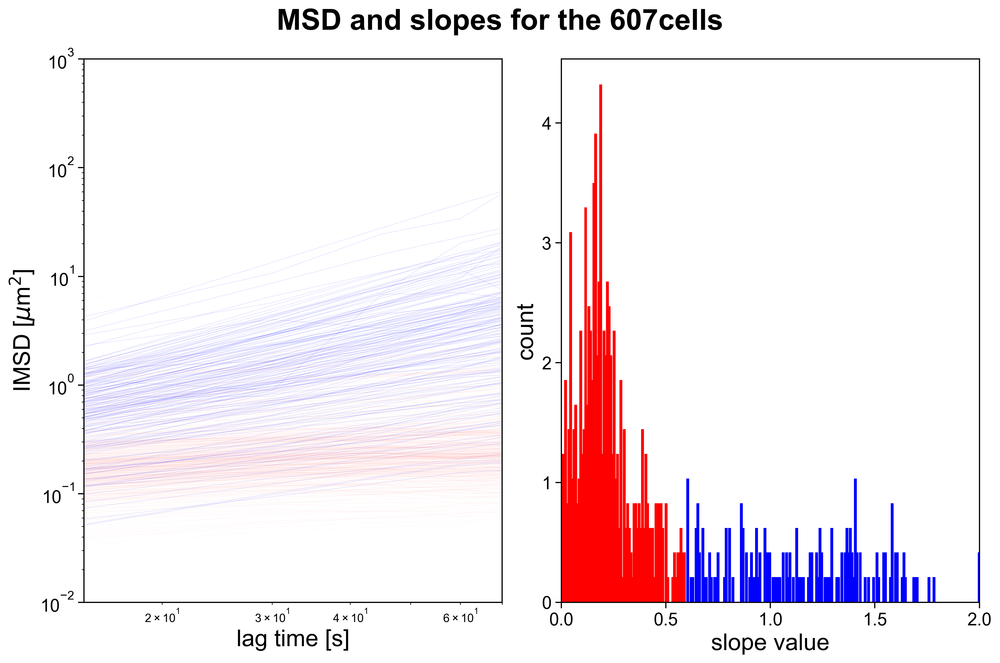

In [225]:
# Recompute trajectory clustering with new cutoff
# DATA_intermediaire = DATA.copy()
DATA_cluster0['frame'] = pd.factorize(DATA_cluster0['frame'])[0]
IMSD_cluster0 = tp.imsd(traj=DATA_cluster0, mpp=SIZE_PIX, fps=FPS, max_lagtime=200, statistic='msd')
LAG_TIME_FIT = 5
COEF_INF_cluster0, COEF_SUP_cluster0, PART_COEF_INF_cluster0, PART_COEF_SUP_cluster0, CUTOFF_cluster0 = lib.traj_clustering_with_fit_cutoff(
    DATA_cluster0, imsd=IMSD_cluster0, hist=True, lag_time_fit_start=0, lag_time_fit=LAG_TIME_FIT , micronperpixel=SIZE_PIX,
    fps=FPS, binsize=250, peak_height=50, peak_width=1, save=True, pathway_fig=path_save_pic,
    name='MSD and slopes cluster1', img_type=IMG_TYPE, plot=True, color_sup_inf=color_sup_inf,
    cutoff_default=0.6
)

# Ajouter les colonnes 'is_inf' et 'is_sup' à DATA
DATA_cluster0['particle'] = DATA_cluster0['particle'].astype(int)
PART_COEF_INF_cluster0 = set(map(int, PART_COEF_INF_cluster0))
PART_COEF_SUP_cluster0 = set(map(int, PART_COEF_SUP_cluster0))

# Ajout des colonnes 'is_inf' et 'is_sup'
DATA_cluster0['is_inf'] = DATA_cluster0['particle'].isin(PART_COEF_INF_cluster0).astype(int)
DATA_cluster0['is_sup'] = DATA_cluster0['particle'].isin(PART_COEF_SUP_cluster0).astype(int)


# negative slope 0


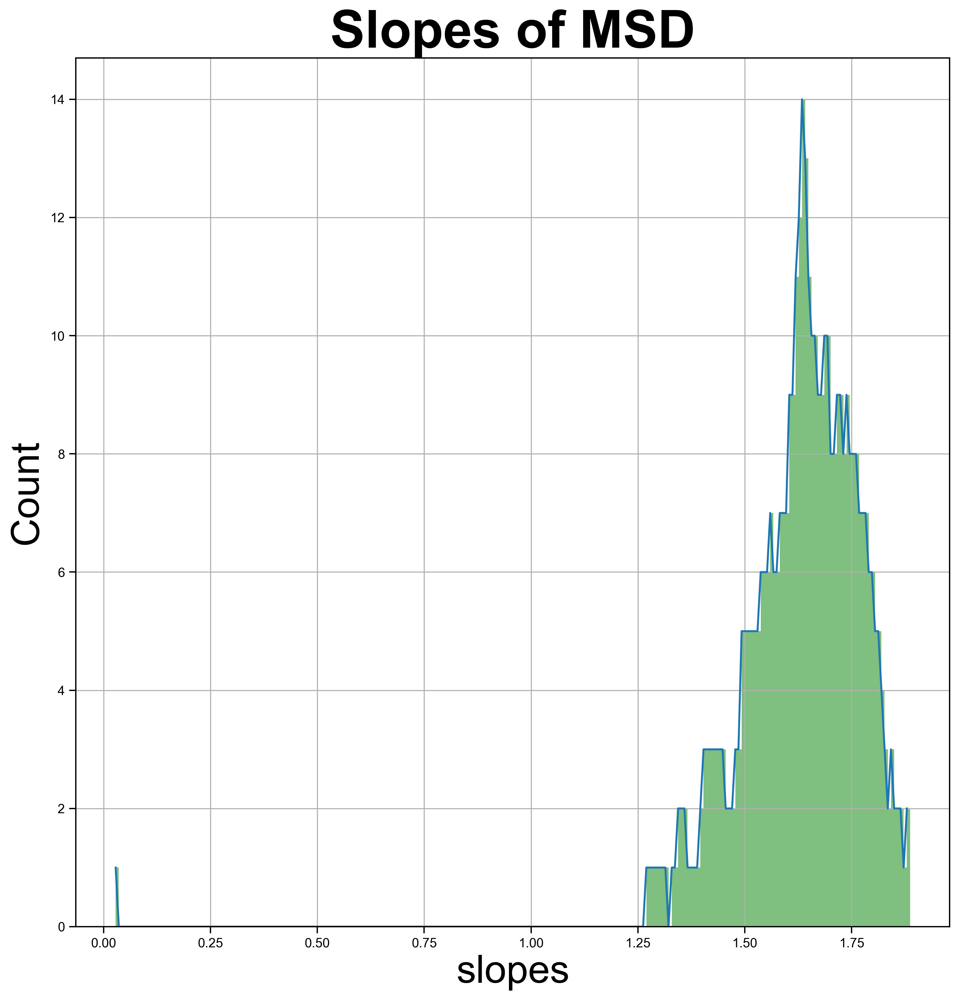

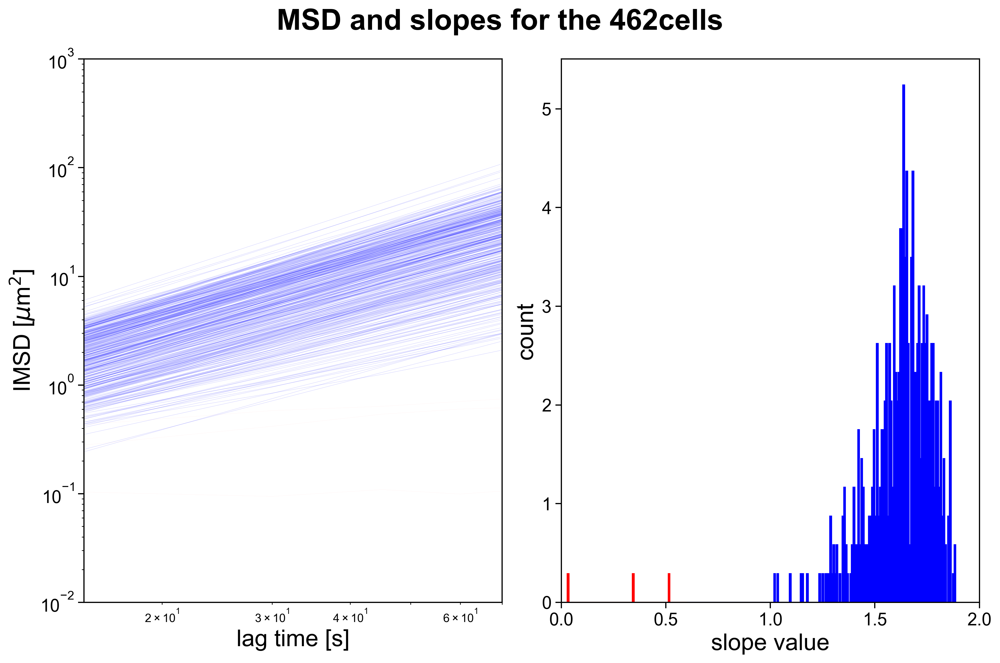

In [226]:
# Recompute trajectory clustering with new cutoff
# DATA_intermediaire = DATA.copy()
DATA_cluster1['frame'] = pd.factorize(DATA_cluster1['frame'])[0]
IMSD_cluster1 = tp.imsd(traj=DATA_cluster1, mpp=SIZE_PIX, fps=FPS, max_lagtime=200, statistic='msd')
LAG_TIME_FIT = 5
COEF_INF_cluster1, COEF_SUP_cluster1, PART_COEF_INF_cluster1, PART_COEF_SUP_cluster1, CUTOFF_cluster1 = lib.traj_clustering_with_fit_cutoff(
    DATA_cluster1, imsd=IMSD_cluster1, hist=True, lag_time_fit_start=0, lag_time_fit=LAG_TIME_FIT , micronperpixel=SIZE_PIX,
    fps=FPS, binsize=250, peak_height=50, peak_width=1, save=True, pathway_fig=path_save_pic,
    name='MSD and slopes cluster2', img_type=IMG_TYPE, plot=True, color_sup_inf=color_sup_inf,
    cutoff_default=0.6
)
# Ajouter les colonnes 'is_inf' et 'is_sup' à DATA
DATA_cluster1['particle'] = DATA_cluster1['particle'].astype(int)
PART_COEF_INF_cluster1 = set(map(int, PART_COEF_INF_cluster1))
PART_COEF_SUP_cluster1 = set(map(int, PART_COEF_SUP_cluster1))
# Ajout des colonnes 'is_inf' et 'is_sup'
DATA_cluster1['is_inf'] = DATA_cluster1['particle'].isin(PART_COEF_INF_cluster1).astype(int)
DATA_cluster1['is_sup'] = DATA_cluster1['particle'].isin(PART_COEF_SUP_cluster1).astype(int)



In [227]:
# for experiment in data_unique_pos['experiment'].unique():
#     # Sous-ensemble pour cette expérience
#     sub_df = data_unique_pos[data_unique_pos['experiment'] == experiment].copy()

#     # Filtrage spatial : éliminer particules trop proches
#     coords = sub_df[['x', 'y']].to_numpy()
#     if len(coords) > 1:
#         nbrs = NearestNeighbors(n_neighbors=2).fit(coords)
#         distances, _ = nbrs.kneighbors(coords)
#         keep_mask = distances[:, 1] > min_distance
#         sub_df = sub_df[keep_mask].copy()

#     # Recherche du dossier correspondant à l'expérience
#     experiment_dirs = glob.glob(os.path.join(base_image_dir, f"*{experiment}*"))
#     if not experiment_dirs:
#         print(f"Dossier pour {experiment} non trouvé !")
#         continue
#     experiment_dir = experiment_dirs[0]

#     # Chargement de l'image frame 0
#     img_path = os.path.join(experiment_dir, "mosaic/mosaic_total_0.tif")
#     if not os.path.isfile(img_path):
#         print(f"Image {img_path} non trouvée !")
#         continue

#     img = cv2.imread(img_path)
#     if img is None:
#         print(f"Image {img_path} illisible !")
#         continue

#     # Tracer les cercles
#     for _, row in sub_df.iterrows():
#         x = int(round(row["x"]))
#         y = int(round(row["y"]))
#         cv2.circle(img, (x, y), 50, (0, 0, 255), 3)

#     # Sauvegarde
#     out_path = os.path.join(output_dir, f"{experiment}_mosaic_total_0_inf_filtered.png")
#     cv2.imwrite(out_path, img)
#     print(f"Image annotée sauvegardée : {out_path}")

In [228]:
import os
import glob
import cv2
import numpy as np
import pandas as pd
from sklearn.neighbors import NearestNeighbors

# === PARAMÈTRES ===
base_image_dir = "/Users/souchaud/Desktop/A_analyser/CytoOne_HL5_10x_faits/"
output_dir = "/Users/souchaud/Desktop/faibles/"
min_distance = 10  # en pixels
os.makedirs(output_dir, exist_ok=True)

# === 1. Extraire particules du cluster 1, faibles ===
data_inf = DATA[(DATA['cluster'] == 1) & (DATA['is_inf'] == 1)].copy()

# === 2. Trouver la première frame de chaque particule ===
first_frame_df = data_inf.sort_values('frame').groupby('particle', as_index=False).first()
first_frame_df['start_frame'] = first_frame_df['frame']  # juste pour clarté

# === 3. Filtrage spatial dans chaque frame de début ===
filtered_particles = []

for f in first_frame_df['start_frame'].unique():
    same_frame = first_frame_df[first_frame_df['start_frame'] == f].copy()
    
    if len(same_frame) <= 1:
        filtered_particles.append(same_frame)
        continue

    coords = same_frame[['x', 'y']].to_numpy()
    nbrs = NearestNeighbors(n_neighbors=2).fit(coords)
    distances, _ = nbrs.kneighbors(coords)
    keep_mask = distances[:, 1] > min_distance
    filtered_particles.append(same_frame[keep_mask])

# === 4. Particules uniques à annoter ===
final_df = pd.concat(filtered_particles, ignore_index=True)

# === 5. Génération des images par expérience ===
for experiment in final_df['experiment'].unique():
    sub_df = final_df[final_df['experiment'] == experiment].copy()

    # Localise le dossier de l’expérience
    experiment_dirs = glob.glob(os.path.join(base_image_dir, f"*{experiment}*"))
    if not experiment_dirs:
        print(f"Dossier pour {experiment} non trouvé !")
        continue
    experiment_dir = experiment_dirs[0]

    # Charge l'image frame 0
    img_path = os.path.join(experiment_dir, "mosaic/mosaic_total_0.tif")
    if not os.path.isfile(img_path):
        print(f"Image {img_path} non trouvée !")
        continue

    img = cv2.imread(img_path)
    if img is None:
        print(f"Image {img_path} illisible !")
        continue

    # Trace les cercles
    for _, row in sub_df.iterrows():
        x = int(round(row["x"]))
        y = int(round(row["y"]))
        cv2.circle(img, (x, y), 50, (0, 0, 255), 3)

    # Sauvegarde
    out_path = os.path.join(output_dir, f"{experiment}_mosaic_total_0_inf_filtered.png")
    cv2.imwrite(out_path, img)
    print(f"Image annotée sauvegardée : {out_path}")

Image annotée sauvegardée : /Users/souchaud/Desktop/faibles/ASMOT119_mosaic_total_0_inf_filtered.png
Image annotée sauvegardée : /Users/souchaud/Desktop/faibles/ASMOT117_mosaic_total_0_inf_filtered.png
Image annotée sauvegardée : /Users/souchaud/Desktop/faibles/ASMOT110_mosaic_total_0_inf_filtered.png
Image annotée sauvegardée : /Users/souchaud/Desktop/faibles/ASMOT118_mosaic_total_0_inf_filtered.png


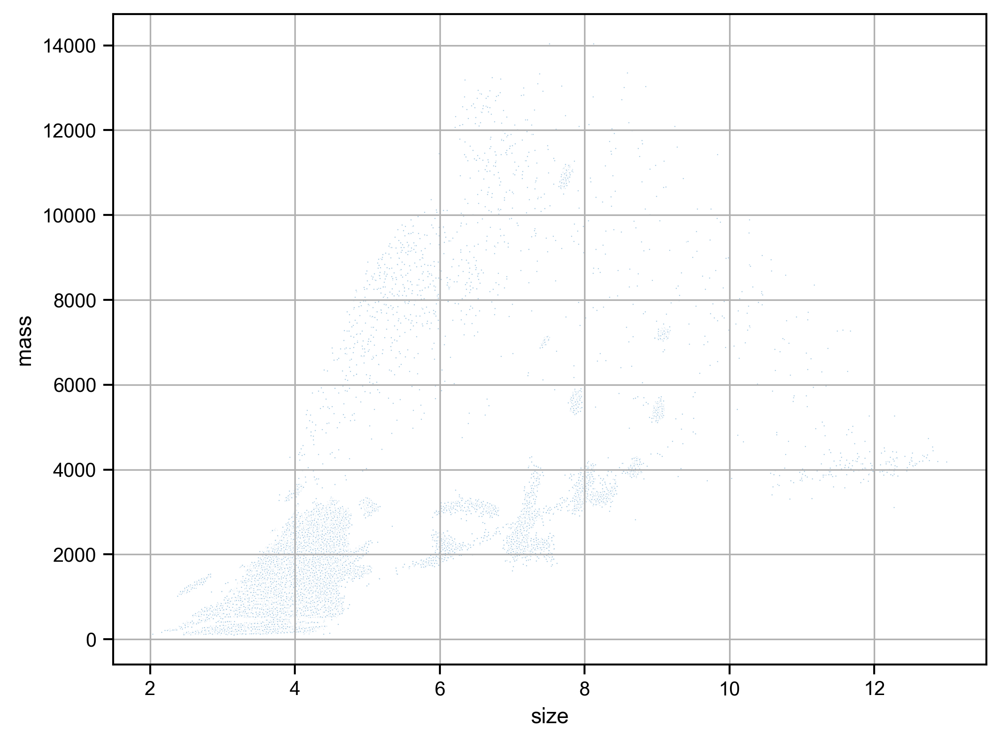

In [229]:
plt.figure(figsize=(8, 6))
sns.scatterplot(
    data=DATA_cluster0, x='size', y='mass',
    alpha=0.7, s=2, marker='.', linewidth=1.0
)
plt.grid()
plt.show()

In [230]:
# On prend le cluster majoritaire par particule
df_particles = DATA.groupby('particle')['cluster'].agg(lambda x: x.value_counts().index[0]).reset_index()

# On compte le nombre de particules annotées 0 en cluster
n_particles_cluster0 = (df_particles['cluster'] == 1).sum()

print(f"Nombre de particules annotées cluster 0 : {n_particles_cluster0}")

Nombre de particules annotées cluster 0 : 461


In [231]:
# Pour chaque particule, associer le cluster majoritaire, et la classe annotée (is_sup, is_inf)
df_comp = DATA.groupby('particle').agg({
    'cluster': lambda x: x.value_counts().index[0],  # cluster le plus fréquent
    'is_sup': 'first',    # ou 'any' si tu as de rares cellules mixtes
    'is_inf': 'first'
}).reset_index()

In [232]:
# Exemple : correspondance cluster <-> is_sup
# (on suppose cluster 1 doit matcher is_sup=True, à vérifier selon ton contexte)
correspondance_sup = df_comp[df_comp['cluster'] == 0]['is_sup'].mean()
correspondance_inf = df_comp[df_comp['cluster'] == 1]['is_inf'].mean()

print(f"Taux de cellules du cluster 1 annotées SUP : {correspondance_sup:.2%}")
print(f"Taux de cellules du cluster 0 annotées INF : {correspondance_inf:.2%}")

Taux de cellules du cluster 1 annotées SUP : 24.66%
Taux de cellules du cluster 0 annotées INF : 0.43%


In [233]:
print((DATA.groupby('particle')['is_inf'].first() == 1).sum())
print((DATA.groupby('particle')['is_sup'].first() == 1).sum())
print((DATA.groupby('particle')['cluster'].first()== 1).sum())
print((DATA.groupby('particle')['cluster'].first()== 0).sum())

442
603
453
592


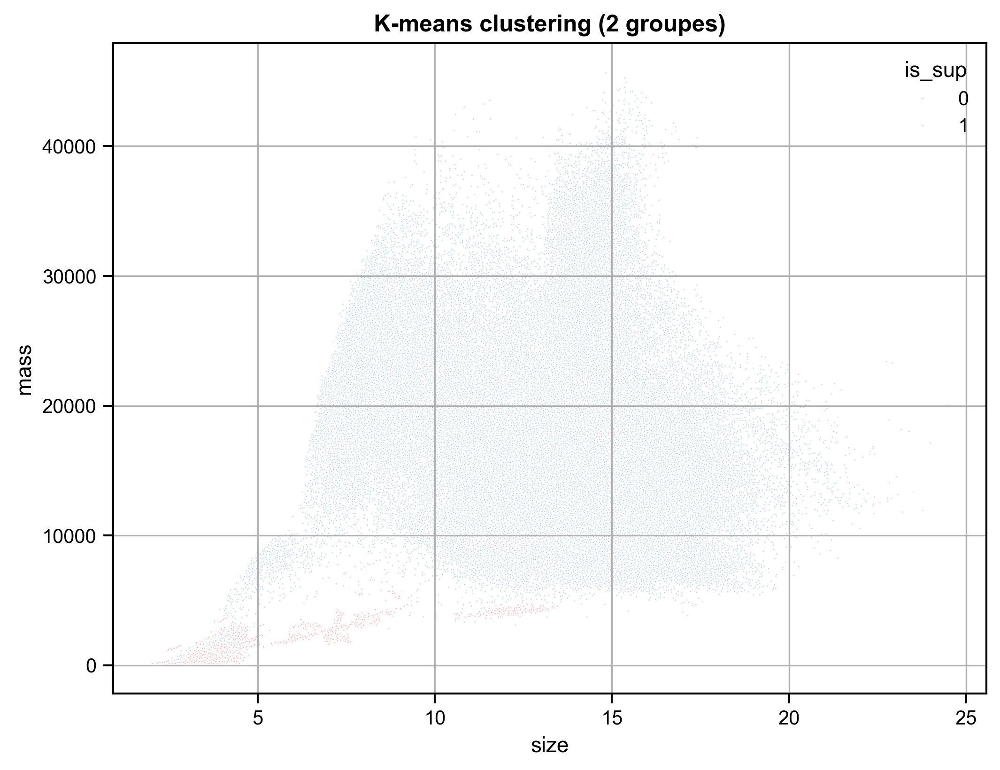

In [234]:
plt.figure(figsize=(8, 6))
sns.scatterplot(
    data=DATA, x='size', y='mass',
    hue='is_sup', palette='Set1',
    alpha=0.7, s=2, marker='.', linewidth=1.0
)
plt.title("K-means clustering (2 groupes)")
plt.grid()
plt.show()

In [235]:
import pandas as pd

# Pour is_sup (ex : cluster 1 = SUP, cluster 0 = INF)
confmat = pd.crosstab(df_comp['cluster'], df_comp['is_sup'], rownames=['Cluster'], colnames=['is_sup'])
print(confmat)

is_sup     0    1
Cluster          
0        440  144
1          2  459


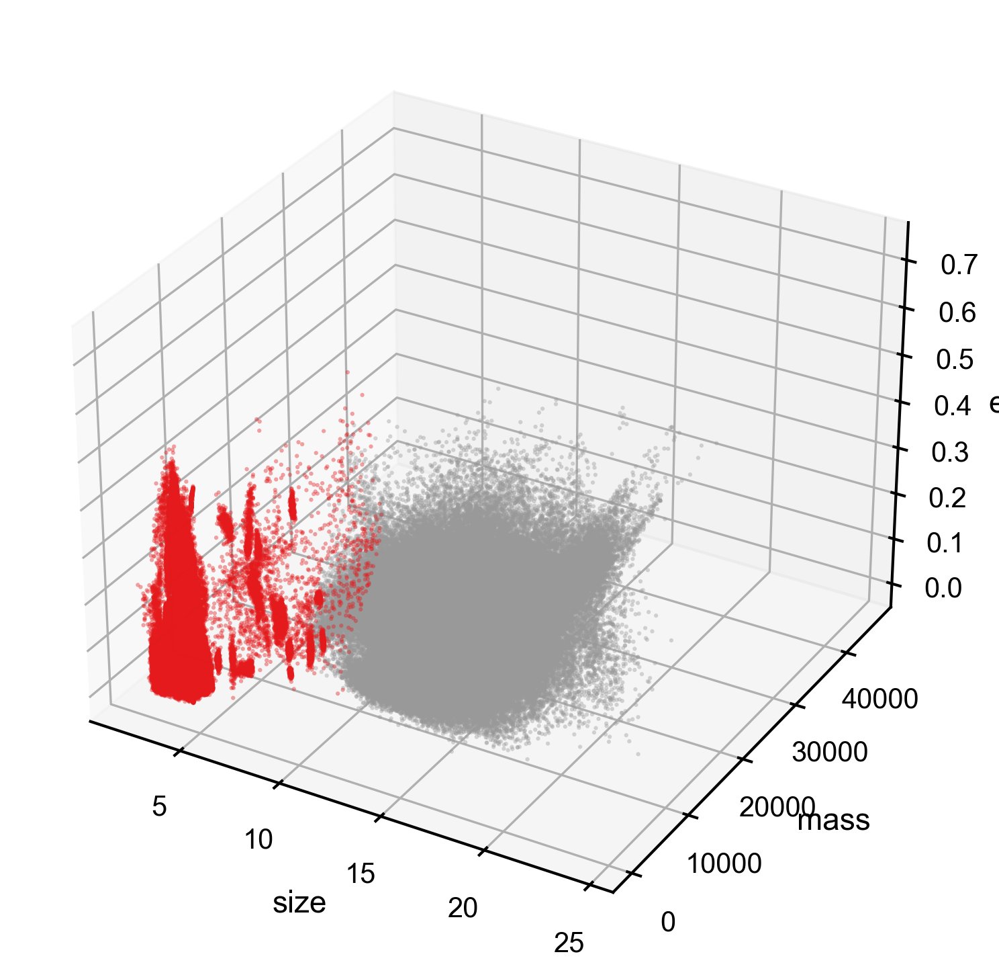

In [236]:
from mpl_toolkits.mplot3d import Axes3D
fig = plt.figure(figsize=(8,6))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(DATA['size'], DATA['mass'], DATA['ecc'], c=DATA['cluster'], cmap='Set1', alpha=0.4, marker='.', s=1)
ax.set_xlabel('size')
ax.set_ylabel('mass')
ax.set_zlabel('ecc')
plt.show()

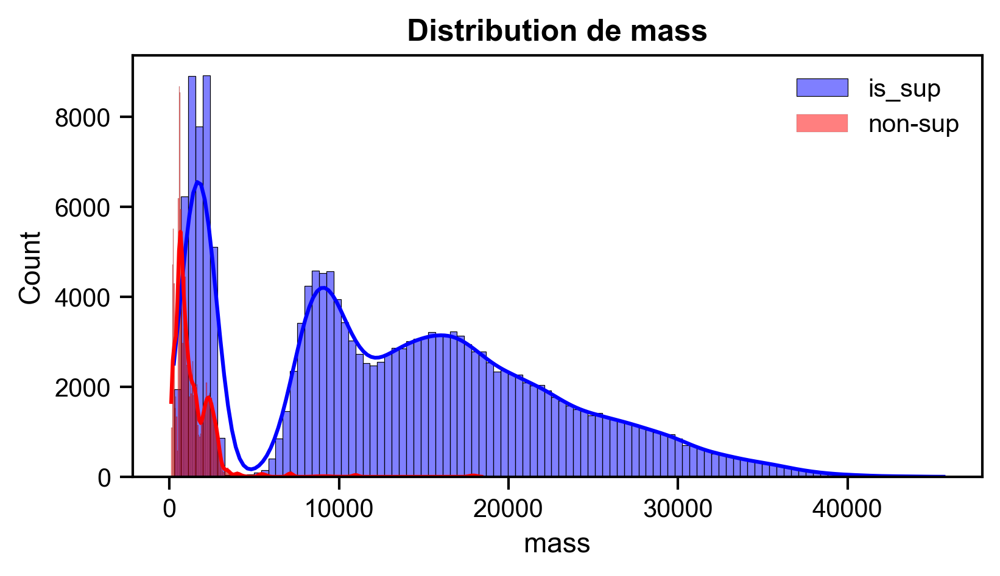

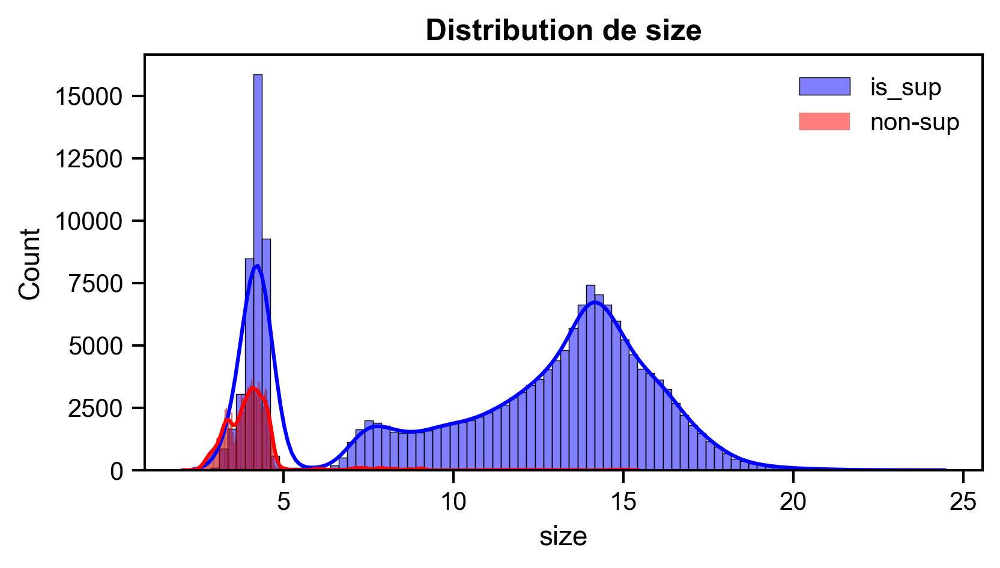

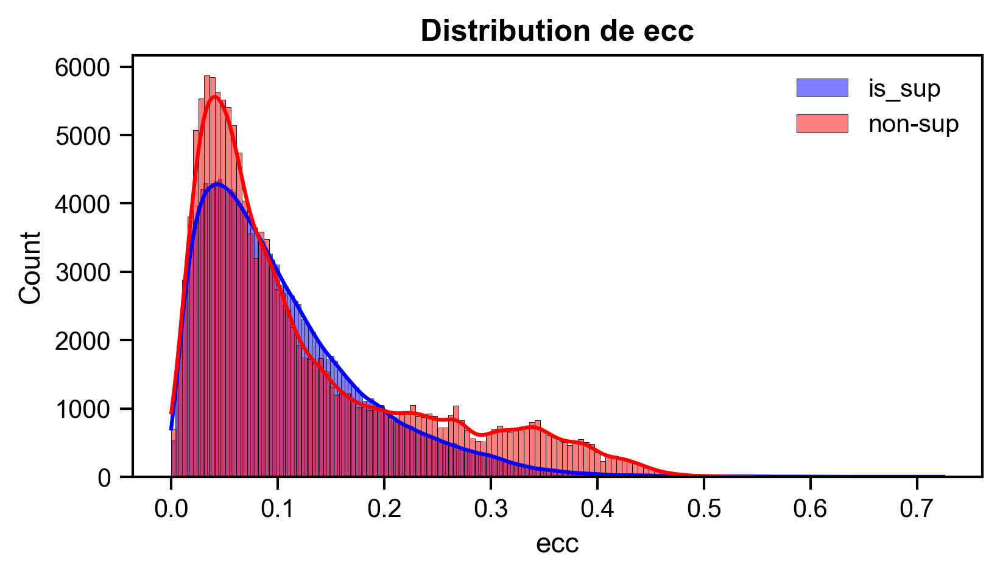

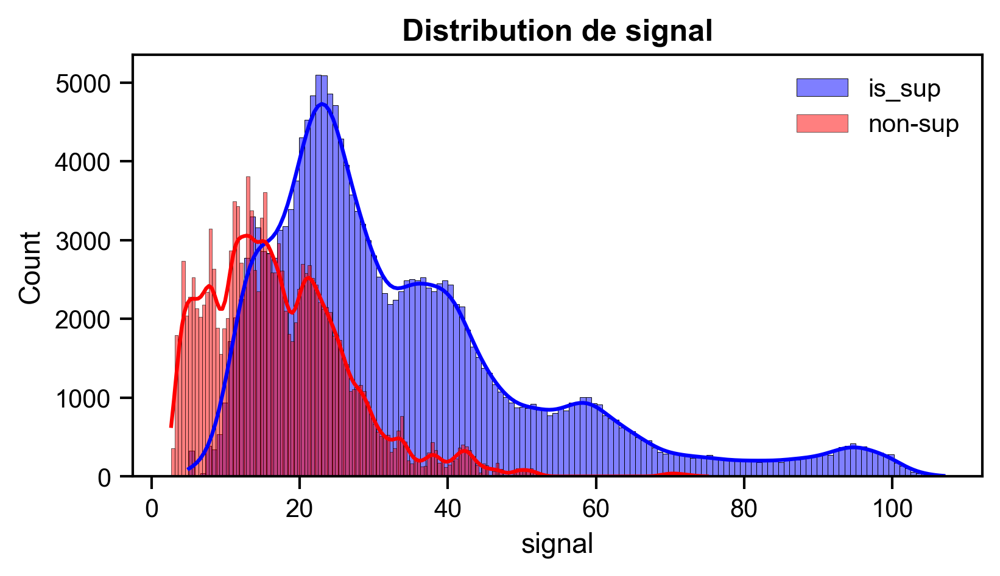

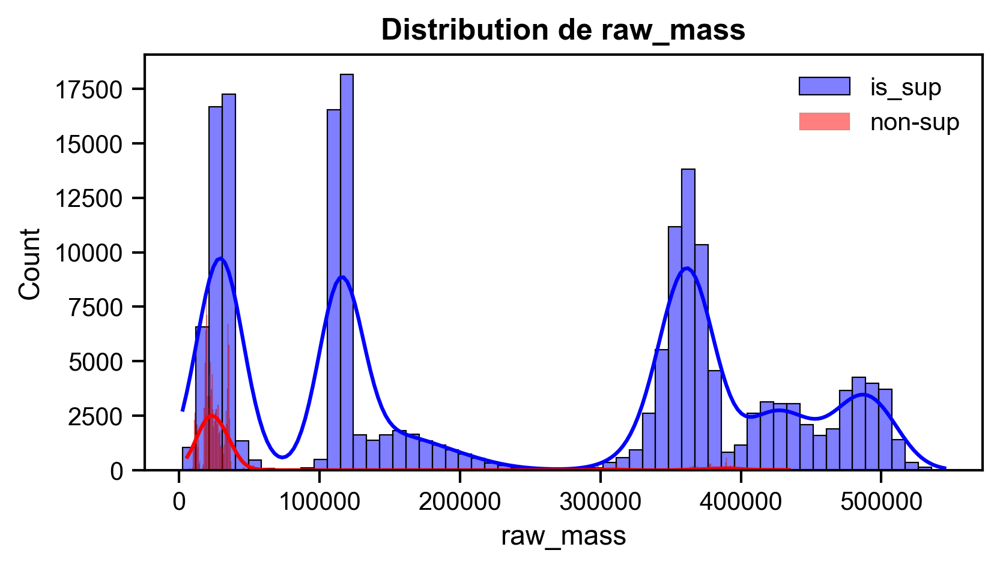

In [237]:
for feat in ['mass', 'size', 'ecc', 'signal', 'raw_mass']:
    plt.figure(figsize=(6,3))
    sns.histplot(DATA[feat][DATA['is_sup']==True], color='blue', alpha=0.5, label='is_sup', kde=True)
    sns.histplot(DATA[feat][DATA['is_sup']==False], color='red', alpha=0.5, label='non-sup', kde=True)
    plt.title(f"Distribution de {feat}")
    plt.legend()
    plt.show()

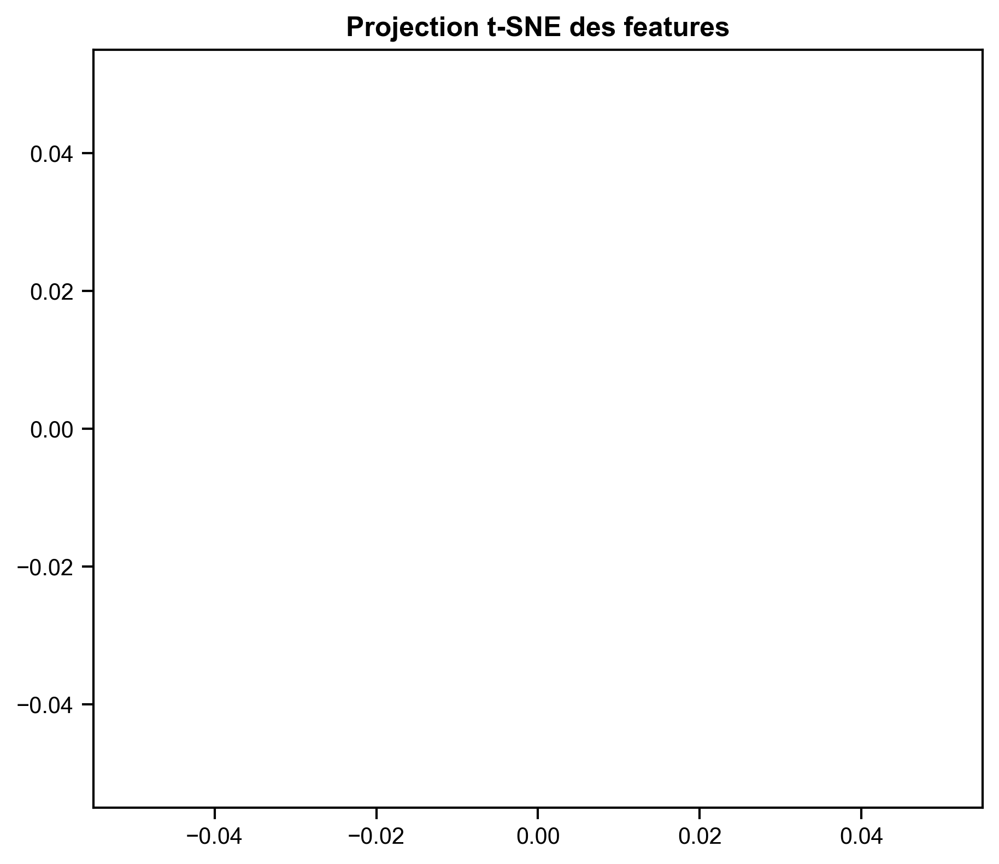

In [238]:
from sklearn.manifold import TSNE

X = DATA[['mass', 'size', 'ecc', 'signal', 'raw_mass']].fillna(0)
X_scaled = StandardScaler().fit_transform(X)
tsne = TSNE(n_components=2, random_state=42).fit_transform(X_scaled)

plt.figure(figsize=(7,6))
plt.scatter(tsne[:,0], tsne[:,1], c=DATA['is_sup'].map({True:'blue', False:'red'}), alpha=0.5, s=10)
plt.title('Projection t-SNE des features')
plt.show()